# Exective summary of Work Package 3

## Objectives

In this WP, you will work on a given training dataset. Your goal is to develop a fault detection model using the regression algorithms learnt in the class, in order to achieve best F1 score。

## Tasks

- Task 1: Develop a regression model to predict the reference value for motor temperature.
- Task 2: Develop a fault detection model using the regression model you developed in Task 1.

## Delierables

- A Jupyter notebook reporting the process and results of the above tasks


# Before starting, please:
- Fetch the most up-to-date version of the github repository.
- Create a new branch with your name, based on the "main" branch and switch to your own branch.
- Copy this notebook to the work space of your group, and rename it to TD_WP_3_Your name.ipynb
- After finishing this task, push your changes to the github repository of your group.

# Task 1: Predict normal behaviors through regression models

In this task, let us try to develop a best regression model to predict the normal behaviors of a given motor. In this exercise, we can use motor 6 as an example. You can easilily generate the approach to other models for the data challenge.

We can use all the dataset where motor 6 works normally as our dataset. Then, we can run a cross validation (based on sequence, not points) to test the performances of the developed model.

In this example, we mainly use the following performance metrics:
- max error: The max error between the predicted and the true values.
- Mean root squared error: The mean root squared error between the predicted and the true values.
- Out-of-boundary rate: The percentage that the residual error between the predicted and the true values is larger than a given threshold. Here, we set the thresold to be $3$ degree.

## Sub-task 1: Only use the features at the current moment.

[This notebook](demo_regression_mdl.ipynb) provides a basic demonstration of how to set up the experiment. Let us start by considering only using the features from the current moment. In the notebook, we show a baseline using a simple linear regression with all the features. Could you please try to improve the performance of the model?

A few possible directions:
- Feature selection?
- Smoothing?
- Removing sequence-to-sequence variablity? Adding features regarding time dynamics (see the TD for last lecture).
- Changing to other regression models? For this, you can try different regression models from [here](https://scikit-learn.org/stable/supervised_learning.html)

Put your code below.

In [22]:
from utility import read_all_test_data_from_path
import numpy as np
import pandas as pd


def pre_processing(df: pd.DataFrame):
    ''' # Description
    Remove outliers from the dataframe based on defined valid ranges. 
    Define a valid range of temperature and voltage. 
    Use ffil function to replace the invalid measurement with the previous value.
    '''
    df['temperature'] = df['temperature'].where(df['temperature'] <= 100, np.nan)
    df['temperature'] = df['temperature'].where(df['temperature'] >= 0, np.nan)
    df['temperature'] = df['temperature'].ffill()

    df['voltage'] = df['voltage'].where(df['voltage'] >= 6000, np.nan)
    df['voltage'] = df['voltage'].where(df['voltage'] <= 9000, np.nan)
    df['voltage'] = df['voltage'].ffill()

    df['position'] = df['position'].where(df['position'] >= 0, np.nan)
    df['position'] = df['position'].where(df['position'] <= 1000, np.nan)
    df['position'] = df['position'].ffill()


base_dictionary = '../../dataset/training_data/'
df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

In [23]:
import pandas as pd
import numpy as np
from scipy.signal import butter, filtfilt


# Function to design a Butterworth low-pass filter
def butter_lowpass(cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a


# Function to apply the Butterworth low-pass filter
def lowpass_filter(data, cutoff_freq, sampling_freq, order=5):
    b, a = butter_lowpass(cutoff_freq, sampling_freq, order=order)
    filtered_data = filtfilt(b, a, data)
    return filtered_data


# Set parameters for the low-pass filter
cutoff_frequency = .5  # Adjust as needed
sampling_frequency = 10  # Assuming your data is evenly spaced in time


def customized_outlier_removal(df: pd.DataFrame):
    ''' # Description
    Remove outliers from the dataframe based on defined valid ranges. 
    Define a valid range of temperature and voltage. 
    Use ffil function to replace the invalid measurement with the previous value.
    '''
    df['position'] = df['position'].where(df['position'] <= 1000, np.nan)
    df['position'] = df['position'].where(df['position'] >= 0, np.nan)
    df['position'] = df['position'].ffill()
    df['position'] = lowpass_filter(df['position'], cutoff_frequency, sampling_frequency)
    # df['position'] = df['position'].rolling(window=10, min_periods=1).mean()
    df['position'] = df['position'].round()

    df['temperature'] = df['temperature'].where(df['temperature'] <= 100, np.nan)
    df['temperature'] = df['temperature'].where(df['temperature'] >= 0, np.nan)
    # df['temperature'] = df['temperature'].rolling(window=10, min_periods=1).mean()

    # Make sure that the difference between the current and previous temperature cannot be too large.
    # Define your threshold
    threshold = 10
    # Shift the 'temperature' column by one row to get the previous temperature
    prev_tmp = df['temperature'].shift(1)
    # Calculate the absolute difference between current and previous temperature
    temp_diff = np.abs(df['temperature'] - prev_tmp)
    # Set the temperature to NaN where the difference is larger than the threshold
    df.loc[temp_diff > threshold, 'temperature'] = np.nan
    df['temperature'] = df['temperature'].ffill()

    df['voltage'] = df['voltage'].where(df['voltage'] >= 6000, np.nan)
    df['voltage'] = df['voltage'].where(df['voltage'] <= 8000, np.nan)
    df['voltage'] = df['voltage'].ffill()
    # df['voltage'] = lowpass_filter(df['voltage'], cutoff_frequency, sampling_frequency)
    # df['voltage'] = df['voltage'].rolling(window=5, min_periods=1).mean()
    

from utility import read_all_csvs_one_test
import matplotlib.pyplot as plt
import pandas as pd
import os

# Get all the folders in the base_dictionary
path_list = os.listdir(base_dictionary)
# Only keep the folders, not the excel file.
# print(path_list)
path_list = [file for file in path_list if not file.endswith(".xlsx")]

# Read the data.
df_data_smoothing = pd.DataFrame()
for tmp_path in path_list:
    path = base_dictionary + tmp_path
    # Read the data with the customized outlier removal function.
    tmp_df = read_all_csvs_one_test(path, tmp_path, customized_outlier_removal)
    df_data_smoothing = pd.concat([df_data_smoothing, tmp_df])
    df_data_smoothing = df_data_smoothing.reset_index(drop=True)

# Read the test conditions
df_test_conditions = pd.read_excel(base_dictionary+'Test conditions.xlsx')


In [24]:
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']
df_data = df_data[df_data['test_condition'].isin(normal_test_id)]
df_data_smoothing = df_data_smoothing[df_data_smoothing['test_condition'].isin(normal_test_id)]


In [25]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', LinearRegression())    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)

Model for motor 6:

 New run:

training performance, max error is: 8.626677004715916
training performance, mean root square error is: 1.8314723398377528
training performance, residual error > 1: 54.15860735009671%

 New run:

testing performance, max error is: 14.20986436021255
testing performance, mean root square error is: 6.503248647233331
testing performance, residual error > 1: 81.8774844562226%


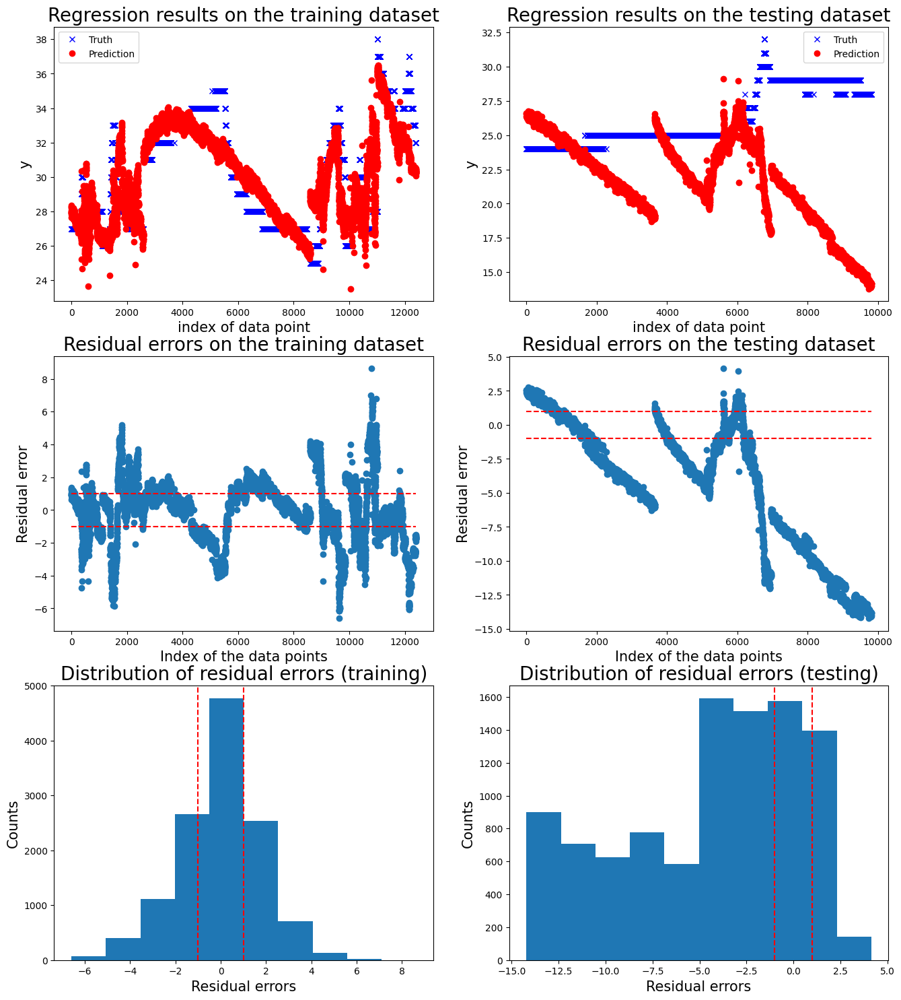


 New run:

training performance, max error is: 9.458808087158616
training performance, mean root square error is: 1.8481465739226082
training performance, residual error > 1: 64.2623572342543%

 New run:

testing performance, max error is: 14.916204534630099
testing performance, mean root square error is: 5.523604893885927
testing performance, residual error > 1: 99.55277280858677%


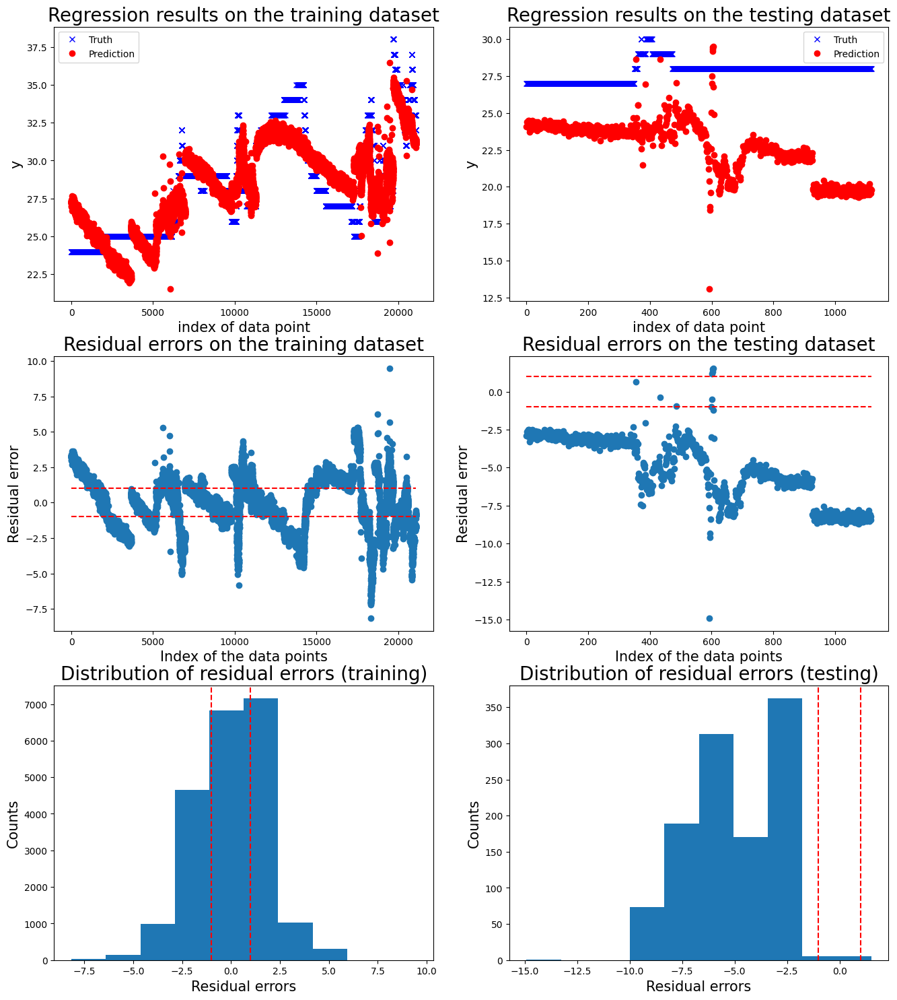


 New run:

training performance, max error is: 7.179838125988923
training performance, mean root square error is: 1.3962605079065813
training performance, residual error > 1: 27.643482129615897%

 New run:

testing performance, max error is: 8.129535141505038
testing performance, mean root square error is: 4.227287775794865
testing performance, residual error > 1: 63.23142104660483%


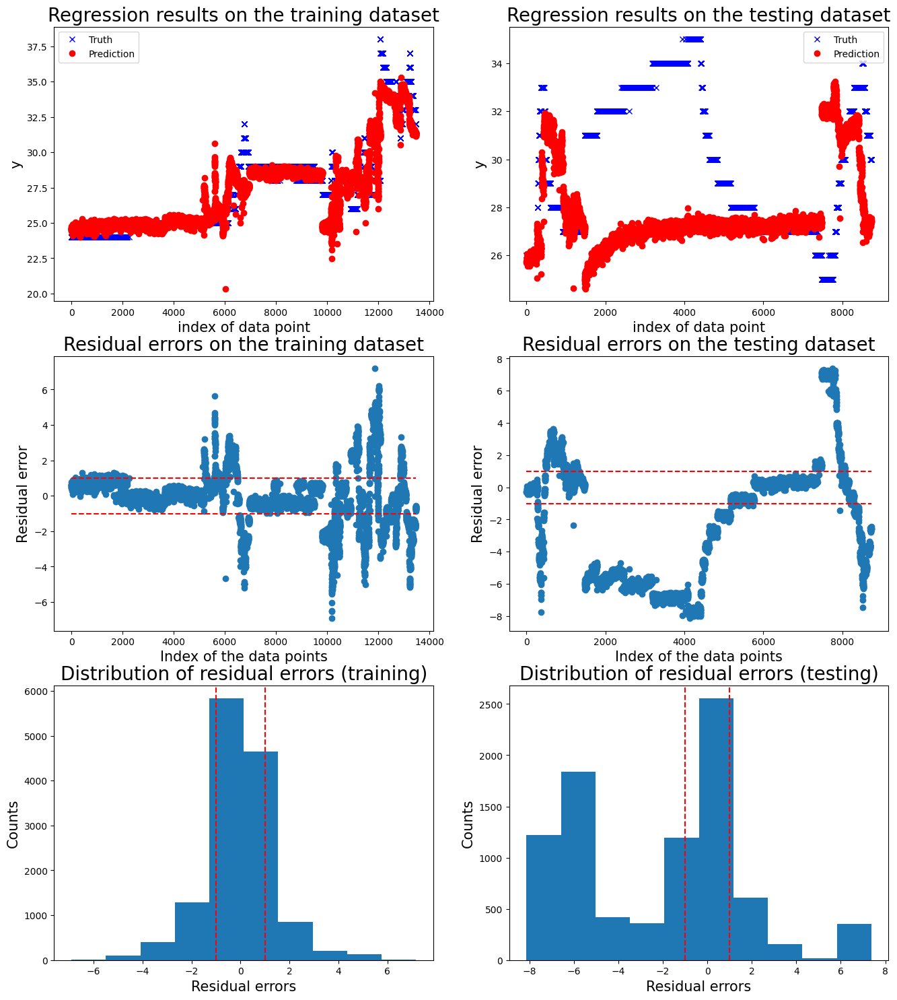


 New run:

training performance, max error is: 10.231472761353082
training performance, mean root square error is: 1.821861814828333
training performance, residual error > 1: 63.29208498715854%

 New run:

testing performance, max error is: 11.18646081267736
testing performance, mean root square error is: 5.163097546803083
testing performance, residual error > 1: 83.83084577114428%


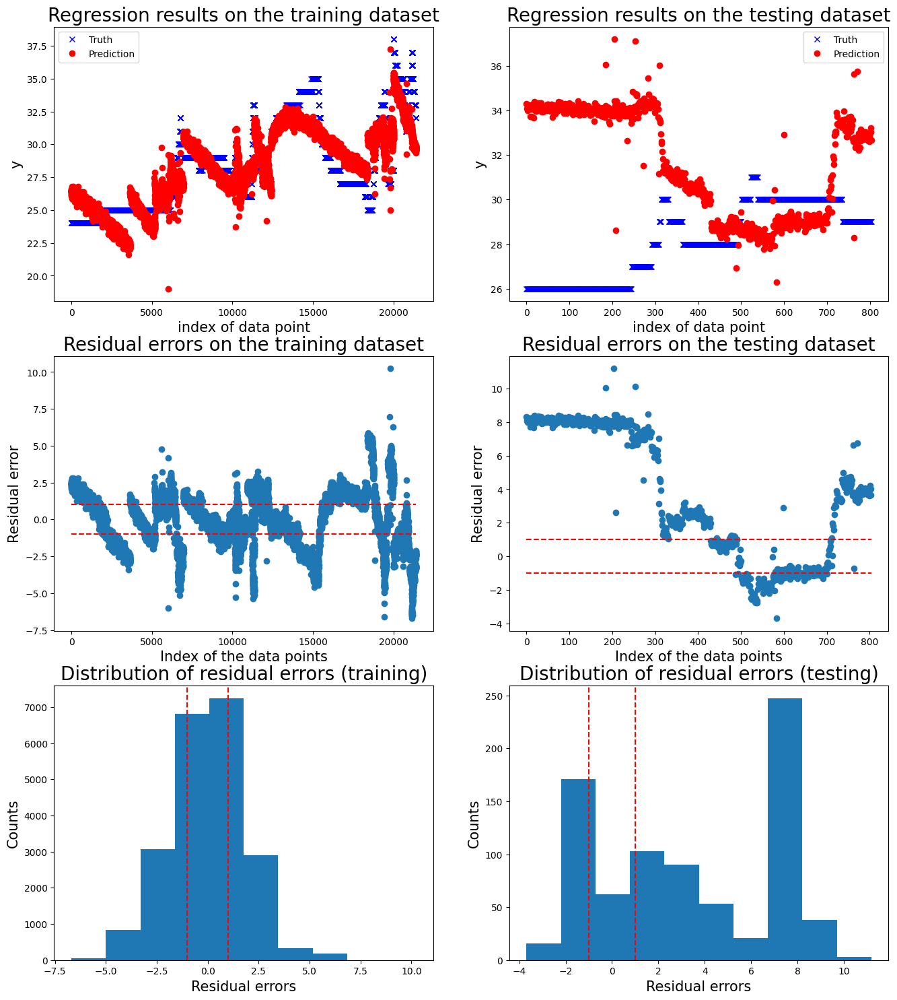


 New run:

training performance, max error is: 8.434280587100574
training performance, mean root square error is: 1.7891514892411866
training performance, residual error > 1: 60.124108277142575%

 New run:

testing performance, max error is: 9.631485791126963
testing performance, mean root square error is: 5.17513678389432
testing performance, residual error > 1: 87.73531089560753%


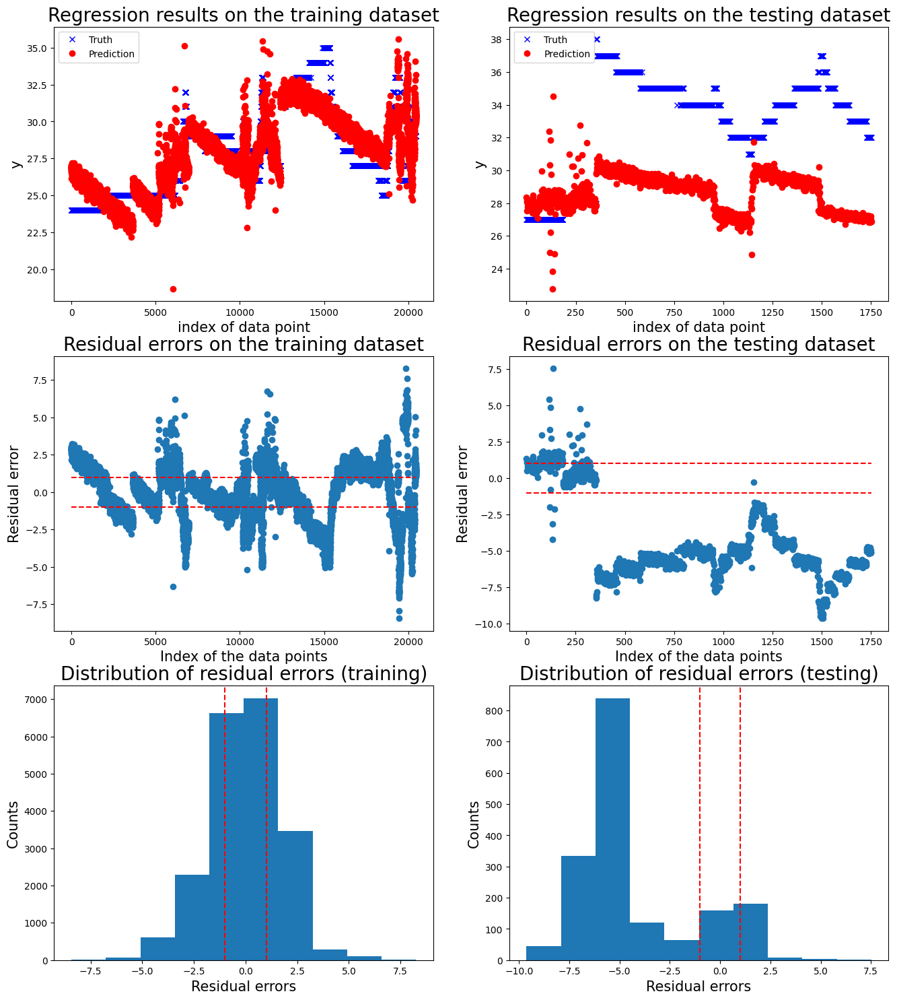

   Max error      RMSE  Exceed boundary rate
0  14.209864  6.503249              0.818775
1  14.916205  5.523605              0.995528
2   8.129535  4.227288              0.632314
3  11.186461  5.163098              0.838308
4   9.631486  5.175137              0.877353


Mean performance metric and standard error:
Max error: 11.6147 +- 2.9111
RMSE: 5.3185 +- 0.8187
Exceed boundary rate: 0.8325 +- 0.1312




In [6]:
from utility import run_cv_one_motor

feature_list_all = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 'data_motor_1_voltage',
                    'data_motor_2_position', 'data_motor_2_temperature', 'data_motor_2_voltage',
                    'data_motor_3_position', 'data_motor_3_temperature', 'data_motor_3_voltage',
                    'data_motor_4_position', 'data_motor_4_temperature', 'data_motor_4_voltage',
                    'data_motor_5_position', 'data_motor_5_temperature', 'data_motor_5_voltage',
                    'data_motor_6_position', 'data_motor_6_temperature', 'data_motor_6_voltage']

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data, mdl=mdl_linear_regreession, 
            feature_list=feature_list_all, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

### linear regression with data smoothing 

Model for motor 6:

 New run:

training performance, max error is: 9.262523351508124
training performance, mean root square error is: 1.780009829712086
training performance, residual error > 1: 56.13687947389862%

 New run:

testing performance, max error is: 7.903769566628068
testing performance, mean root square error is: 2.664736138226085
testing performance, residual error > 1: 70.39316918189039%


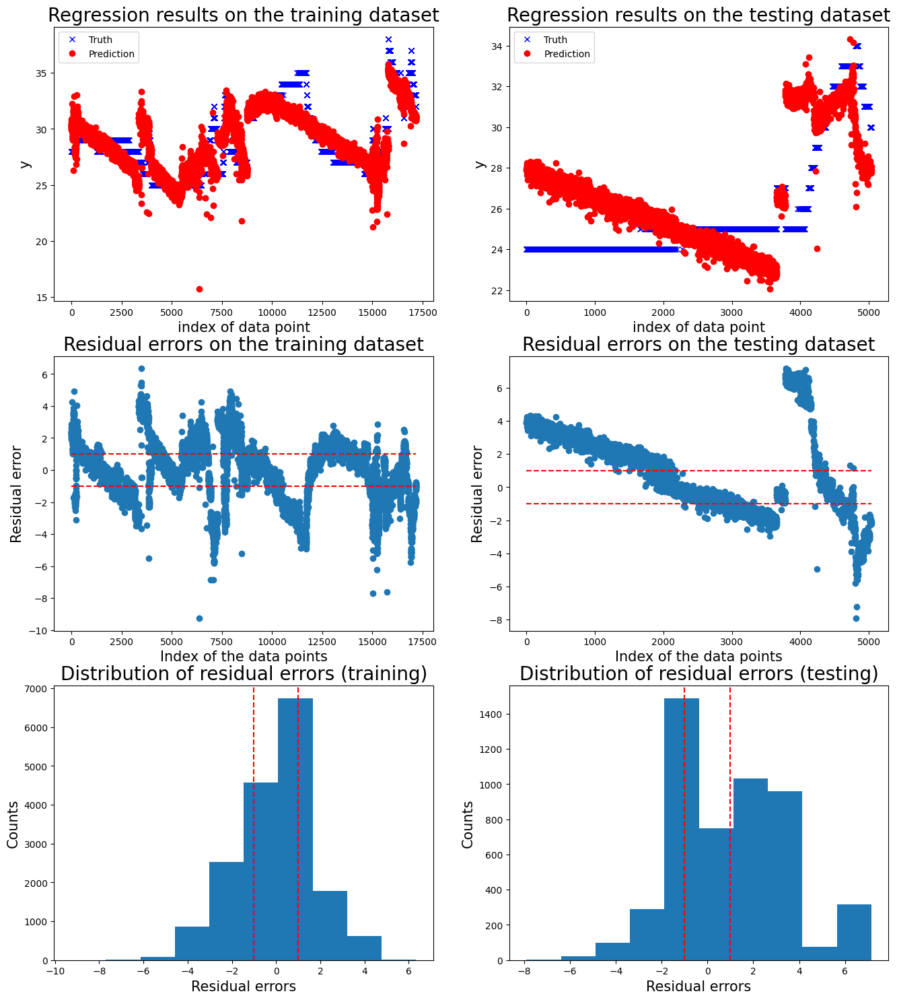


 New run:

training performance, max error is: 10.237742330936875
training performance, mean root square error is: 1.964832181298397
training performance, residual error > 1: 66.2781540400063%

 New run:

testing performance, max error is: 6.703564079748297
testing performance, mean root square error is: 4.135766737729457
testing performance, residual error > 1: 98.61286254728878%


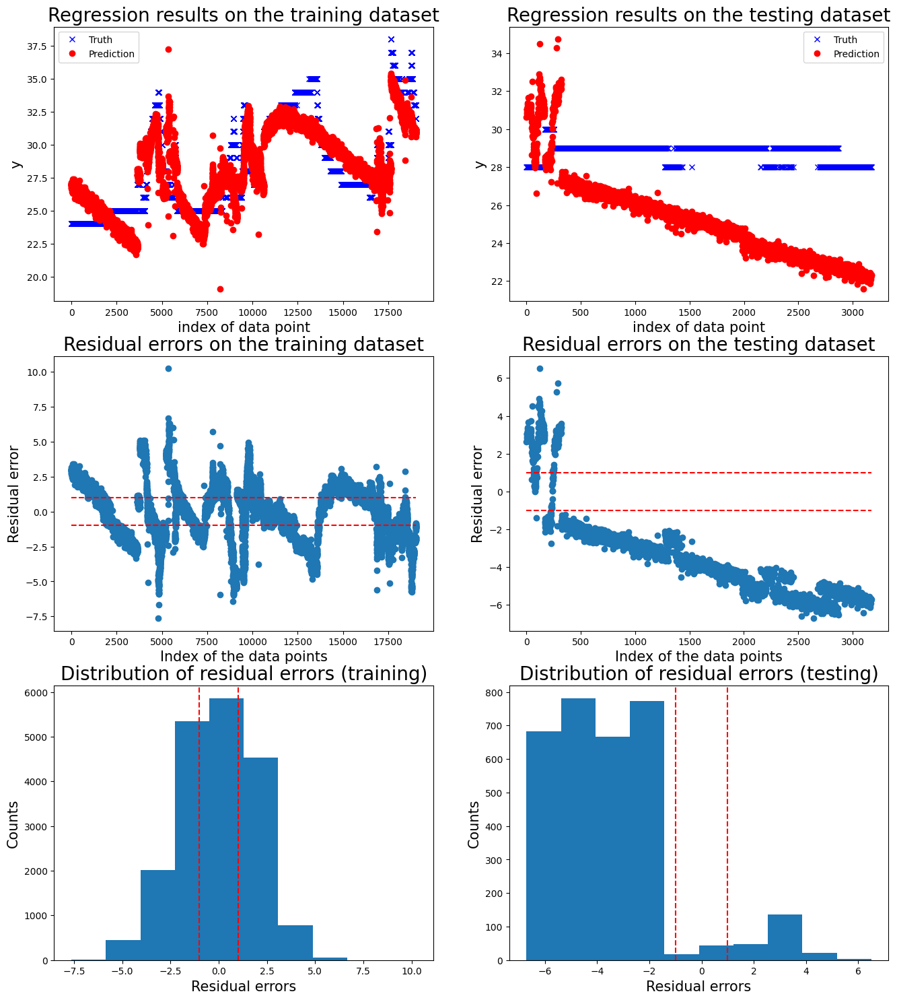


 New run:

training performance, max error is: 6.624795048224115
training performance, mean root square error is: 1.800722136552081
training performance, residual error > 1: 63.87072669531104%

 New run:

testing performance, max error is: 11.380040935950035
testing performance, mean root square error is: 5.290141467564135
testing performance, residual error > 1: 79.05824039653035%


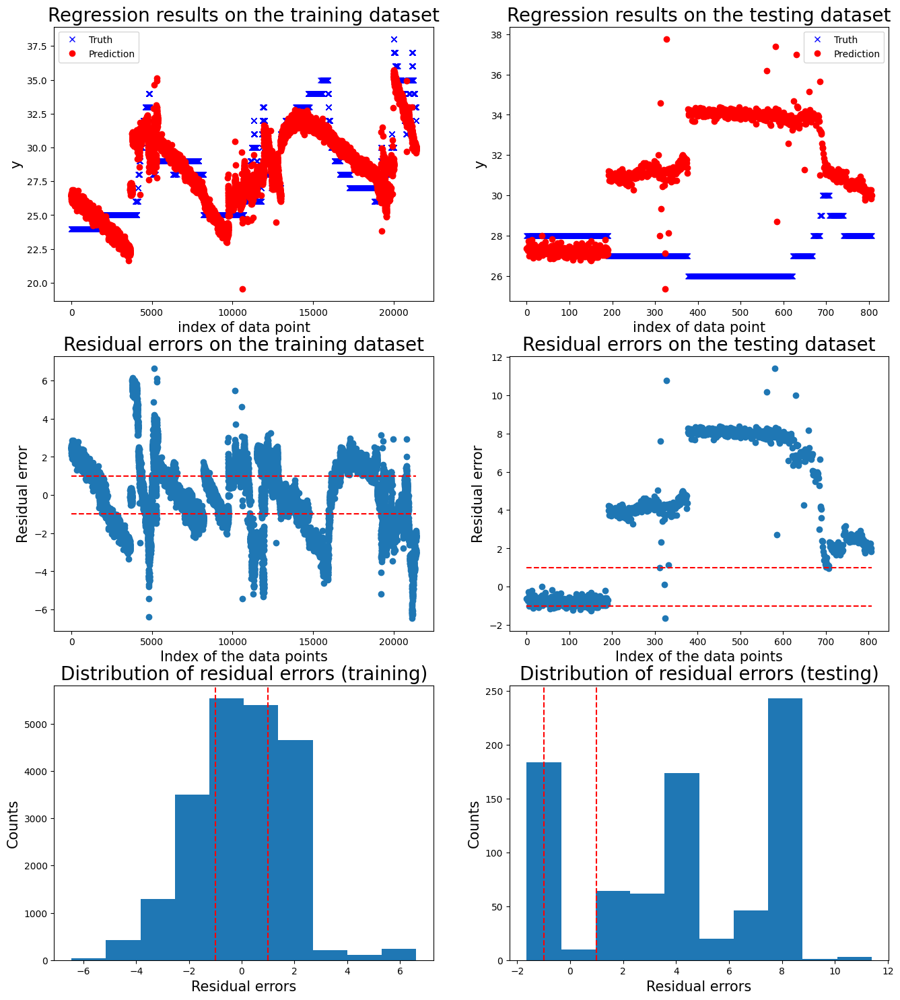


 New run:

training performance, max error is: 7.772633407294428
training performance, mean root square error is: 1.2943240492743318
training performance, residual error > 1: 22.39615216440752%

 New run:

testing performance, max error is: 15.206849301011502
testing performance, mean root square error is: 6.202441440539743
testing performance, residual error > 1: 66.70994065281899%


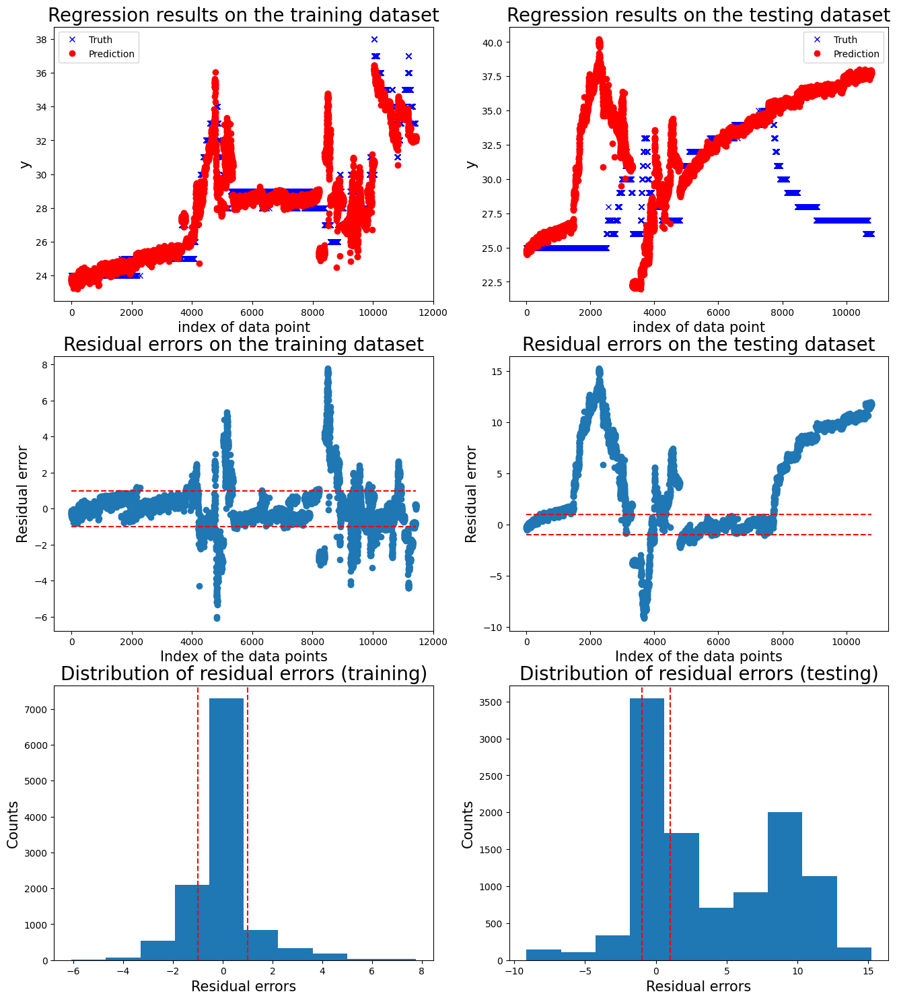


 New run:

training performance, max error is: 8.720202435034082
training performance, mean root square error is: 1.7446076773739048
training performance, residual error > 1: 58.92216778625183%

 New run:

testing performance, max error is: 10.507856466741455
testing performance, mean root square error is: 5.320618599822505
testing performance, residual error > 1: 86.44628099173553%


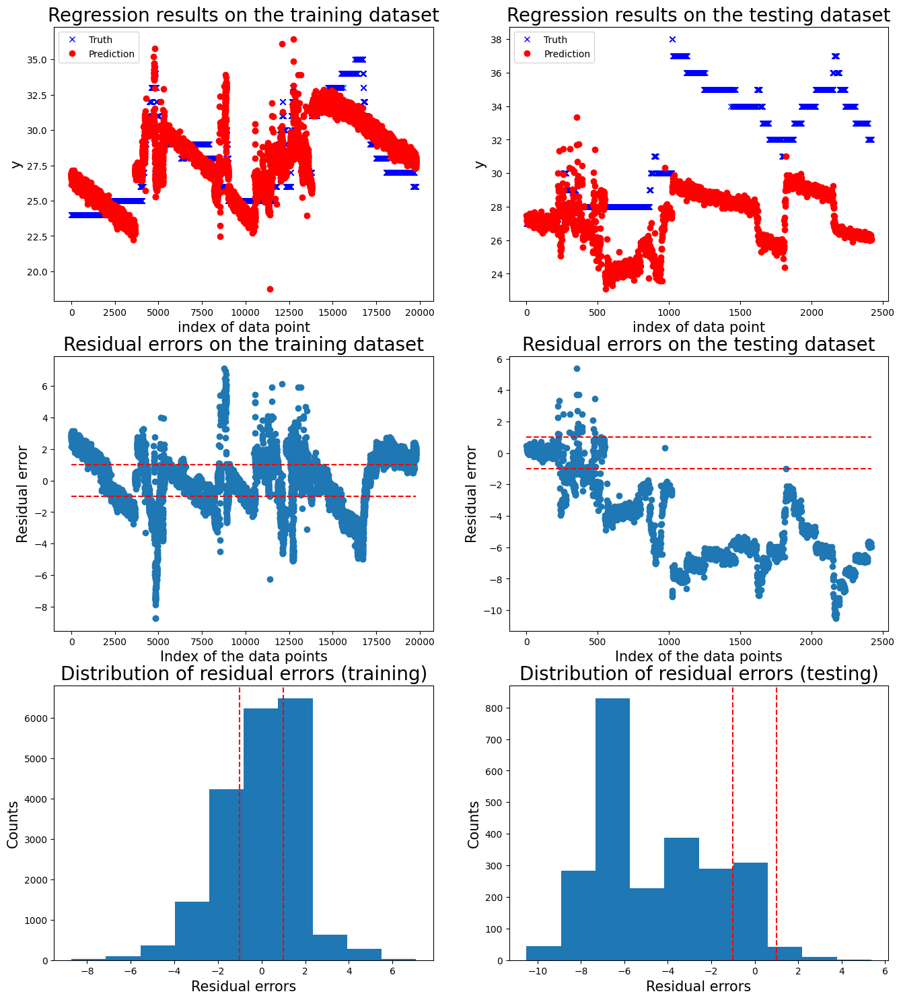

   Max error      RMSE  Exceed boundary rate
0   7.903770  2.664736              0.703932
1   6.703564  4.135767              0.986129
2  11.380041  5.290141              0.790582
3  15.206849  6.202441              0.667099
4  10.507856  5.320619              0.864463


Mean performance metric and standard error:
Max error: 10.3404 +- 3.3149
RMSE: 4.7227 +- 1.3646
Exceed boundary rate: 0.8024 +- 0.1282




In [7]:
from utility import run_cv_one_motor

feature_list_all = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 'data_motor_1_voltage',
                    'data_motor_2_position', 'data_motor_2_temperature', 'data_motor_2_voltage',
                    'data_motor_3_position', 'data_motor_3_temperature', 'data_motor_3_voltage',
                    'data_motor_4_position', 'data_motor_4_temperature', 'data_motor_4_voltage',
                    'data_motor_5_position', 'data_motor_5_temperature', 'data_motor_5_voltage',
                    'data_motor_6_position', 'data_motor_6_temperature', 'data_motor_6_voltage']

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=mdl_linear_regreession, 
            feature_list=feature_list_all, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

### linear regression with feature selection 

Model for motor 6:

 New run:

training performance, max error is: 6.627012427410733
training performance, mean root square error is: 1.8440568011499778
training performance, residual error > 1: 53.812056737588655%

 New run:

testing performance, max error is: 13.904017913638103
testing performance, mean root square error is: 6.46814079483068
testing performance, residual error > 1: 81.93864030170216%


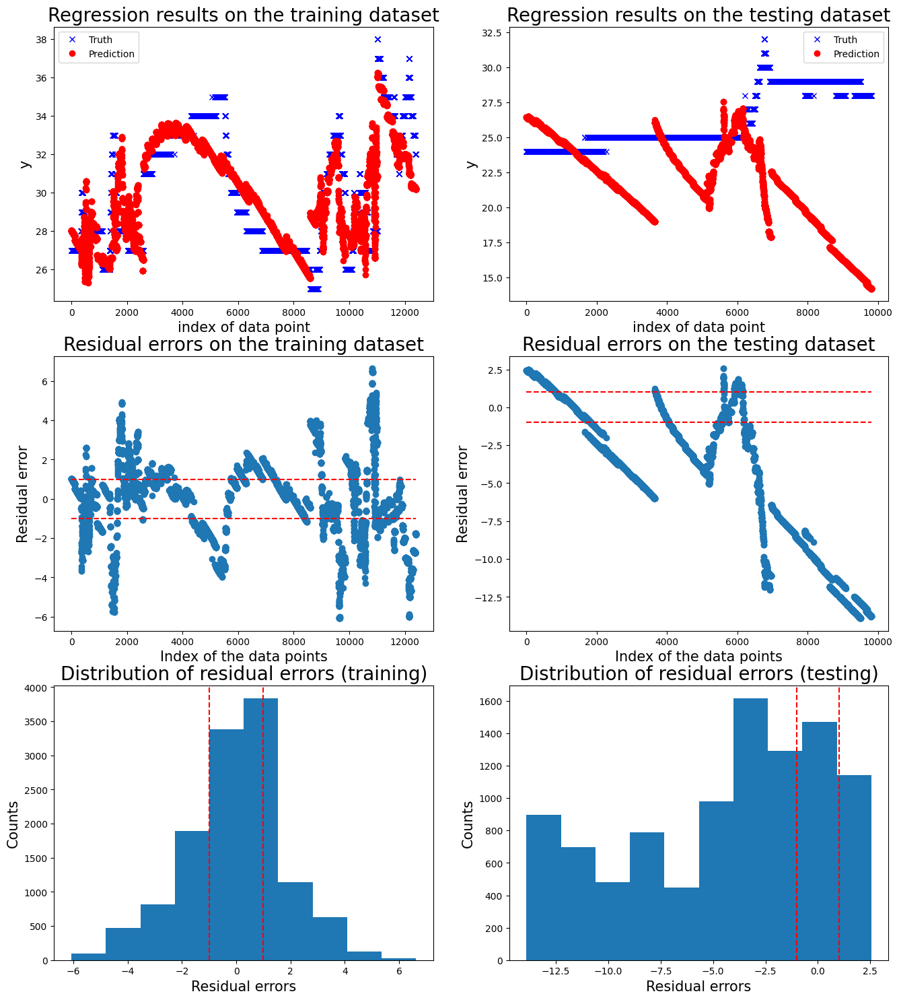


 New run:

training performance, max error is: 6.91091016435232
training performance, mean root square error is: 1.8631352598282789
training performance, residual error > 1: 65.42343964741008%

 New run:

testing performance, max error is: 14.491203054990851
testing performance, mean root square error is: 5.342806570910125
testing performance, residual error > 1: 99.55277280858677%


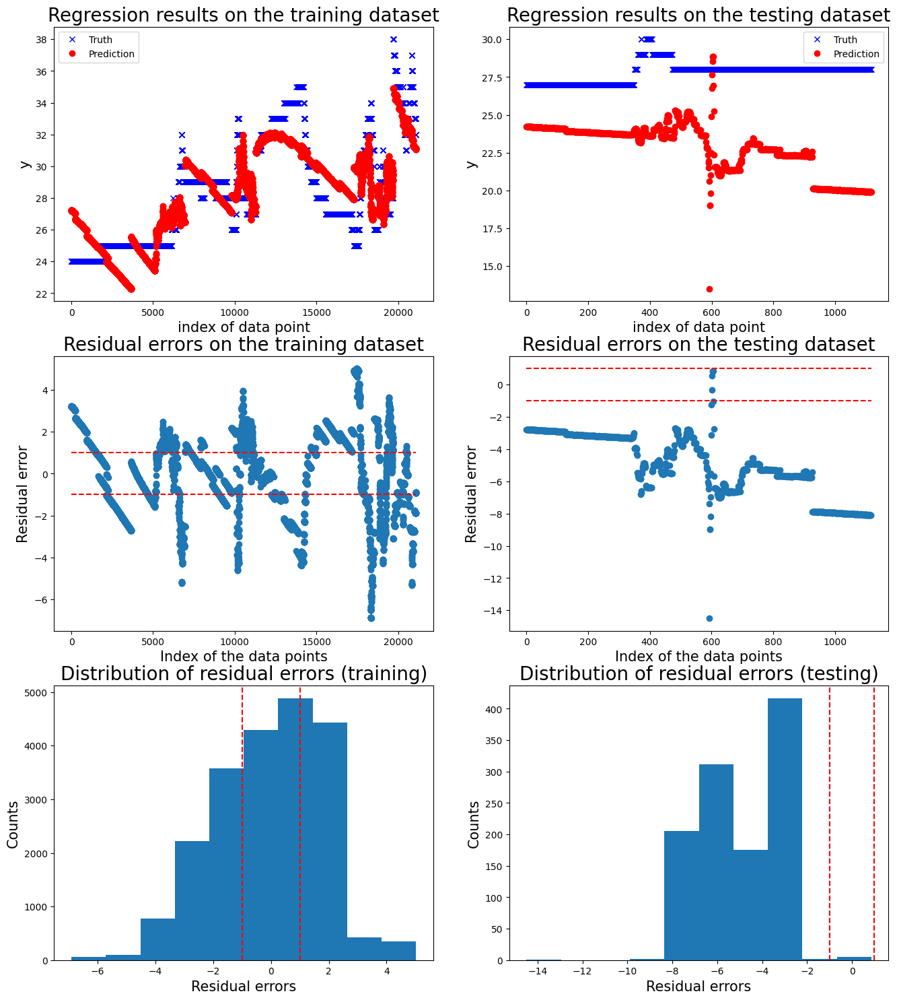


 New run:

training performance, max error is: 6.573669980996968
training performance, mean root square error is: 1.414123957387859
training performance, residual error > 1: 26.190123090612488%

 New run:

testing performance, max error is: 7.419729285571751
testing performance, mean root square error is: 4.006122221706822
testing performance, residual error > 1: 63.90701935188366%


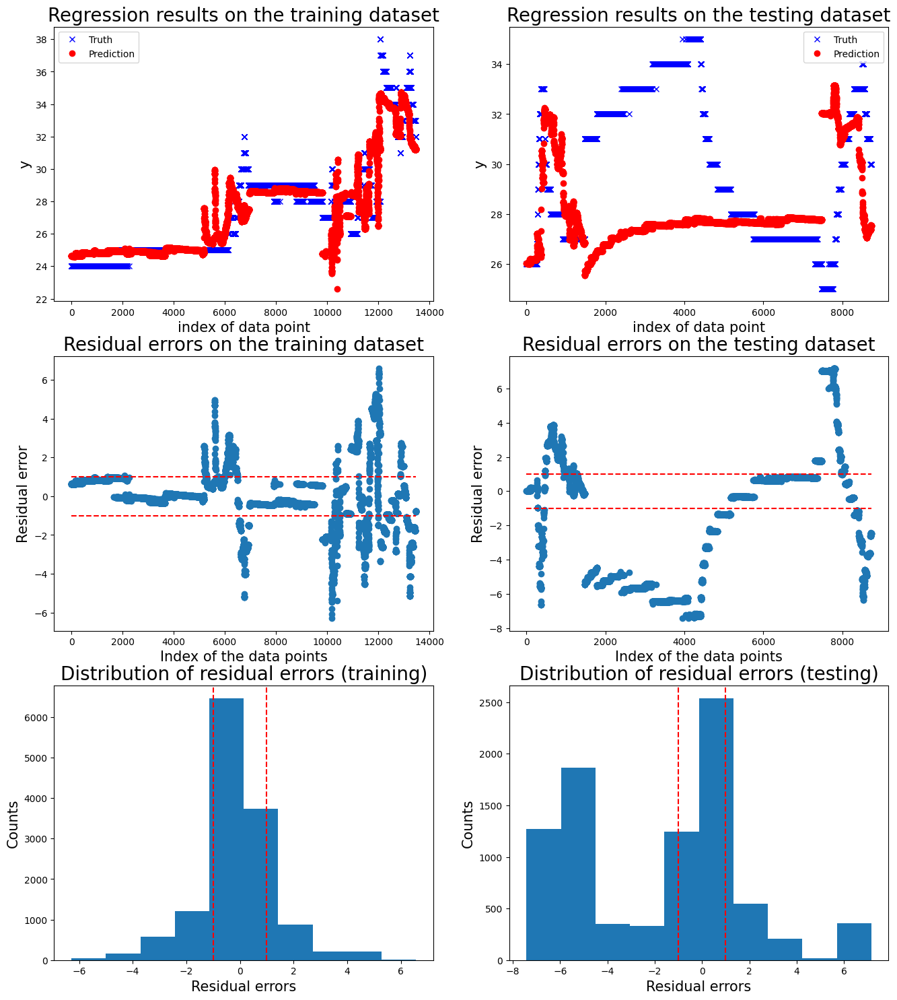


 New run:

training performance, max error is: 6.550149575669529
training performance, mean root square error is: 1.8378208622170682
training performance, residual error > 1: 65.18328274573896%

 New run:

testing performance, max error is: 8.558711047320656
testing performance, mean root square error is: 5.366410243021112
testing performance, residual error > 1: 78.1094527363184%


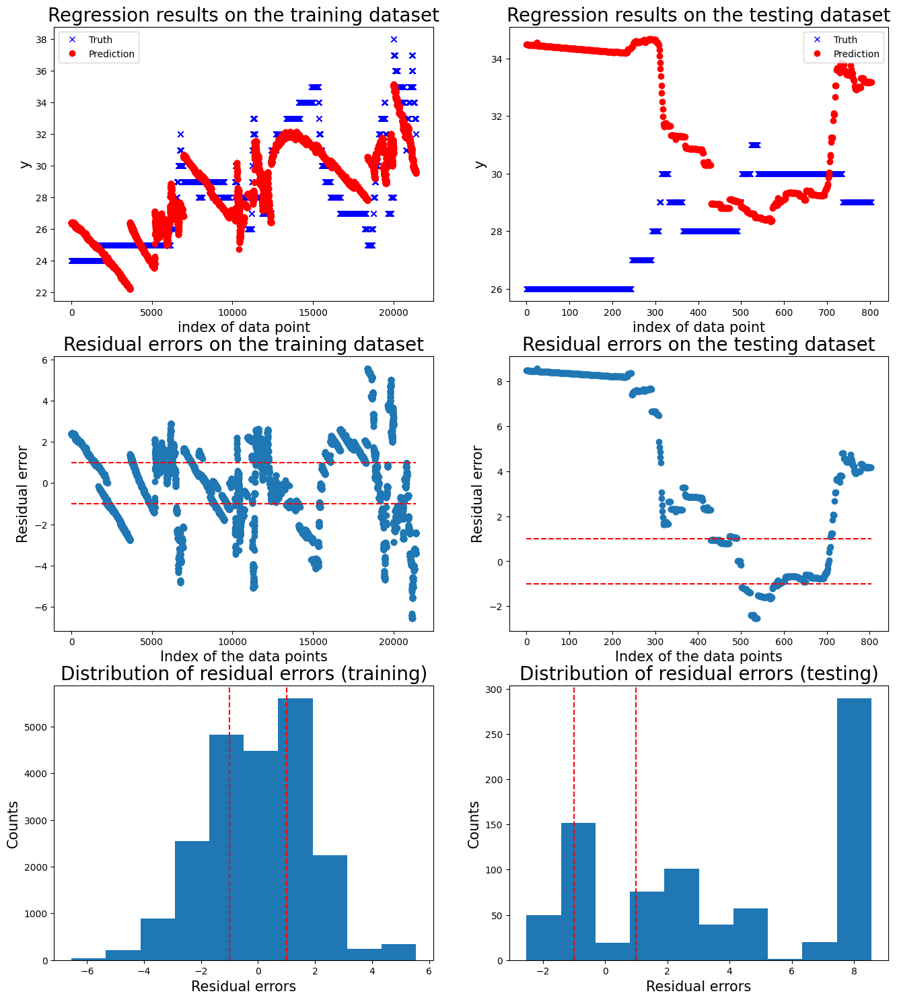


 New run:

training performance, max error is: 6.688157202489265
training performance, mean root square error is: 1.8792529800752256
training performance, residual error > 1: 63.8913319652106%

 New run:

testing performance, max error is: 8.19048185386417
testing performance, mean root square error is: 3.7962433163365445
testing performance, residual error > 1: 92.86936679977183%


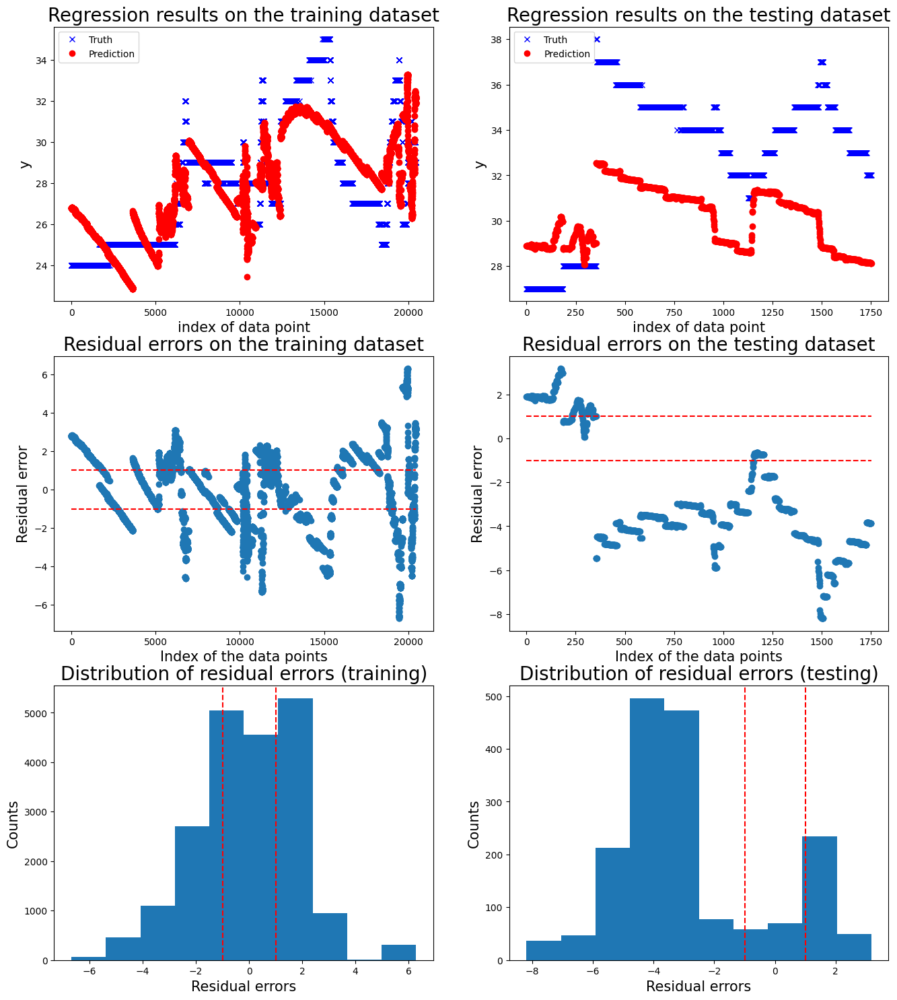

   Max error      RMSE  Exceed boundary rate
0  13.904018  6.468141              0.819386
1  14.491203  5.342807              0.995528
2   7.419729  4.006122              0.639070
3   8.558711  5.366410              0.781095
4   8.190482  3.796243              0.928694


Mean performance metric and standard error:
Max error: 10.5128 +- 3.3951
RMSE: 4.9959 +- 1.1004
Exceed boundary rate: 0.8328 +- 0.1379




In [8]:
from utility import run_cv_one_motor

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data, mdl=mdl_linear_regreession, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

### linear regression with removing sequence to sequence viability and add dynamic features 

In [27]:
n_int = 20

def compensate_seq_bias(df: pd.DataFrame):
    ''' # Description
    Adjust for the sequence-to-sequence bias.
    '''
    # Tranform the features relative to the first data point.
    df['temperature'] = df['temperature'] - df['temperature'].iloc[0]
    df['voltage'] = df['voltage'] - df['voltage'].iloc[0]
    df['position'] = df['position'] - df['position'].iloc[0]

def cal_diff(df: pd.DataFrame, n_int: int):
        ''' # Description
        Calculate the difference between the current and previous n data point.
        '''
        # Tranform the features relative to the first data point.
        df['temperature'] = df['temperature'] - df['temperature'].iloc[0]
        df['voltage'] = df['voltage'] - df['voltage'].iloc[0]
        df['position'] = df['position'] - df['position'].iloc[0]

        # Calculate the difference between the current and previous n data point.
        df['temperature_diff'] = df['temperature'].diff(n_int)
        df['voltage_diff'] = df['voltage'].diff(n_int)
        df['position_diff'] = df['position'].diff(n_int) 

# Subfunction for data preprocessing.
def pre_processing(df: pd.DataFrame):
    ''' ### Description
    Preprocess the data:
    - remove outliers
    - Adjust for the sequence-to-sequence bias.
    - add new features about the difference between the current and previous n data point.
    '''     
    # Start processing.
    customized_outlier_removal(df)
    # compensate_seq_bias(df)
    cal_diff(df, n_int)

In [28]:
df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

In [11]:
from utility import read_all_csvs_one_test
import matplotlib.pyplot as plt
import pandas as pd
import os

# Get all the folders in the base_dictionary
path_list = os.listdir(base_dictionary)
# Only keep the folders, not the excel file.
# print(path_list)
path_list = [file for file in path_list if not file.endswith(".xlsx")]

# Read the data.
df_data_smoothing = pd.DataFrame()
for tmp_path in path_list:
    path = base_dictionary + tmp_path
    # Read the data with the customized outlier removal function.
    tmp_df = read_all_csvs_one_test(path, tmp_path, pre_processing)
    df_data_smoothing = pd.concat([df_data_smoothing, tmp_df])
    df_data_smoothing = df_data_smoothing.reset_index(drop=True)

# Read the test conditions
df_test_conditions = pd.read_excel(base_dictionary+'Test conditions.xlsx')


In [29]:
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']
df_data = df_data[df_data['test_condition'].isin(normal_test_id)]
df_data_smoothing = df_data_smoothing[df_data_smoothing['test_condition'].isin(normal_test_id)]


Model for motor 6:

 New run:

training performance, max error is: 5.224783125883258
training performance, mean root square error is: 1.456820815208066
training performance, residual error > 1: 51.43819855358317%

 New run:

testing performance, max error is: 17.46684551675019
testing performance, mean root square error is: 5.560285283338475
testing performance, residual error > 1: 87.75510204081633%


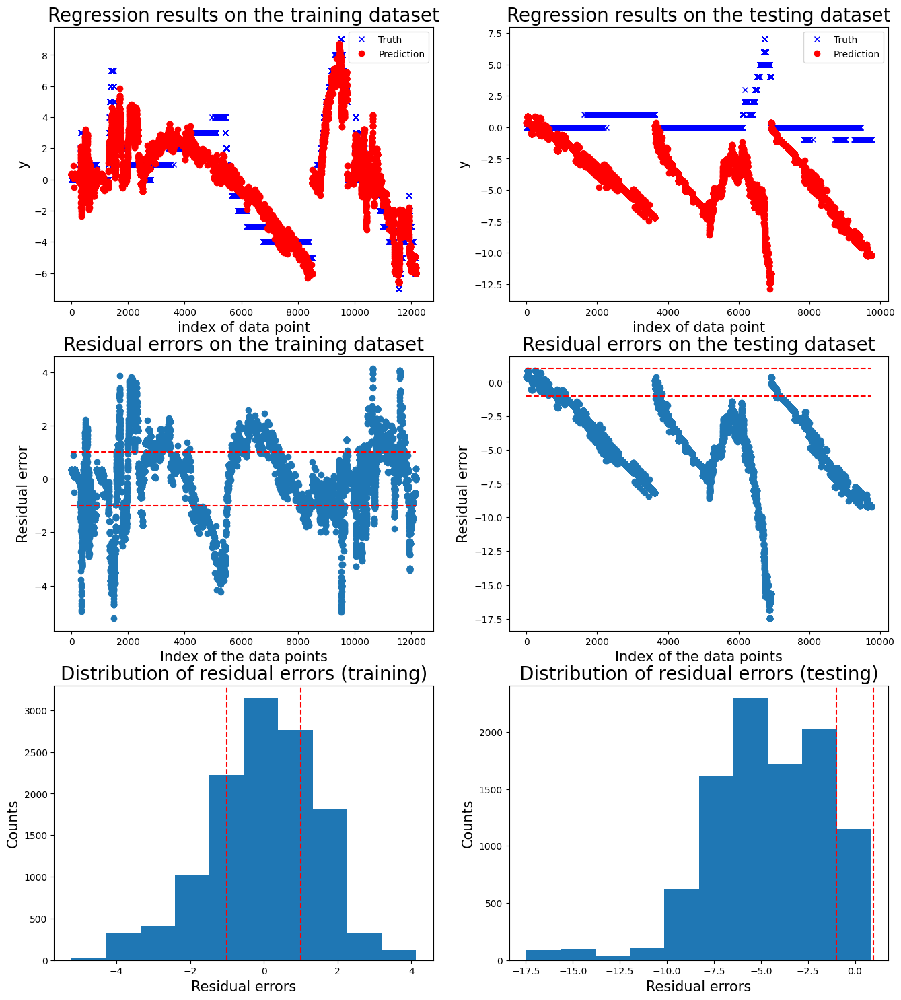


 New run:

training performance, max error is: 8.040687907496071
training performance, mean root square error is: 1.8576133049365384
training performance, residual error > 1: 59.81017209146253%

 New run:

testing performance, max error is: 6.50429278673634
testing performance, mean root square error is: 2.084937779706165
testing performance, residual error > 1: 61.247637051039696%


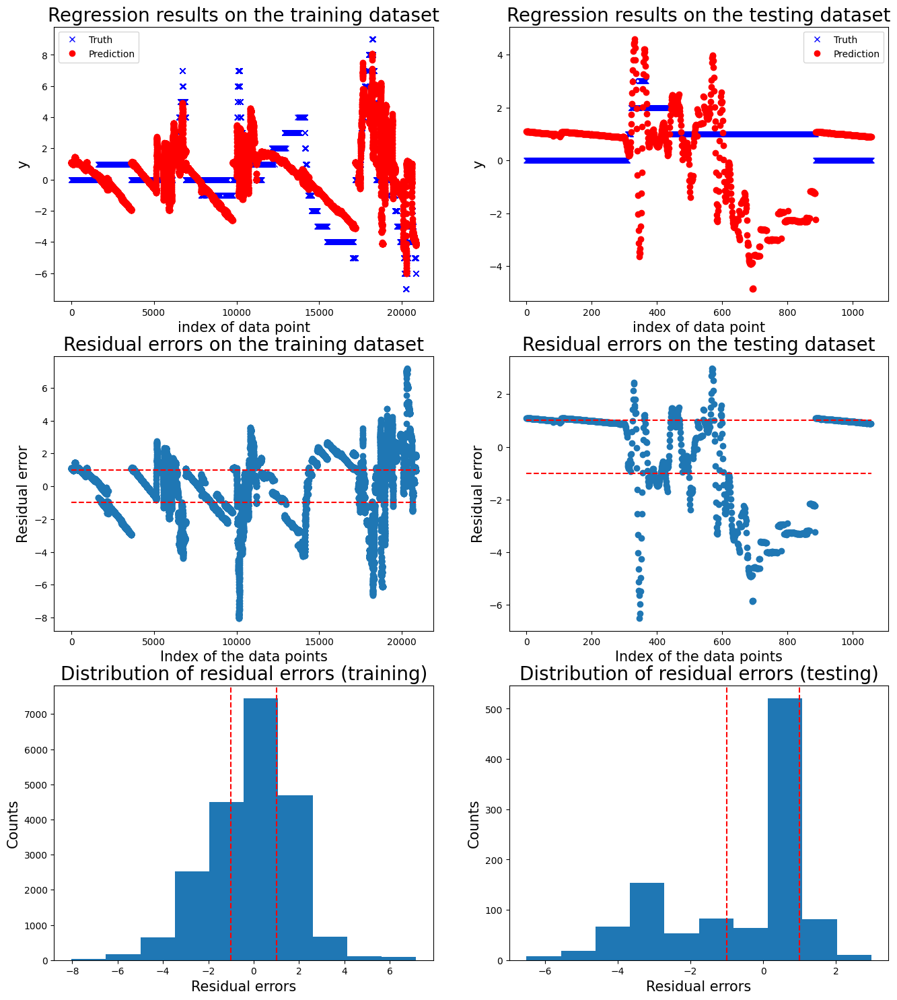


 New run:

training performance, max error is: 4.880007863849631
training performance, mean root square error is: 0.9438956888630948
training performance, residual error > 1: 19.68896270572248%

 New run:

testing performance, max error is: 13.28743226739536
testing performance, mean root square error is: 6.354727628459206
testing performance, residual error > 1: 86.85575925285369%


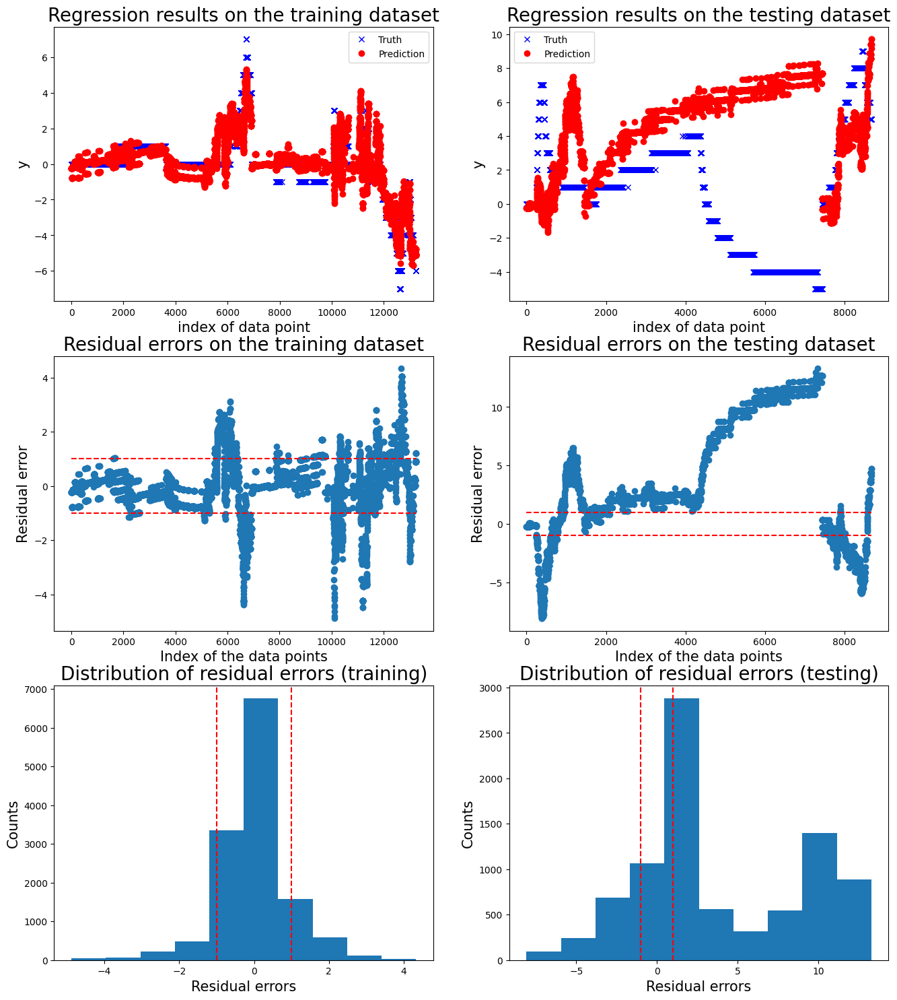


 New run:

training performance, max error is: 8.333043418454471
training performance, mean root square error is: 1.7991687053582597
training performance, residual error > 1: 59.41440377804014%

 New run:

testing performance, max error is: 9.065217021277501
testing performance, mean root square error is: 3.4573835687940577
testing performance, residual error > 1: 63.03763440860215%


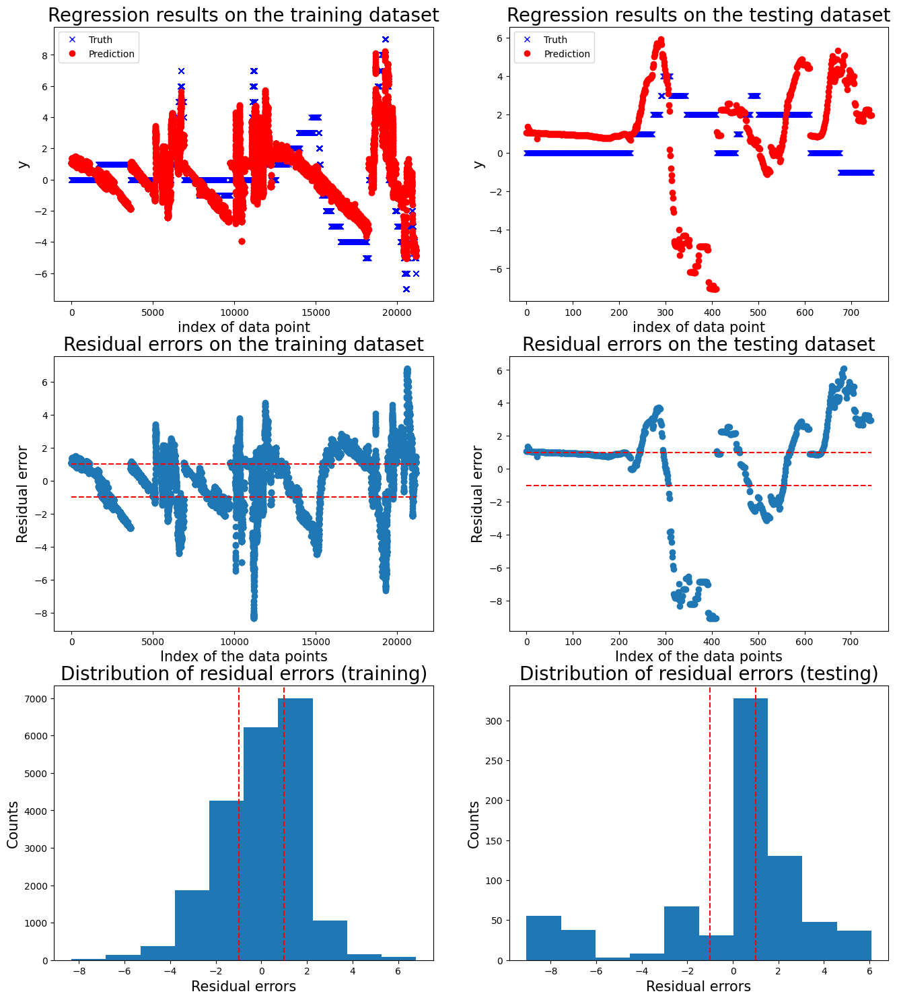


 New run:

training performance, max error is: 6.00422915171246
training performance, mean root square error is: 1.5953437847577032
training performance, residual error > 1: 62.38999307821616%

 New run:

testing performance, max error is: 10.248665080013557
testing performance, mean root square error is: 5.939209448415508
testing performance, residual error > 1: 97.75546367395157%


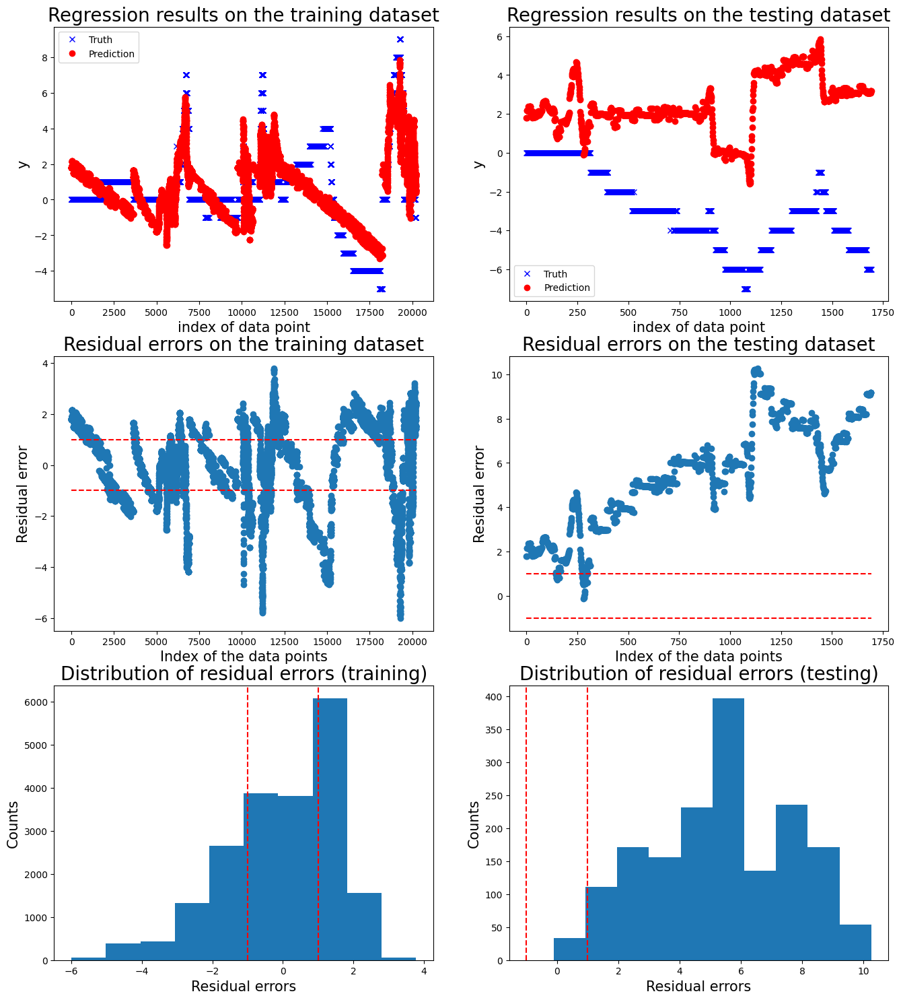

   Max error      RMSE  Exceed boundary rate
0  17.466846  5.560285              0.877551
1   6.504293  2.084938              0.612476
2  13.287432  6.354728              0.868558
3   9.065217  3.457384              0.630376
4  10.248665  5.939209              0.977555


Mean performance metric and standard error:
Max error: 11.3145 +- 4.2154
RMSE: 4.6793 +- 1.8299
Exceed boundary rate: 0.7933 +- 0.1628




In [13]:
from utility import run_cv_one_motor

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature', 
                    'data_motor_1_position_diff', 'data_motor_1_temperature_diff', 
                    'data_motor_2_position_diff', 'data_motor_2_temperature_diff', 
                    'data_motor_3_position_diff', 'data_motor_3_temperature_diff', 
                    'data_motor_4_position_diff', 'data_motor_4_temperature_diff', 
                    'data_motor_5_position_diff', 'data_motor_5_temperature_diff', 
                    'data_motor_6_position_diff', 'data_motor_6_temperature_diff']

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data, mdl=mdl_linear_regreession, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

### linear regression with data smoothing, feature selection, removing sequence to sequence viability and add dynamic features

Model for motor 6:

 New run:

training performance, max error is: 5.540499694746185
training performance, mean root square error is: 1.3367729540406814
training performance, residual error > 1: 38.77117393613882%

 New run:

testing performance, max error is: 15.76452545601419
testing performance, mean root square error is: 6.443929110570887
testing performance, residual error > 1: 86.03295819935691%


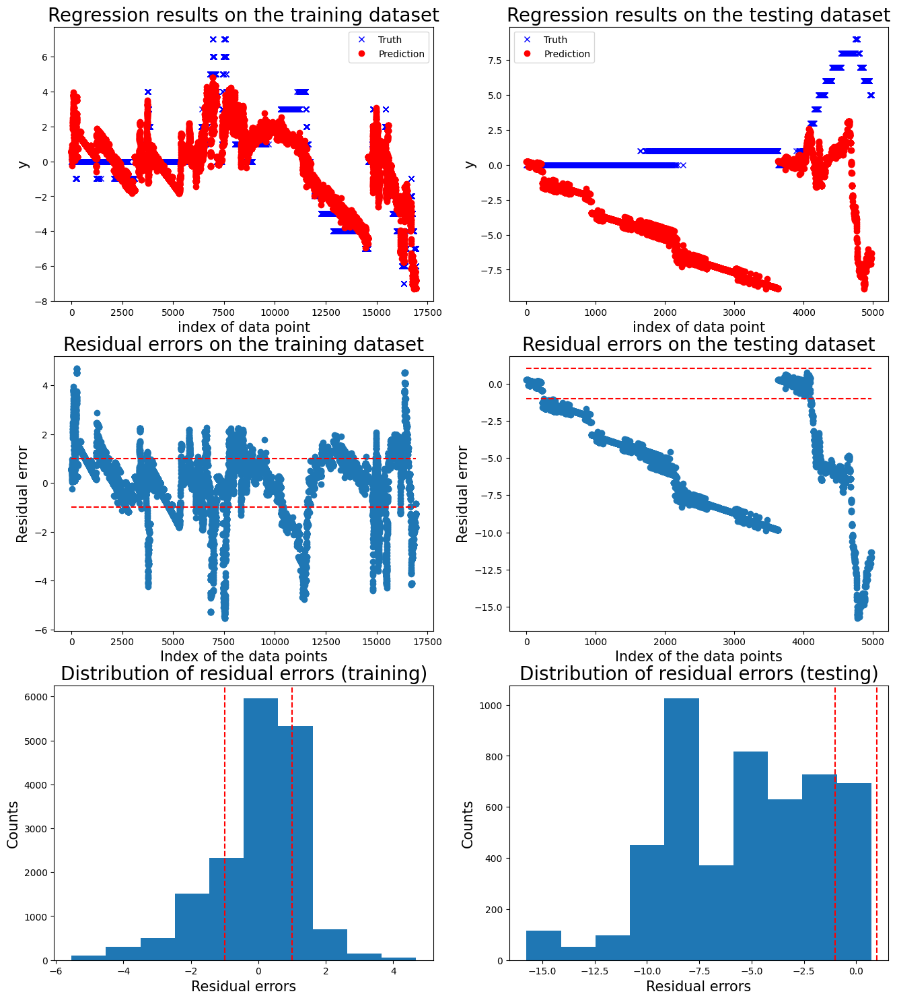


 New run:

training performance, max error is: 7.742937040496457
training performance, mean root square error is: 1.8861949413083159
training performance, residual error > 1: 59.993619397033015%

 New run:

testing performance, max error is: 5.697525405815663
testing performance, mean root square error is: 2.4829431009384404
testing performance, residual error > 1: 64.49228791773778%


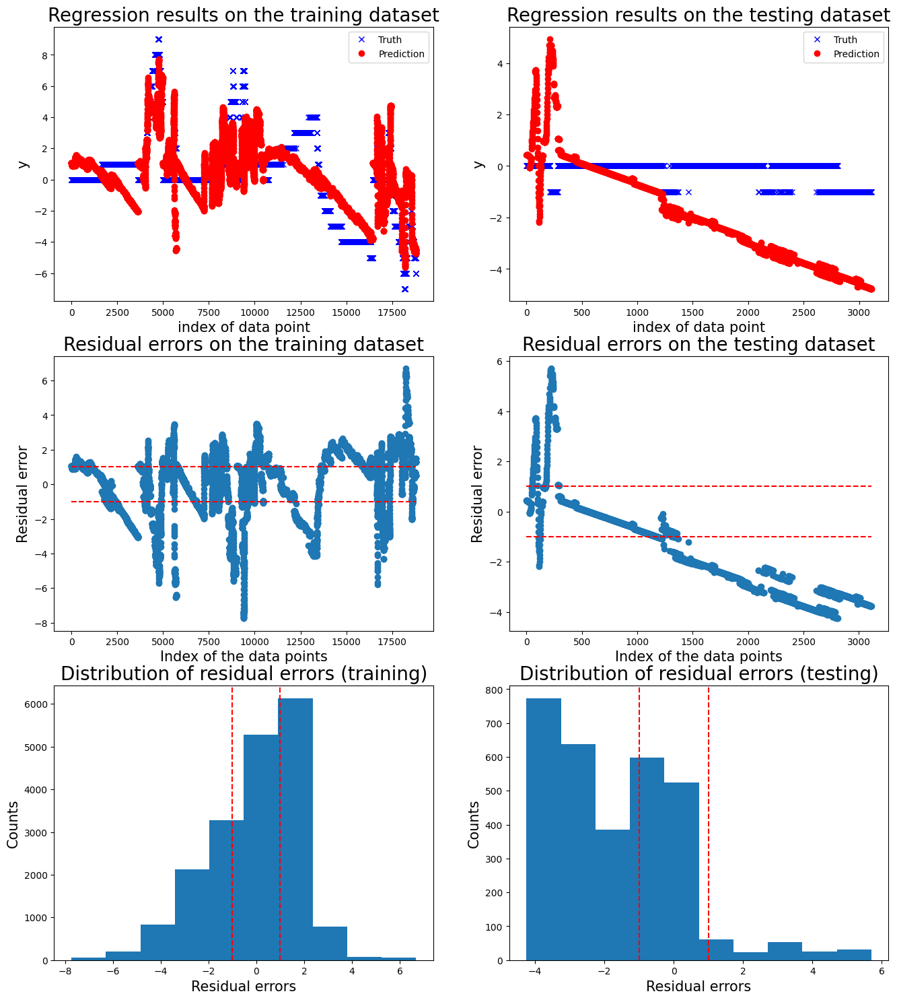


 New run:

training performance, max error is: 8.152434932689292
training performance, mean root square error is: 1.820251642145195
training performance, residual error > 1: 59.42754581522765%

 New run:

testing performance, max error is: 8.897331463216759
testing performance, mean root square error is: 2.9647389051168918
testing performance, residual error > 1: 45.38152610441767%


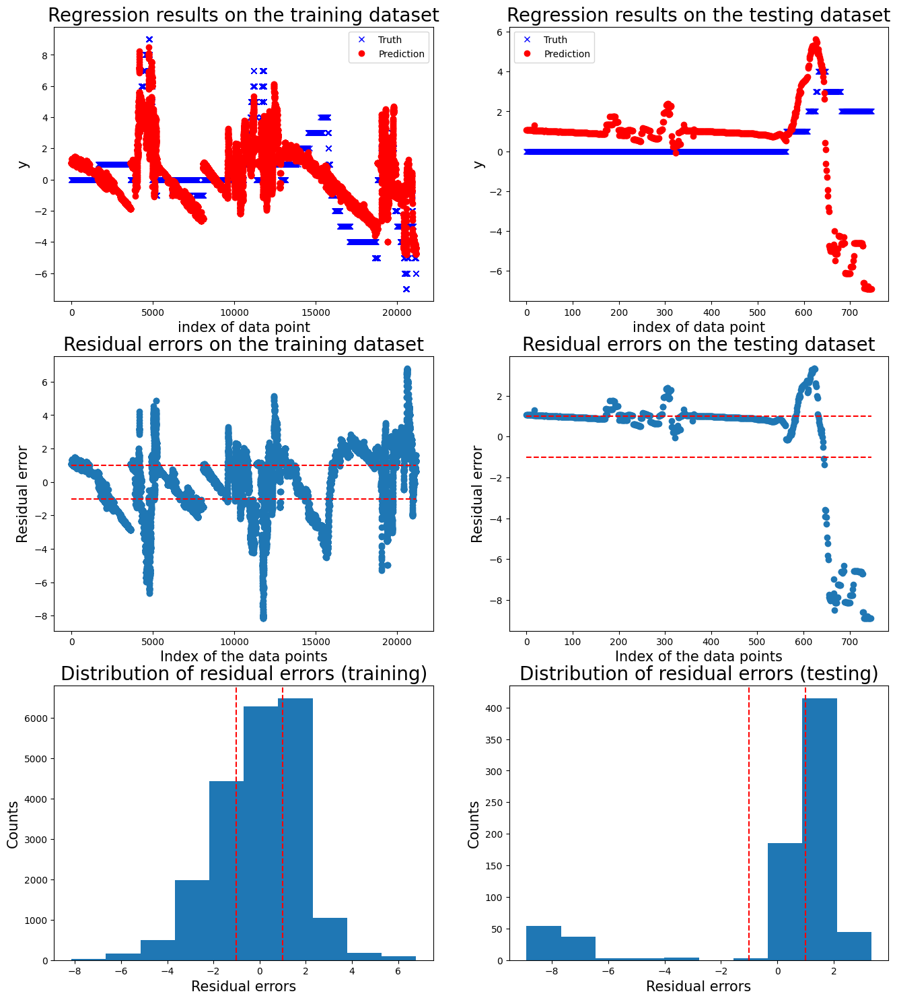


 New run:

training performance, max error is: 3.9614422851158495
training performance, mean root square error is: 0.5709185179734244
training performance, residual error > 1: 7.217507815989281%

 New run:

testing performance, max error is: 14.257522026655684
testing performance, mean root square error is: 6.899727410742173
testing performance, residual error > 1: 76.15628496829541%


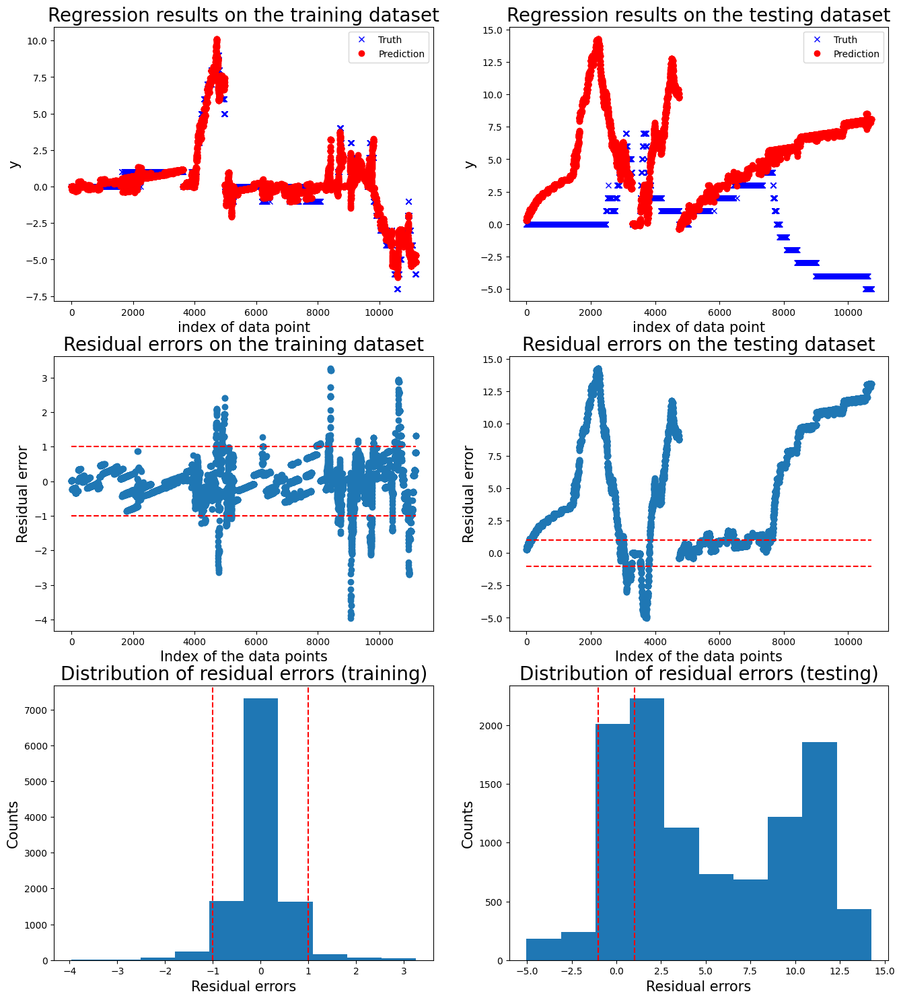


 New run:

training performance, max error is: 6.4722302292437845
training performance, mean root square error is: 1.5841152181250284
training performance, residual error > 1: 63.67912469962677%

 New run:

testing performance, max error is: 10.472234300395677
testing performance, mean root square error is: 5.10881297491677
testing performance, residual error > 1: 89.02542372881356%


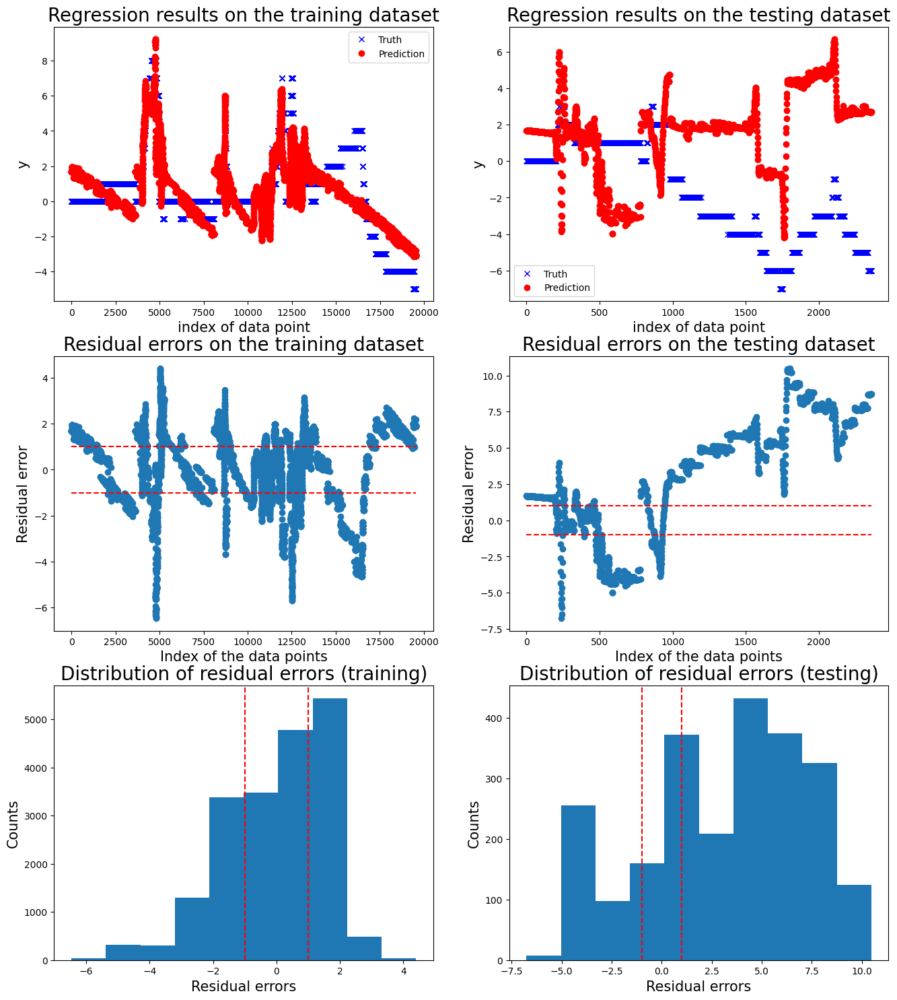

   Max error      RMSE  Exceed boundary rate
0  15.764525  6.443929              0.860330
1   5.697525  2.482943              0.644923
2   8.897331  2.964739              0.453815
3  14.257522  6.899727              0.761563
4  10.472234  5.108813              0.890254


Mean performance metric and standard error:
Max error: 11.0178 +- 4.0659
RMSE: 4.7800 +- 1.9964
Exceed boundary rate: 0.7222 +- 0.1781




In [14]:
from utility import run_cv_one_motor

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature', 
                    'data_motor_1_position_diff', 'data_motor_1_temperature_diff', 
                    'data_motor_2_position_diff', 'data_motor_2_temperature_diff', 
                    'data_motor_3_position_diff', 'data_motor_3_temperature_diff', 
                    'data_motor_4_position_diff', 'data_motor_4_temperature_diff', 
                    'data_motor_5_position_diff', 'data_motor_5_temperature_diff', 
                    'data_motor_6_position_diff', 'data_motor_6_temperature_diff']

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=mdl_linear_regreession, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

### support vector machine regression

Model for motor 6:

 New run:

training performance, max error is: 5.545025754456102
training performance, mean root square error is: 0.5451945788932019
training performance, residual error > 1: 4.0134568848492%

 New run:

testing performance, max error is: 10.950875561008667
testing performance, mean root square error is: 5.895859579149411
testing performance, residual error > 1: 87.72106109324758%


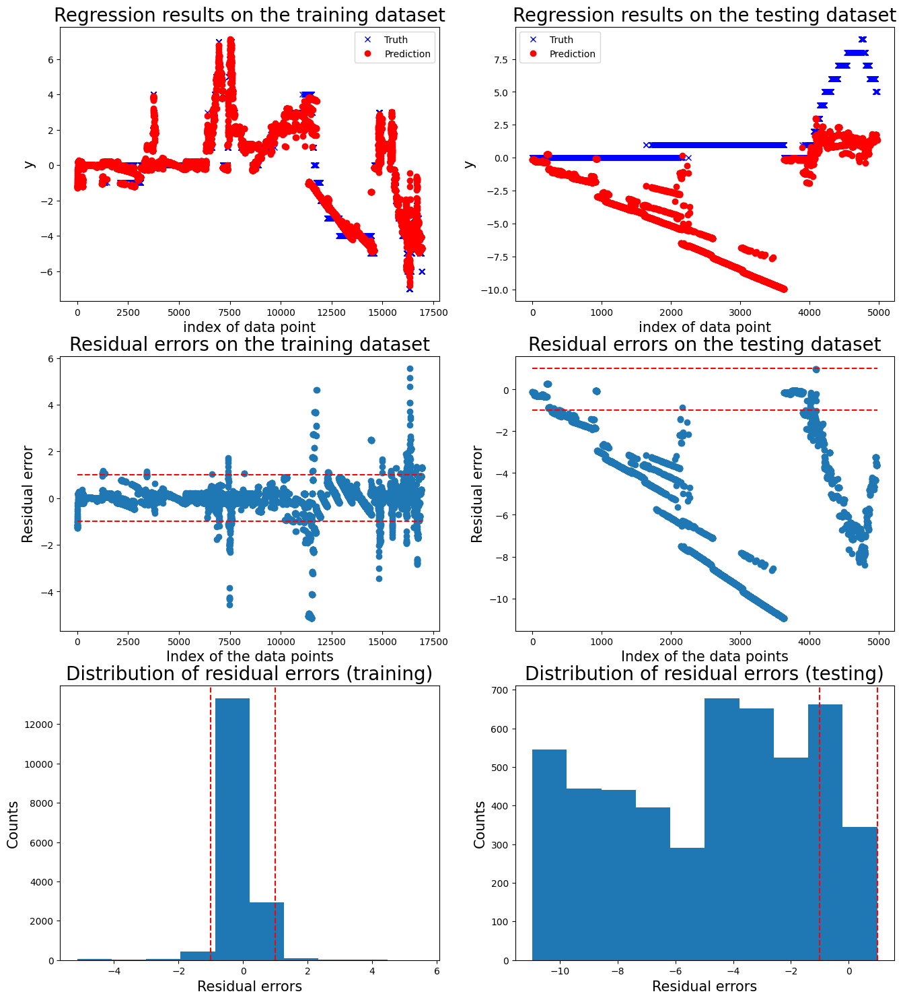


 New run:

training performance, max error is: 5.911007389026062
training performance, mean root square error is: 0.5376615094795332
training performance, residual error > 1: 3.993194023501888%

 New run:

testing performance, max error is: 3.338553602250851
testing performance, mean root square error is: 1.538017947638011
testing performance, residual error > 1: 61.72879177377892%


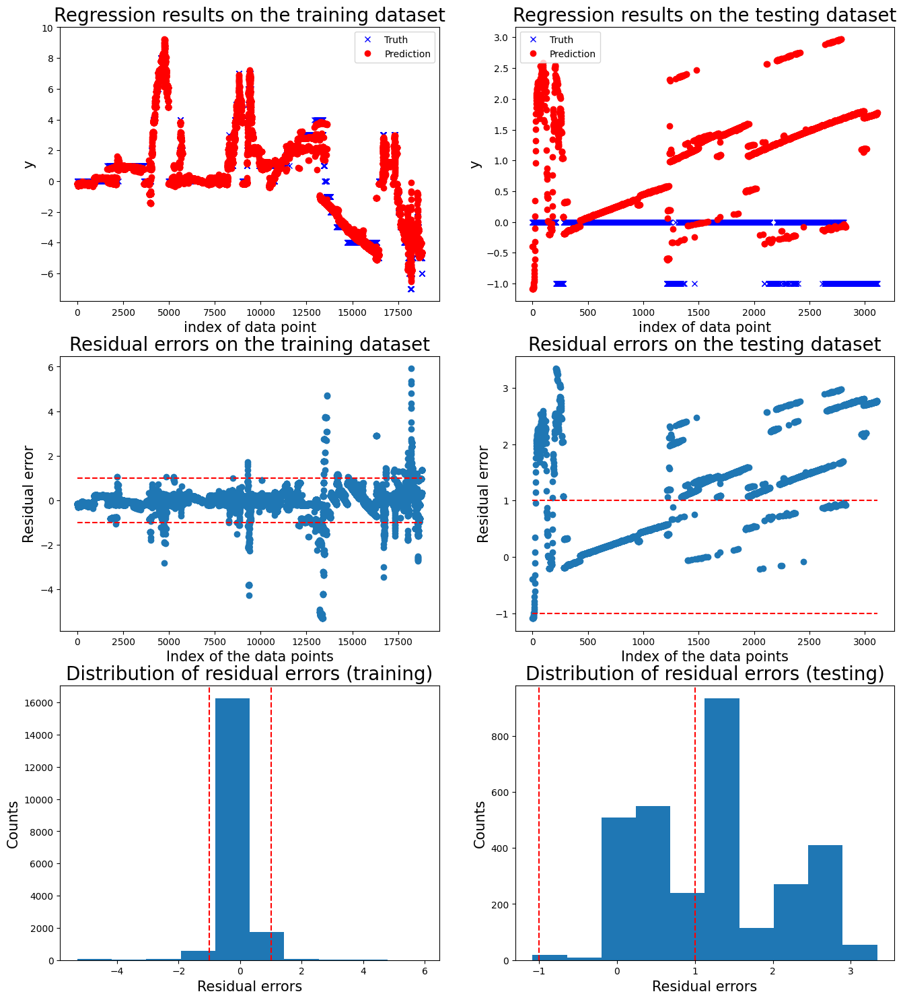


 New run:

training performance, max error is: 6.113105223188564
training performance, mean root square error is: 0.5123907486076296
training performance, residual error > 1: 4.057245418477234%

 New run:

testing performance, max error is: 2.1359158836134857
testing performance, mean root square error is: 0.9340443462921303
testing performance, residual error > 1: 27.84471218206158%


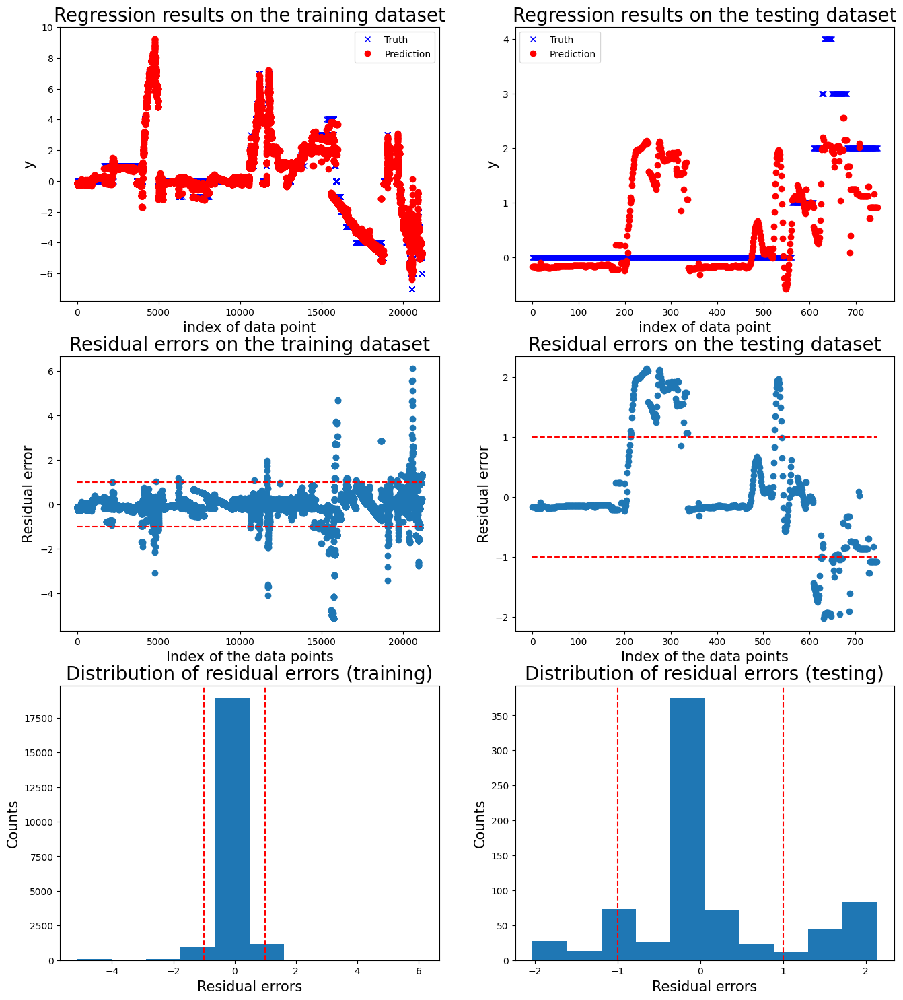


 New run:

training performance, max error is: 3.136926616717413
training performance, mean root square error is: 0.3076274297403519
training performance, residual error > 1: 1.4292094685127288%

 New run:

testing performance, max error is: 6.968842977013697
testing performance, mean root square error is: 3.3283895526092038
testing performance, residual error > 1: 65.62849682954122%


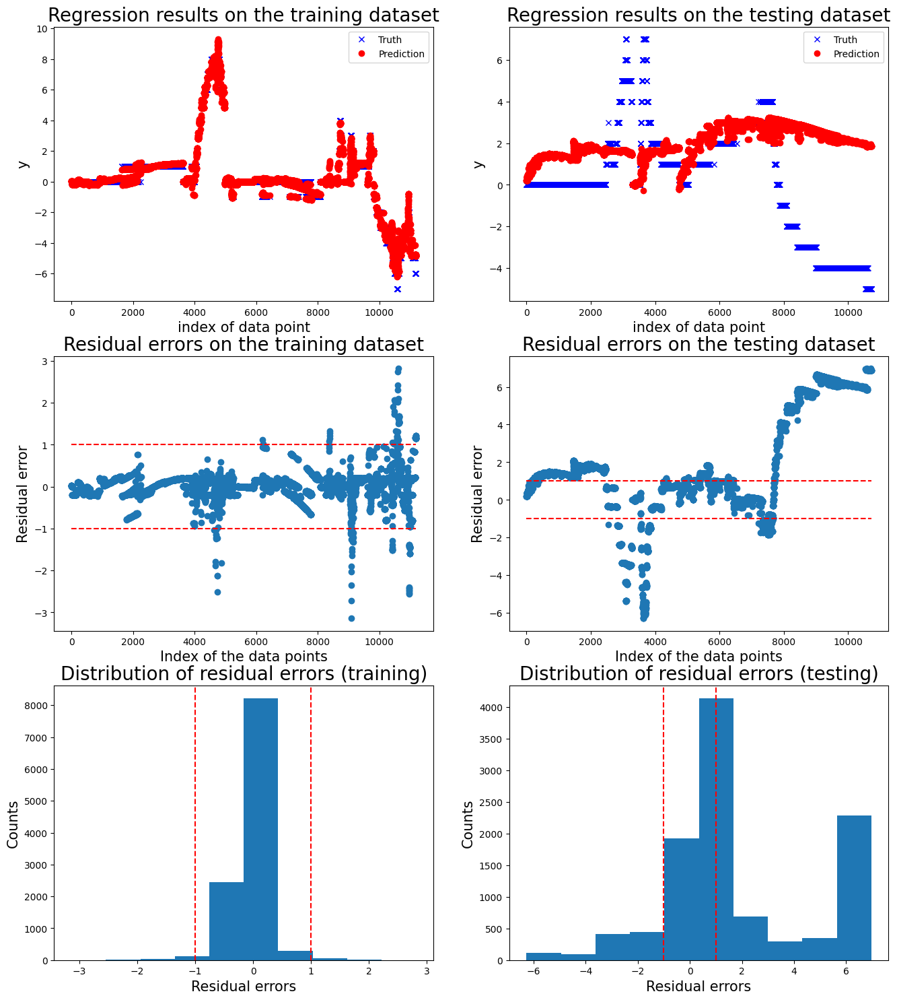


 New run:

training performance, max error is: 5.059191446143785
training performance, mean root square error is: 0.4600998936228351
training performance, residual error > 1: 2.796666496242139%

 New run:

testing performance, max error is: 10.772775813825405
testing performance, mean root square error is: 4.747113423923441
testing performance, residual error > 1: 79.74576271186442%


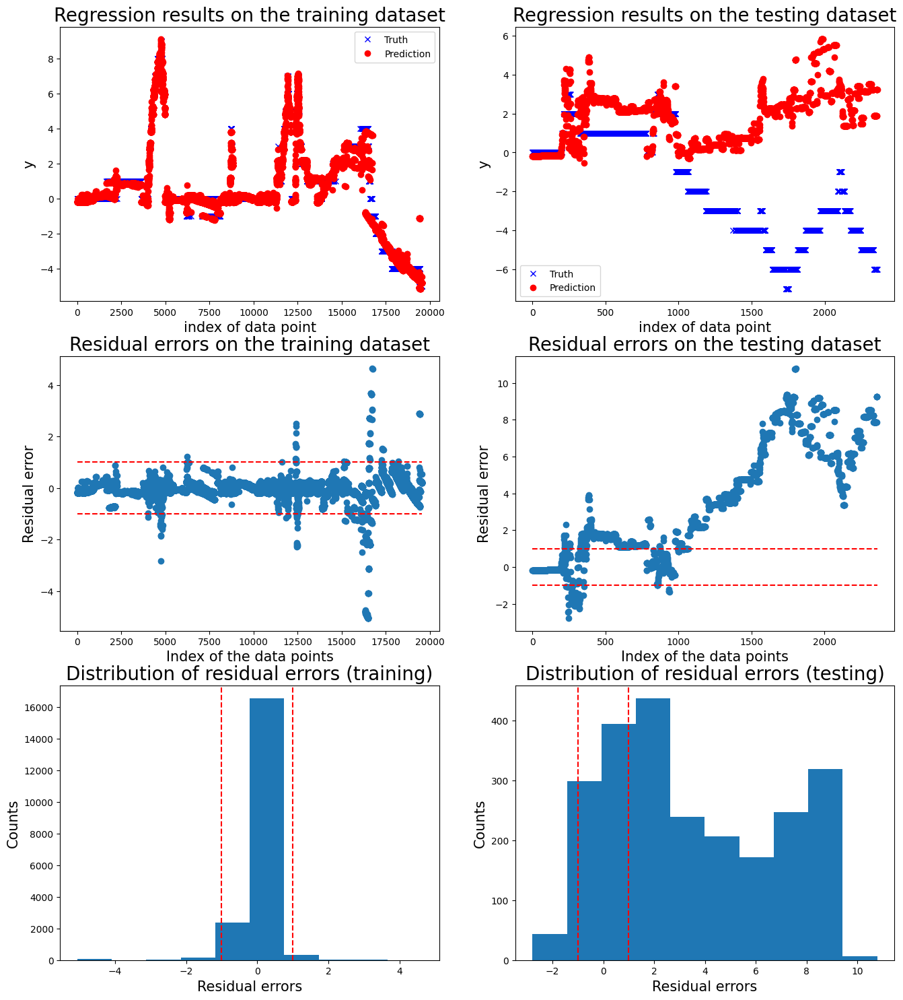

   Max error      RMSE  Exceed boundary rate
0  10.950876  5.895860              0.877211
1   3.338554  1.538018              0.617288
2   2.135916  0.934044              0.278447
3   6.968843  3.328390              0.656285
4  10.772776  4.747113              0.797458


Mean performance metric and standard error:
Max error: 6.8334 +- 4.0857
RMSE: 3.2887 +- 2.0937
Exceed boundary rate: 0.6453 +- 0.2304




In [15]:
from sklearn.svm import SVR 
from sklearn.model_selection import GridSearchCV
import warnings

# Ignore warnings.
warnings.filterwarnings('ignore')

# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SVR(C=1.0, epsilon=0.2))    # Step 2: Linear Regression
]

# Create the pipeline
pipeline = Pipeline(steps)

# Define hyperparameters to search
param_grid = {
    'regressor__C': [1, 10, 100]  # Inverse of regularization strength
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, scoring='f1', cv=5)

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=grid_search, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')


### stochastic gradient descent regression 

Model for motor 6:

 New run:

training performance, max error is: 5.687081816946869
training performance, mean root square error is: 1.3401110186565424
training performance, residual error > 1: 38.747565366227946%

 New run:

testing performance, max error is: 15.883129720195456
testing performance, mean root square error is: 6.454255650554662
testing performance, residual error > 1: 86.09324758842443%


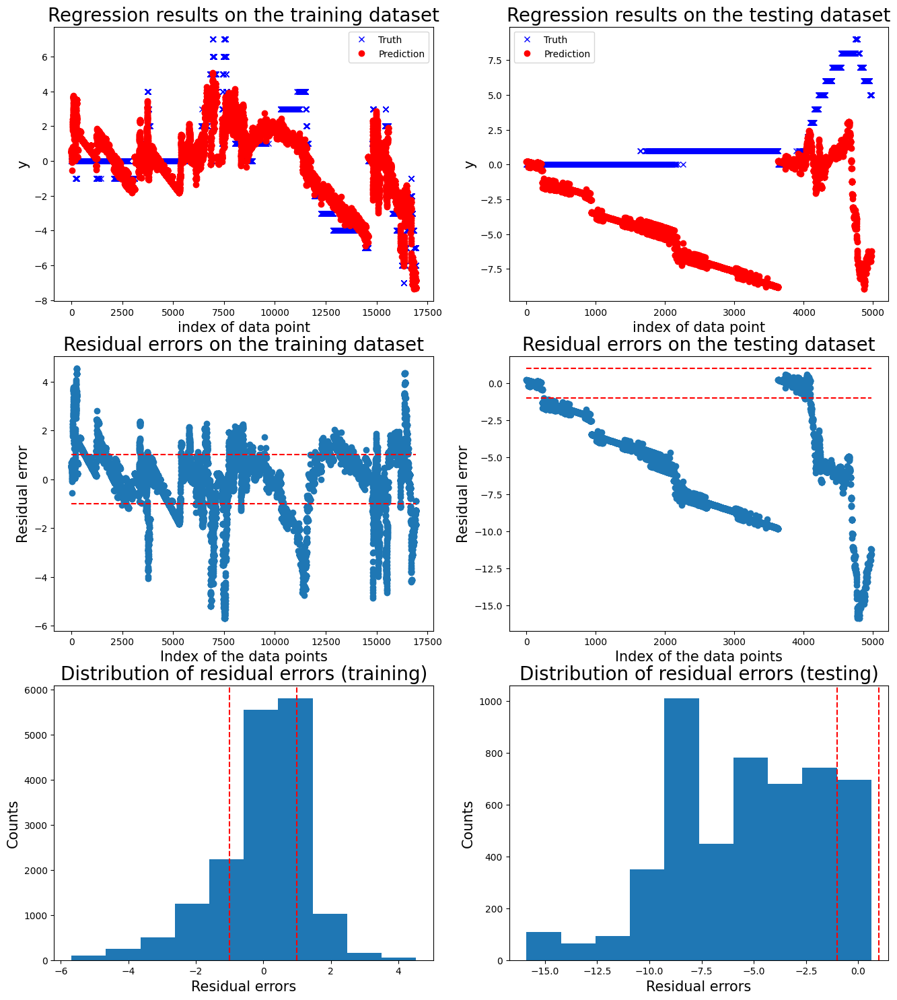


 New run:

training performance, max error is: 7.830480795494001
training performance, mean root square error is: 1.8898385652953178
training performance, residual error > 1: 59.72244377093635%

 New run:

testing performance, max error is: 5.436731244956909
testing performance, mean root square error is: 2.5190321406007525
testing performance, residual error > 1: 65.77763496143959%


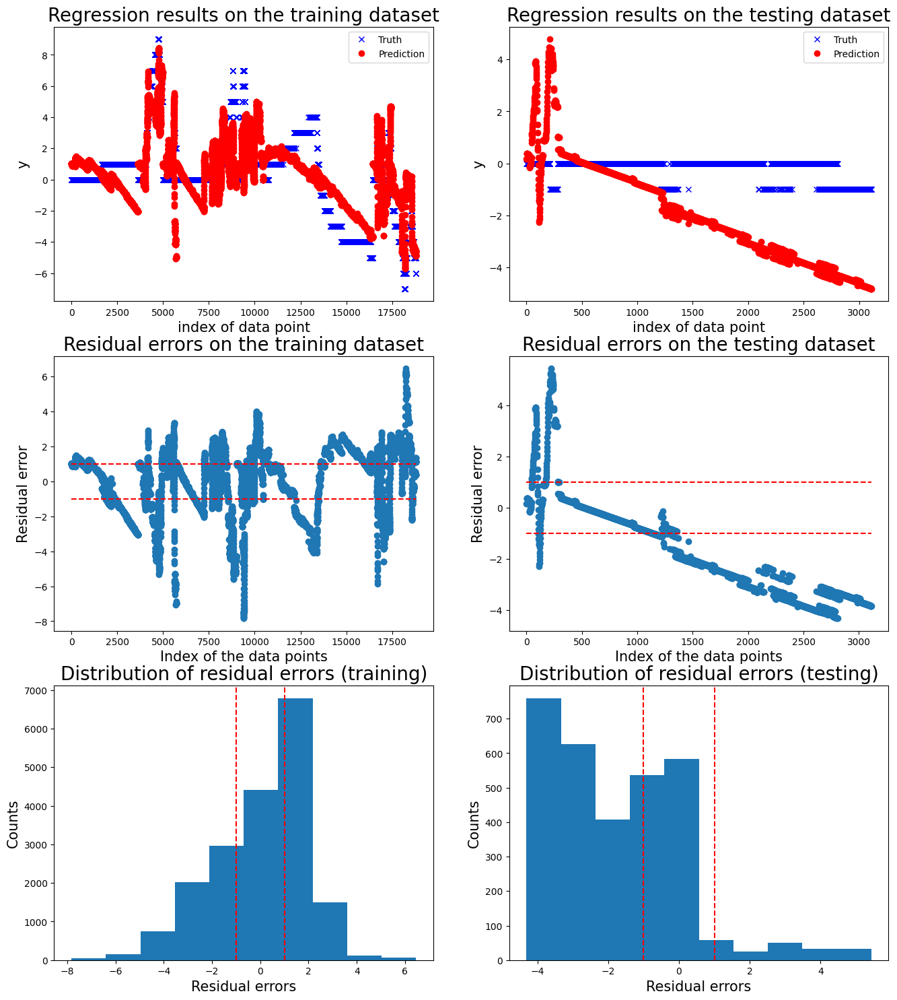


 New run:

training performance, max error is: 8.272134612660473
training performance, mean root square error is: 1.826419676936313
training performance, residual error > 1: 58.89854524844134%

 New run:

testing performance, max error is: 8.730328180467636
testing performance, mean root square error is: 2.9471217002222194
testing performance, residual error > 1: 39.08969210174029%


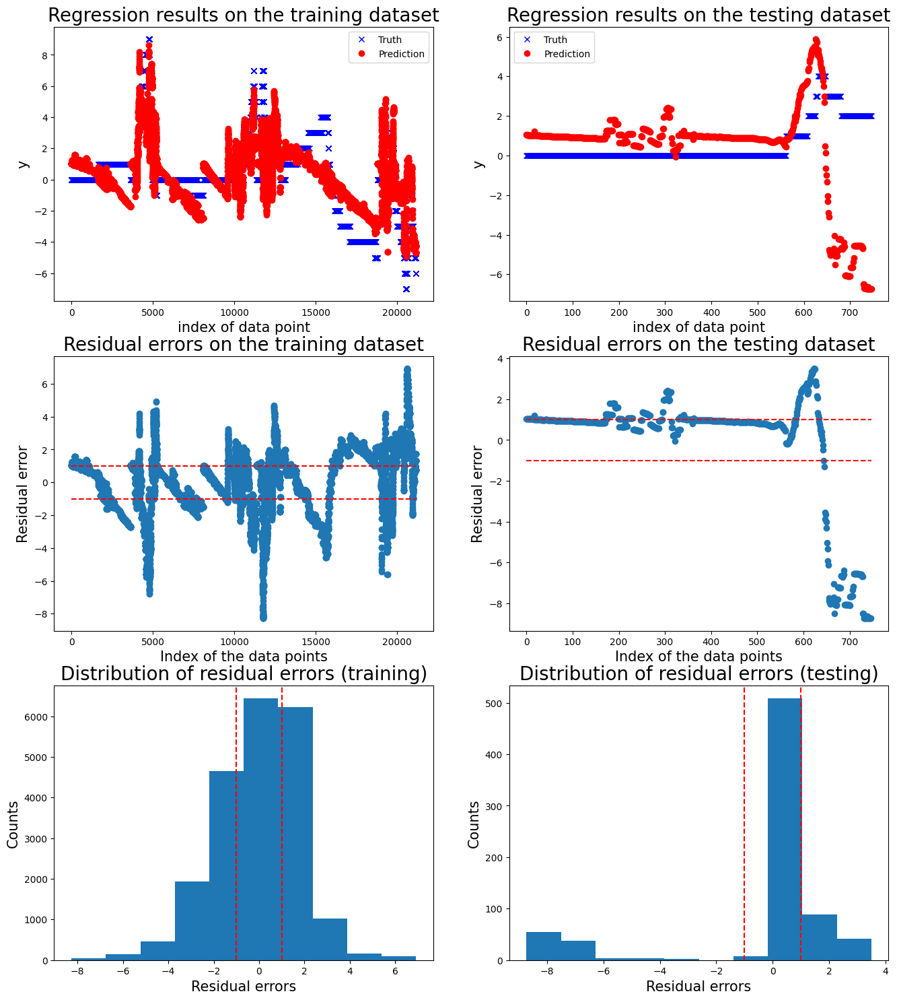


 New run:

training performance, max error is: 3.7483919057582744
training performance, mean root square error is: 0.5731464867481411
training performance, residual error > 1: 7.5837427422956685%

 New run:

testing performance, max error is: 14.12022765938403
testing performance, mean root square error is: 6.954561189699807
testing performance, residual error > 1: 79.1402461767997%


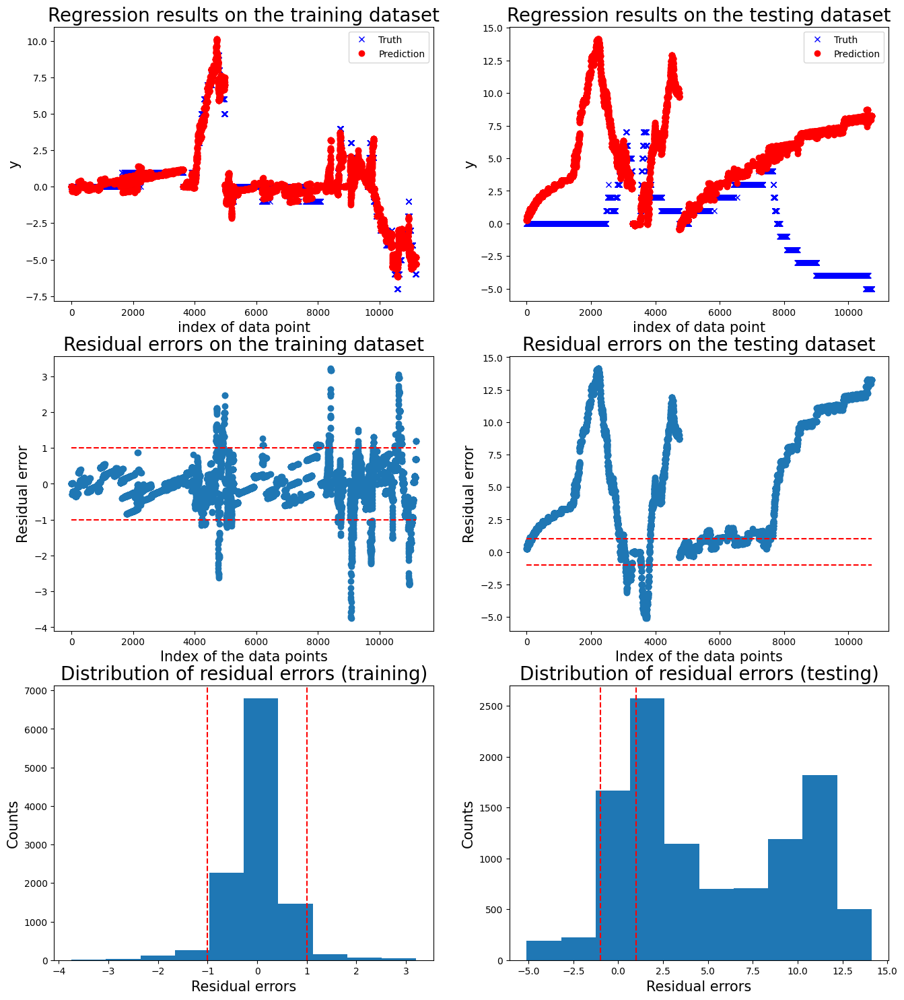


 New run:

training performance, max error is: 6.352820109024907
training performance, mean root square error is: 1.5884475575511379
training performance, residual error > 1: 63.188302060432534%

 New run:

testing performance, max error is: 10.348242276057071
testing performance, mean root square error is: 5.033717741482426
testing performance, residual error > 1: 89.32203389830508%


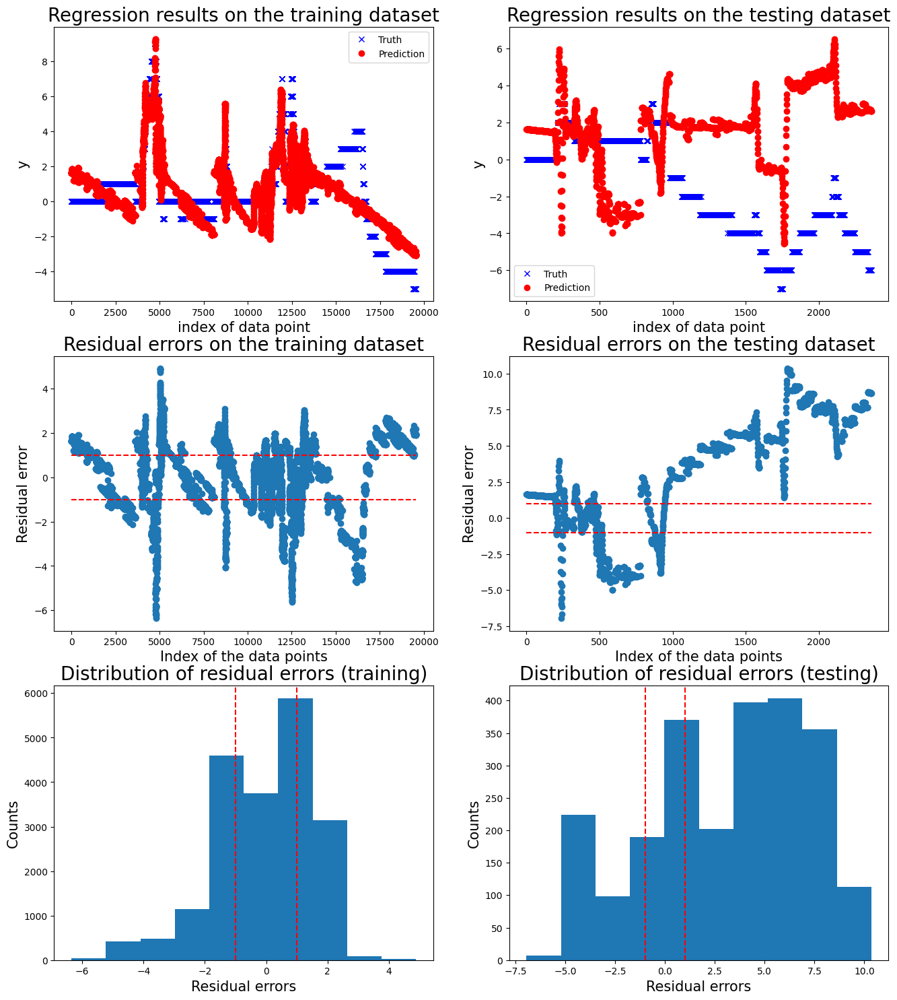

   Max error      RMSE  Exceed boundary rate
0  15.883130  6.454256              0.860932
1   5.436731  2.519032              0.657776
2   8.730328  2.947122              0.390897
3  14.120228  6.954561              0.791402
4  10.348242  5.033718              0.893220


Mean performance metric and standard error:
Max error: 10.9037 +- 4.1851
RMSE: 4.7817 +- 2.0042
Exceed boundary rate: 0.7188 +- 0.2044




In [14]:
from sklearn.linear_model import SGDRegressor 
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from utility import run_cv_one_motor
import warnings

# Ignore warnings.
warnings.filterwarnings('ignore')

# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SGDRegressor(max_iter=1000, tol=1e-3))    # Step 2: Linear Regression
]

# Create the pipeline
pipeline = Pipeline(steps)

# Define hyperparameters to search
param_grid = {
    'regressor__alpha': [0.0001, 0.001, 0.01]  # Inverse of regularization strength
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, scoring='f1', cv=5)

threshold = 1
window_size = 1
sample_step = 1

threshold = 1
window_size = 1
sample_step = 1

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=grid_search, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')


**Summary of the results - Only using features from the current moment**

Please add a table in the end, summarying the results from all the models. Please write a few texts to explain what is the best model you got (including the features and preprocessing you did), its performance, and how could you further improve it.

| Model   | Max error | MRSE | Exceed boundary rate |
|---------|----------|-----------|--------|
| Linear regression |  11.0178 +- 4.0659  |  4.7800 +- 1.9964 |  0.7222 +- 0.1781  |
| Support vector machine regression |  6.8334 +- 4.0857  |  3.2887 +- 2.0937  |  0.6453 +- 0.2304  | 
| Stochastic Gradient descent regression  |  10.9037 +- 4.1851  |  4.7817 +- 2.0042  |  0.7188 +- 0.2044  | 



## Sub-task 2: Include the features in the past

Now, let's consider using the sliding window approach to include the past in the regression model as well. Please have a look at the demo notebook, run your experiment, and report the best models you could have if you apply the sliding window approach.

Model for motor 6:

 New run:

training performance, max error is: 1.3460149201884093
training performance, mean root square error is: 0.18118421609174165
training performance, residual error > 1: 0.5302802048809883%

 New run:

testing performance, max error is: 1.1391281166083154
testing performance, mean root square error is: 0.21986254443002037
testing performance, residual error > 1: 1.0840662712211087%


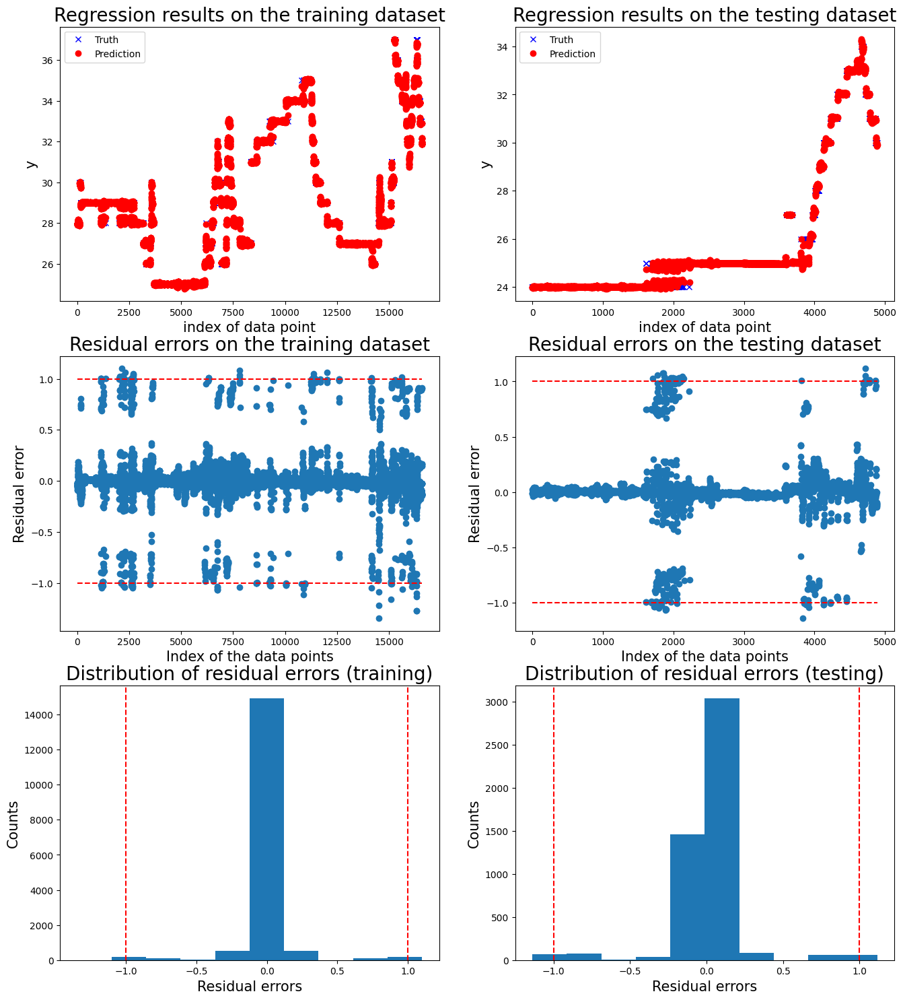


 New run:

training performance, max error is: 1.3311420545217274
training performance, mean root square error is: 0.18317184109956175
training performance, residual error > 1: 0.5363237445148707%

 New run:

testing performance, max error is: 1.1034434567155138
testing performance, mean root square error is: 0.22888168766964723
testing performance, residual error > 1: 1.5537190082644627%


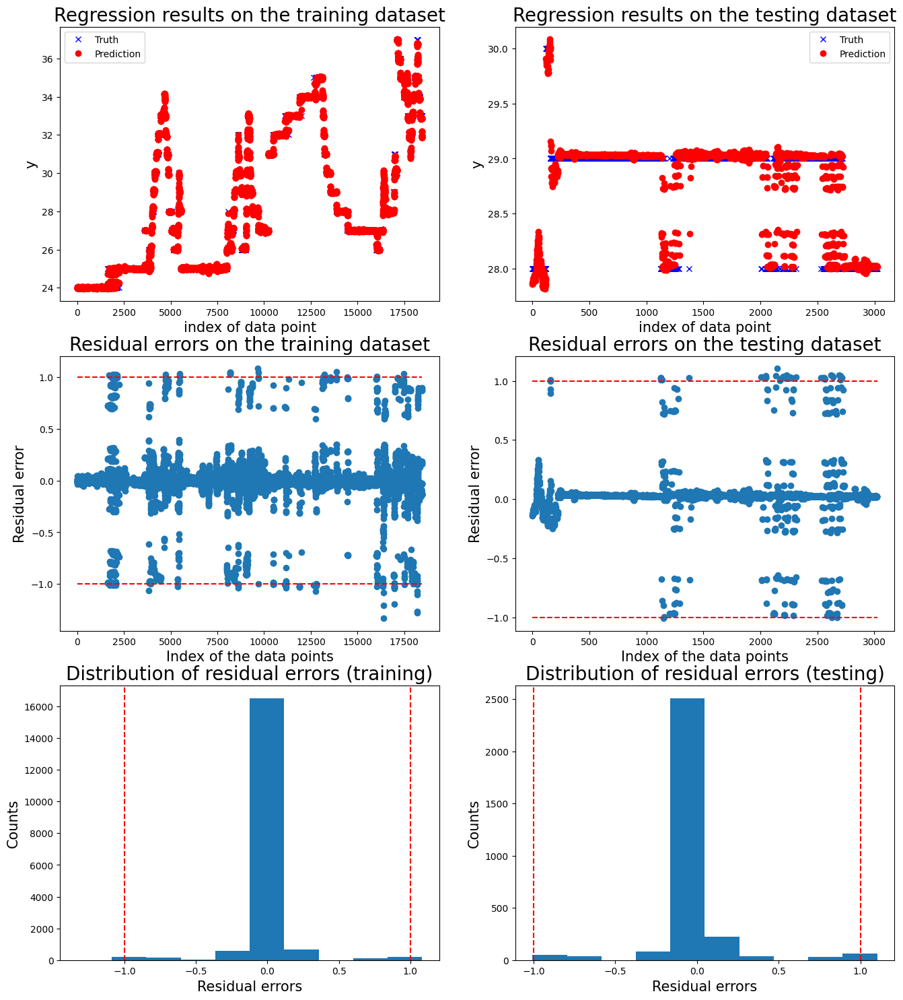


 New run:

training performance, max error is: 1.4030306455442378
training performance, mean root square error is: 0.18903387833948257
training performance, residual error > 1: 0.5618517095658855%

 New run:

testing performance, max error is: 1.168987651572838
testing performance, mean root square error is: 0.21512718213444834
testing performance, residual error > 1: 1.8181818181818181%


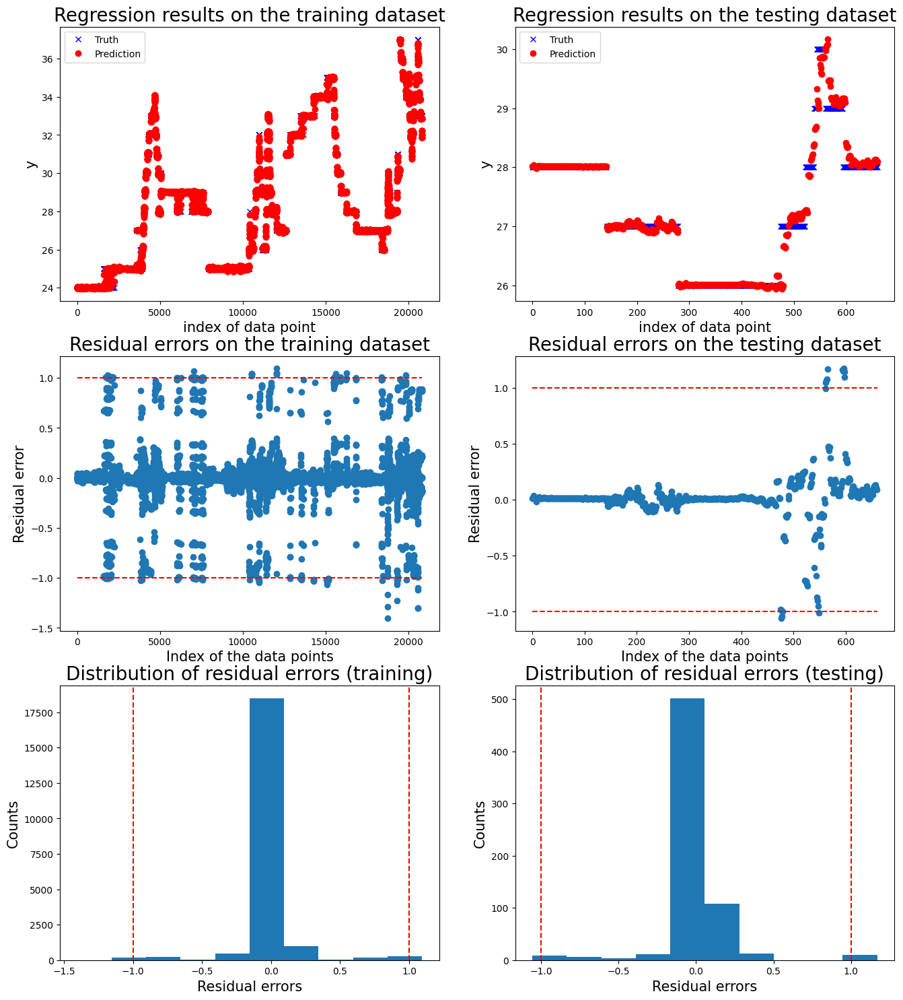


 New run:

training performance, max error is: 1.4137187125328339
training performance, mean root square error is: 0.21740159248826665
training performance, residual error > 1: 0.24891675117544024%

 New run:

testing performance, max error is: 1.2578991562008959
testing performance, mean root square error is: 0.2023075035509254
testing performance, residual error > 1: 1.1093353389113472%


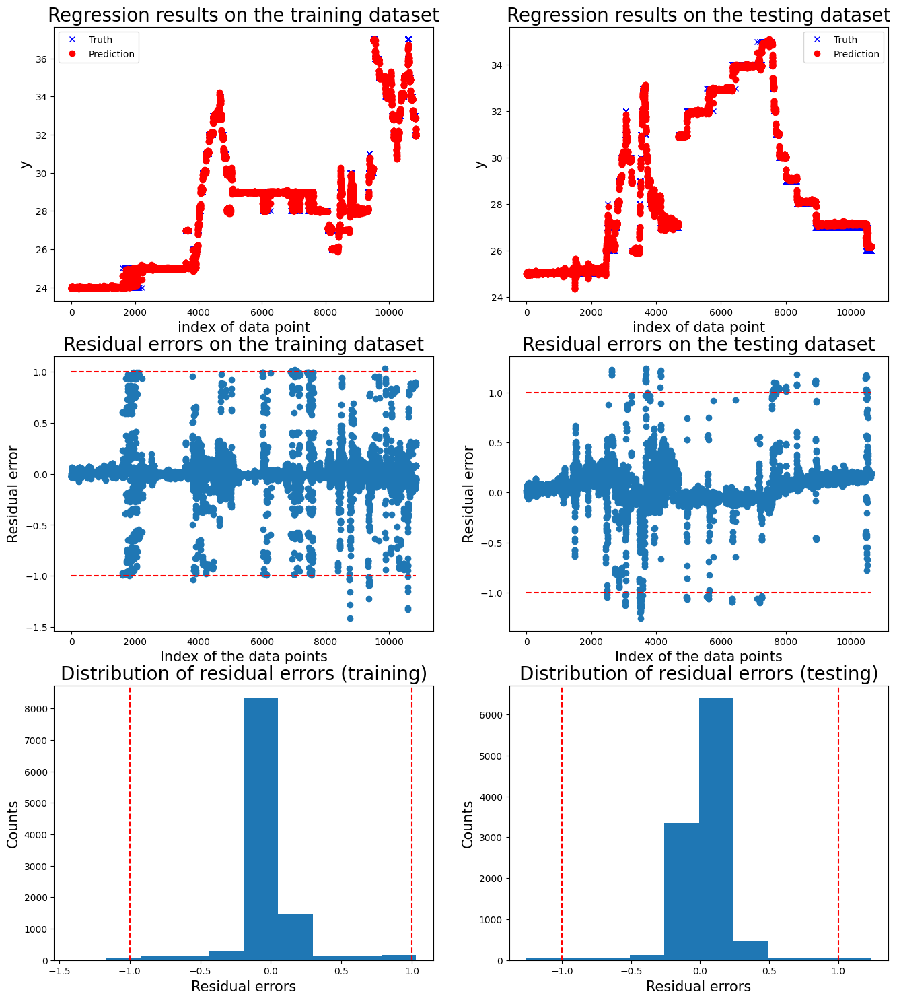


 New run:

training performance, max error is: 1.1095953603779165
training performance, mean root square error is: 0.17899666909713804
training performance, residual error > 1: 0.46327624798292644%

 New run:

testing performance, max error is: 1.45037684355297
testing performance, mean root square error is: 0.29160574696904684
testing performance, residual error > 1: 2.023757149142103%


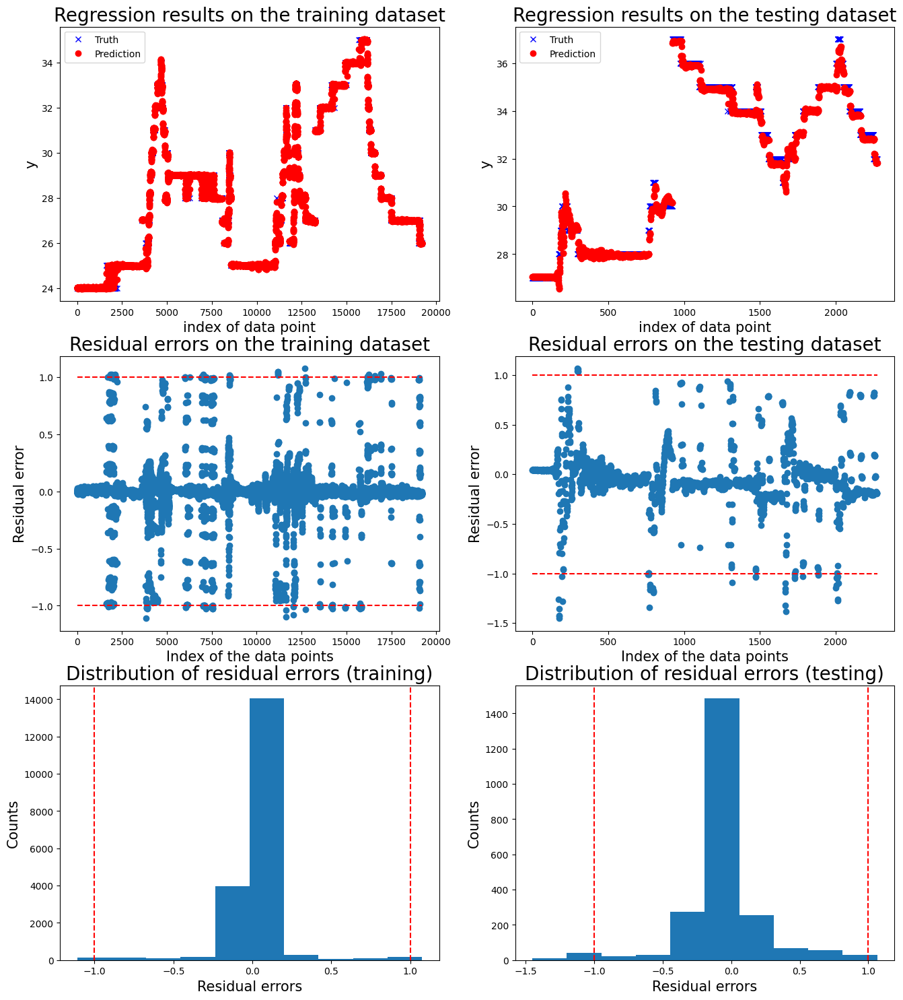

   Max error      RMSE  Exceed boundary rate
0   1.139128  0.219863              0.010841
1   1.103443  0.228882              0.015537
2   1.168988  0.215127              0.018182
3   1.257899  0.202308              0.011093
4   1.450377  0.291606              0.020238


Mean performance metric and standard error:
Max error: 1.2240 +- 0.1389
RMSE: 0.2316 +- 0.0349
Exceed boundary rate: 0.0152 +- 0.0042




In [35]:
from utility import run_cv_one_motor

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

threshold = 1
window_size = 50
sample_step = 5

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=mdl_linear_regreession, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

Model for motor 6:

 New run:

training performance, max error is: 1.322317464849995
training performance, mean root square error is: 0.18223923763817498
training performance, residual error > 1: 0.5603066941905043%

 New run:

testing performance, max error is: 1.0276225746725274
testing performance, mean root square error is: 0.2150796645563433
testing performance, residual error > 1: 0.723036754368347%


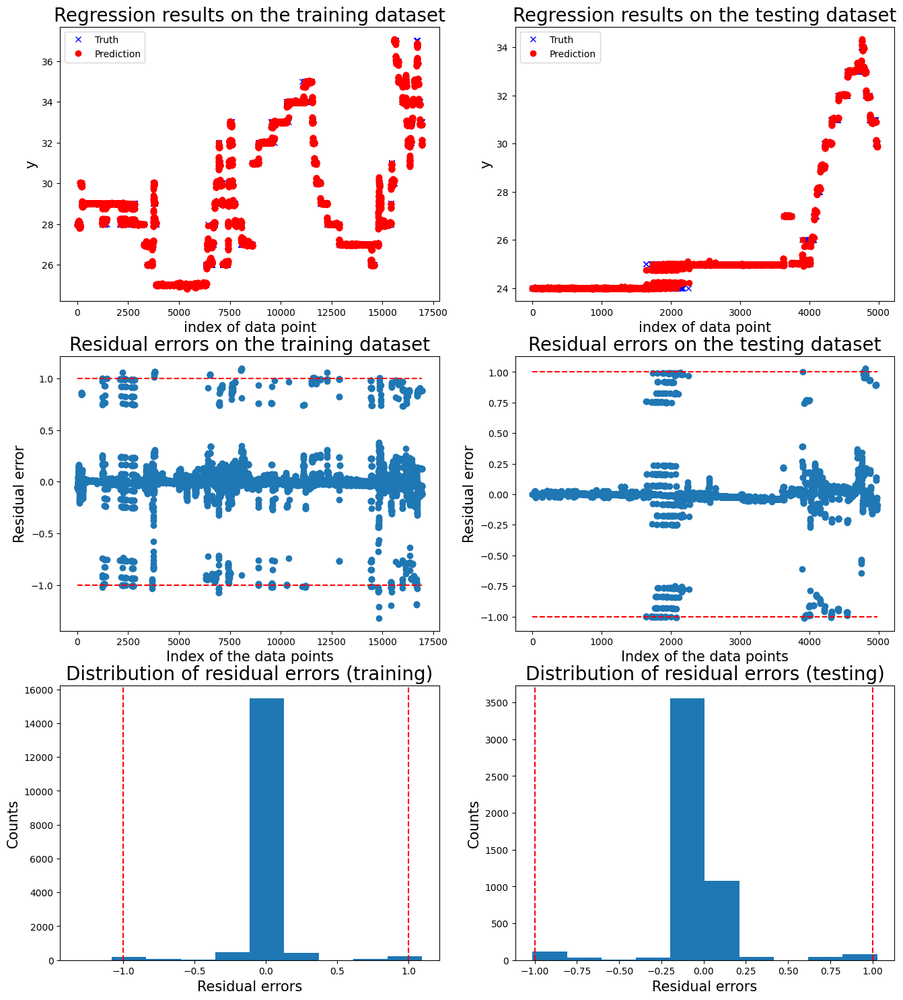


 New run:

training performance, max error is: 1.3142936176534192
training performance, mean root square error is: 0.18369125189763955
training performance, residual error > 1: 0.4622987406344652%

 New run:

testing performance, max error is: 1.0810478673013293
testing performance, mean root square error is: 0.22384344479993304
testing performance, residual error > 1: 1.4125200642054576%


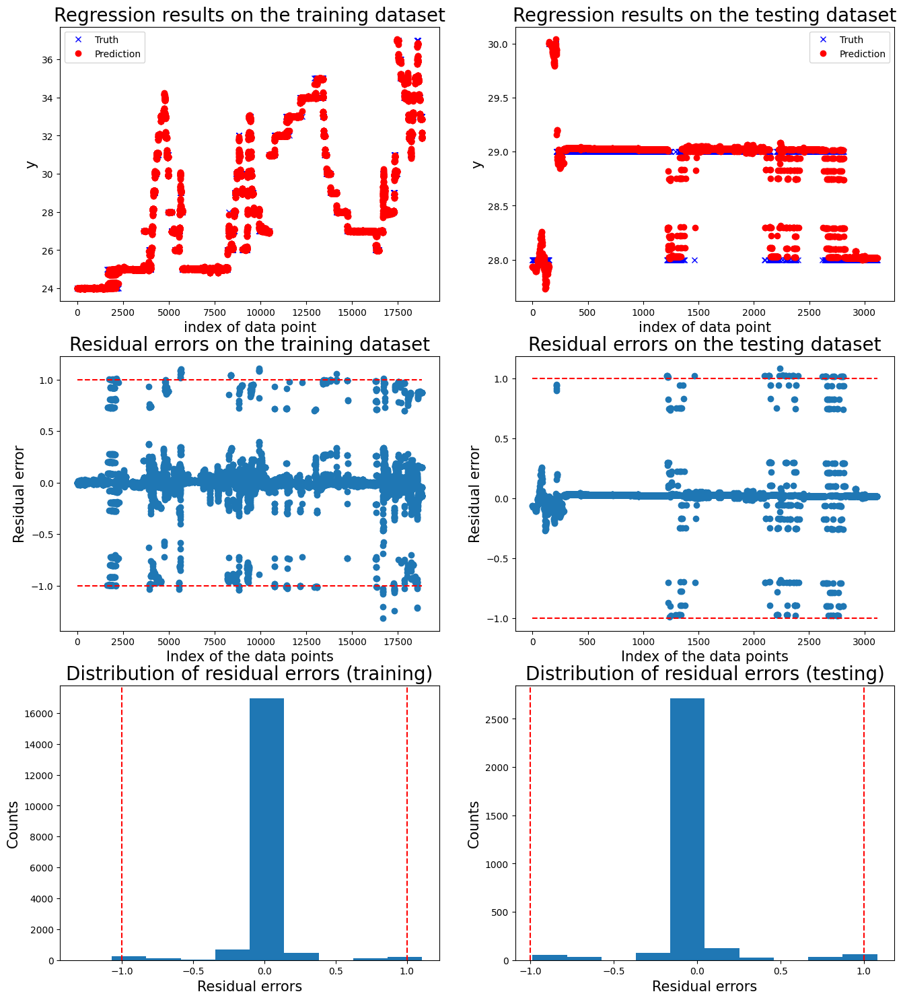


 New run:

training performance, max error is: 1.3842143955816795
training performance, mean root square error is: 0.18903826471849253
training performance, residual error > 1: 0.4531722054380665%

 New run:

testing performance, max error is: 1.164830521794645
testing performance, mean root square error is: 0.20614165297078627
testing performance, residual error > 1: 2.1333333333333333%


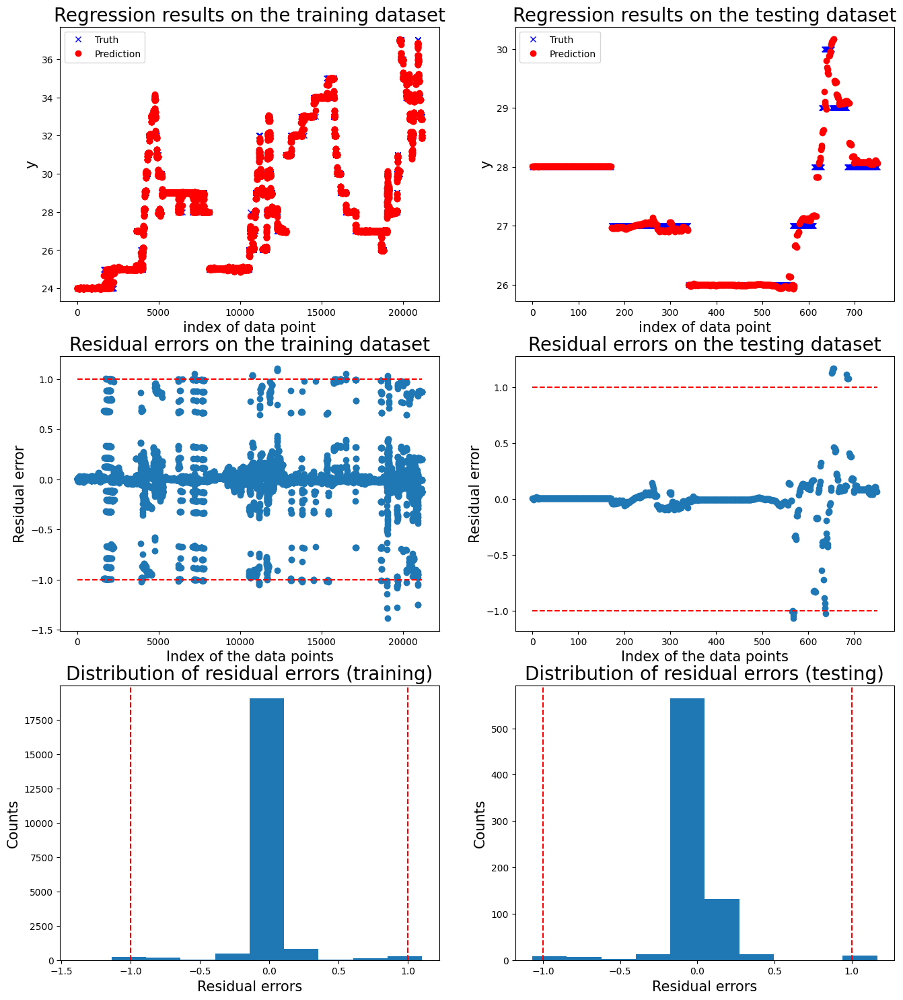


 New run:

training performance, max error is: 1.3377050612604293
training performance, mean root square error is: 0.21793160192320787
training performance, residual error > 1: 0.276612831266173%

 New run:

testing performance, max error is: 1.177588444888677
testing performance, mean root square error is: 0.18459183843954274
testing performance, residual error > 1: 0.885615735993288%


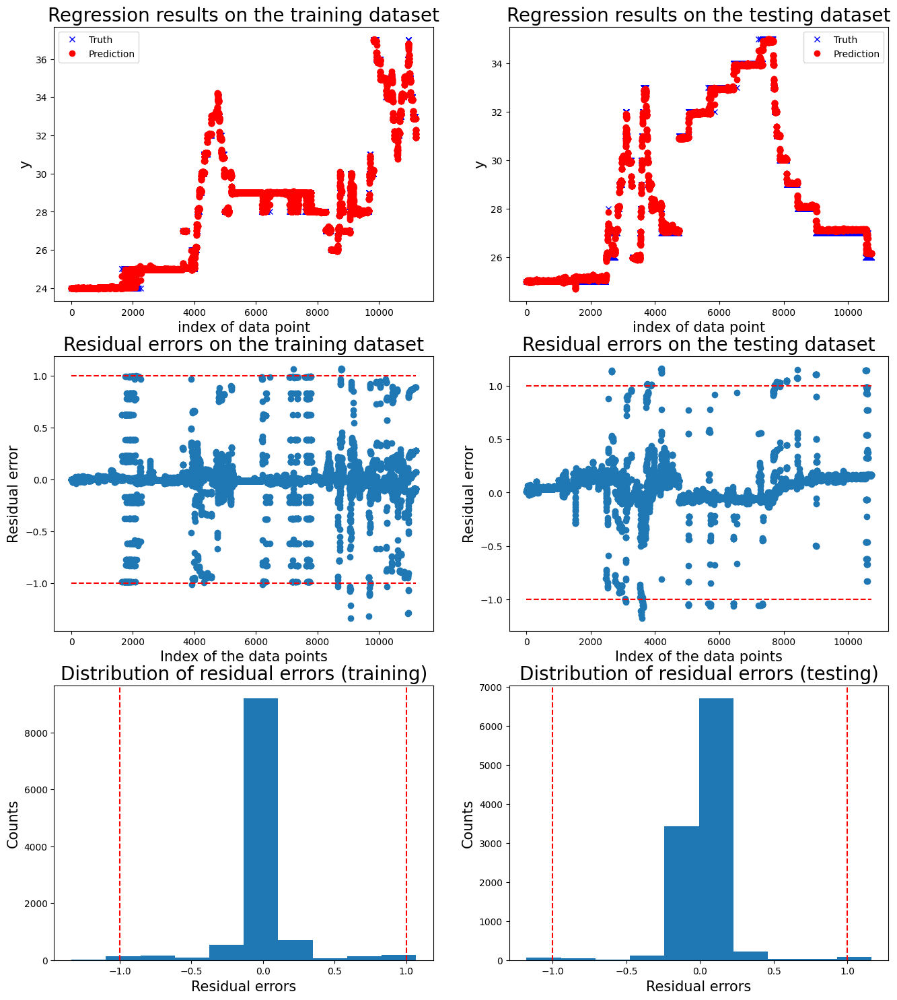


 New run:

training performance, max error is: 1.0971666966379452
training performance, mean root square error is: 0.17951004083396543
training performance, residual error > 1: 0.4598640846149916%

 New run:

testing performance, max error is: 1.4031350347512443
testing performance, mean root square error is: 0.27440186718442267
testing performance, residual error > 1: 1.7774016081252644%


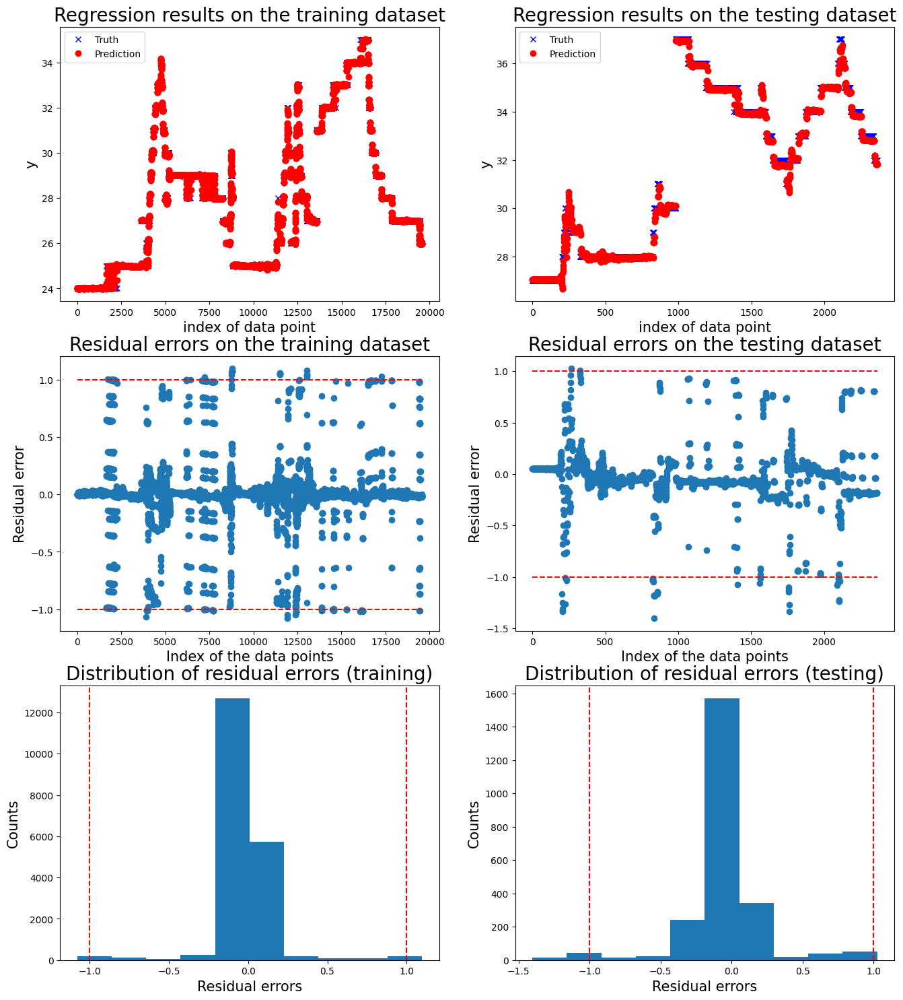

   Max error      RMSE  Exceed boundary rate
0   1.027623  0.215080              0.007230
1   1.081048  0.223843              0.014125
2   1.164831  0.206142              0.021333
3   1.177588  0.184592              0.008856
4   1.403135  0.274402              0.017774


Mean performance metric and standard error:
Max error: 1.1708 +- 0.1437
RMSE: 0.2208 +- 0.0333
Exceed boundary rate: 0.0139 +- 0.0059




In [38]:
from utility import run_cv_one_motor

threshold = 1
window_size = 20
sample_step = 5

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=mdl_linear_regreession, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

Model for motor 6:

 New run:

training performance, max error is: 1.9736822529616873
training performance, mean root square error is: 0.2232604087967822
training performance, residual error > 1: 0.6877149109096593%

 New run:

testing performance, max error is: 1.2388828604402065
testing performance, mean root square error is: 0.2539255994717916
testing performance, residual error > 1: 1.3504958852078497%


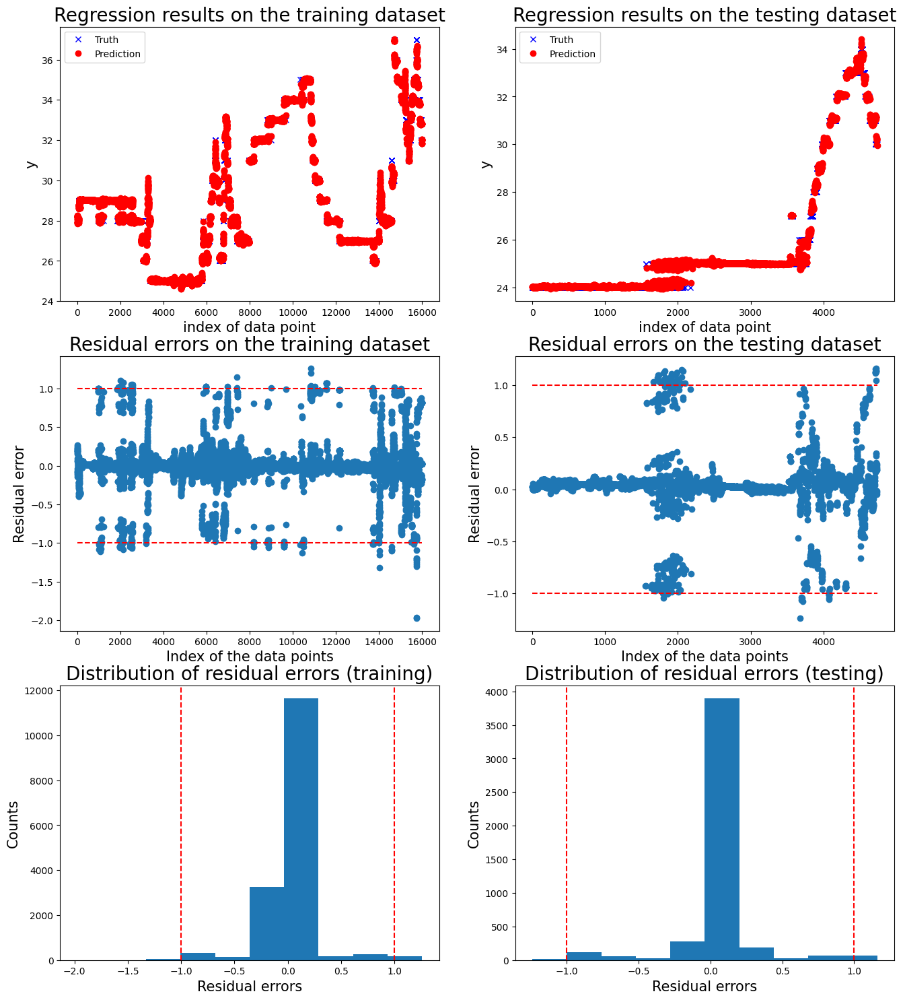


 New run:

training performance, max error is: 1.9338148686712984
training performance, mean root square error is: 0.22357172424293856
training performance, residual error > 1: 0.6439330309647797%

 New run:

testing performance, max error is: 1.0945495240295884
testing performance, mean root square error is: 0.26001477032204084
testing performance, residual error > 1: 1.6695652173913043%


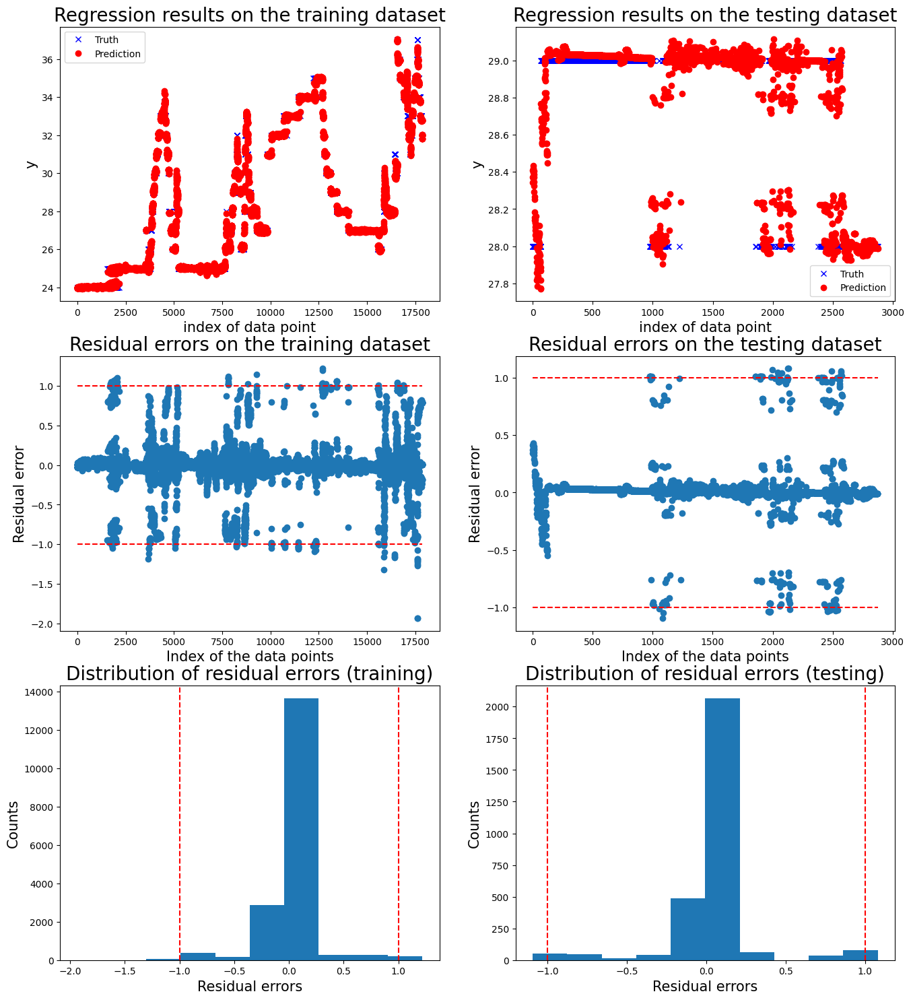


 New run:

training performance, max error is: 1.901900911920265
training performance, mean root square error is: 0.22689178643875882
training performance, residual error > 1: 0.7960838607594938%

 New run:

testing performance, max error is: 1.1420670664011148
testing performance, mean root square error is: 0.30649537973452434
testing performance, residual error > 1: 4.901960784313726%


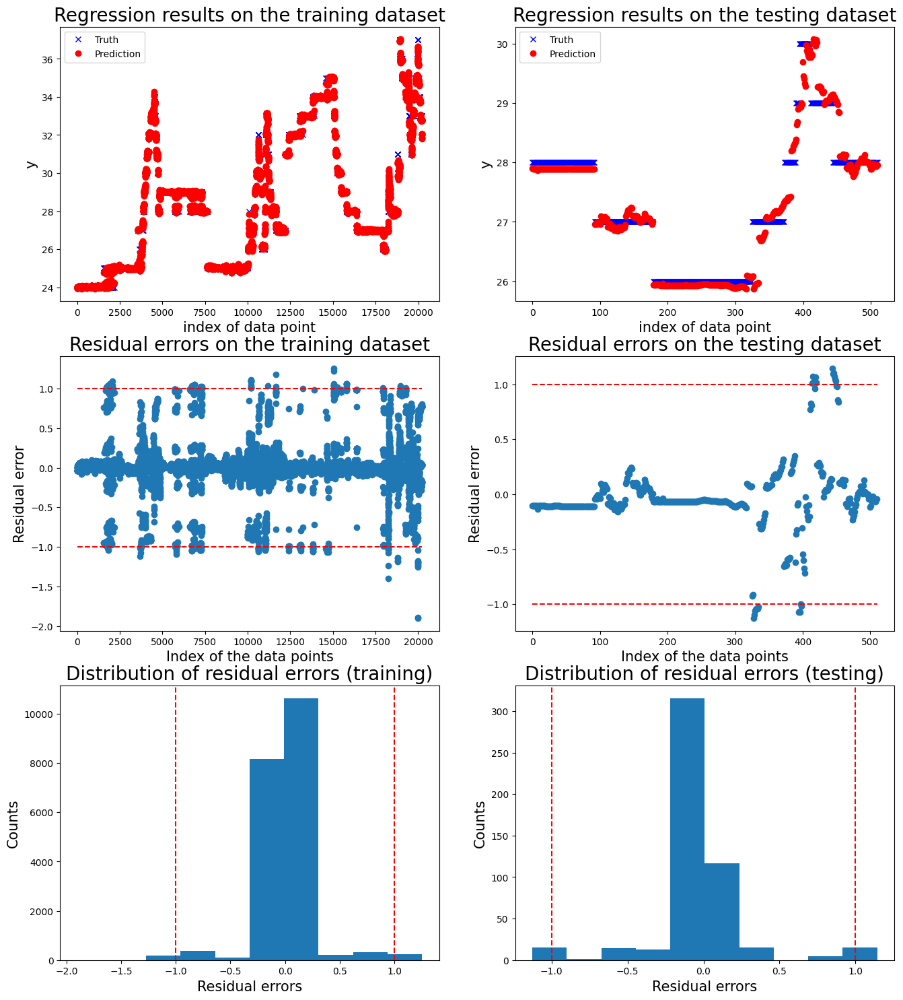


 New run:

training performance, max error is: 1.8217160952995926
training performance, mean root square error is: 0.24716449836503032
training performance, residual error > 1: 0.3122865228847468%

 New run:

testing performance, max error is: 1.7020274751055133
testing performance, mean root square error is: 0.33212077285640396
testing performance, residual error > 1: 2.2599408791837514%


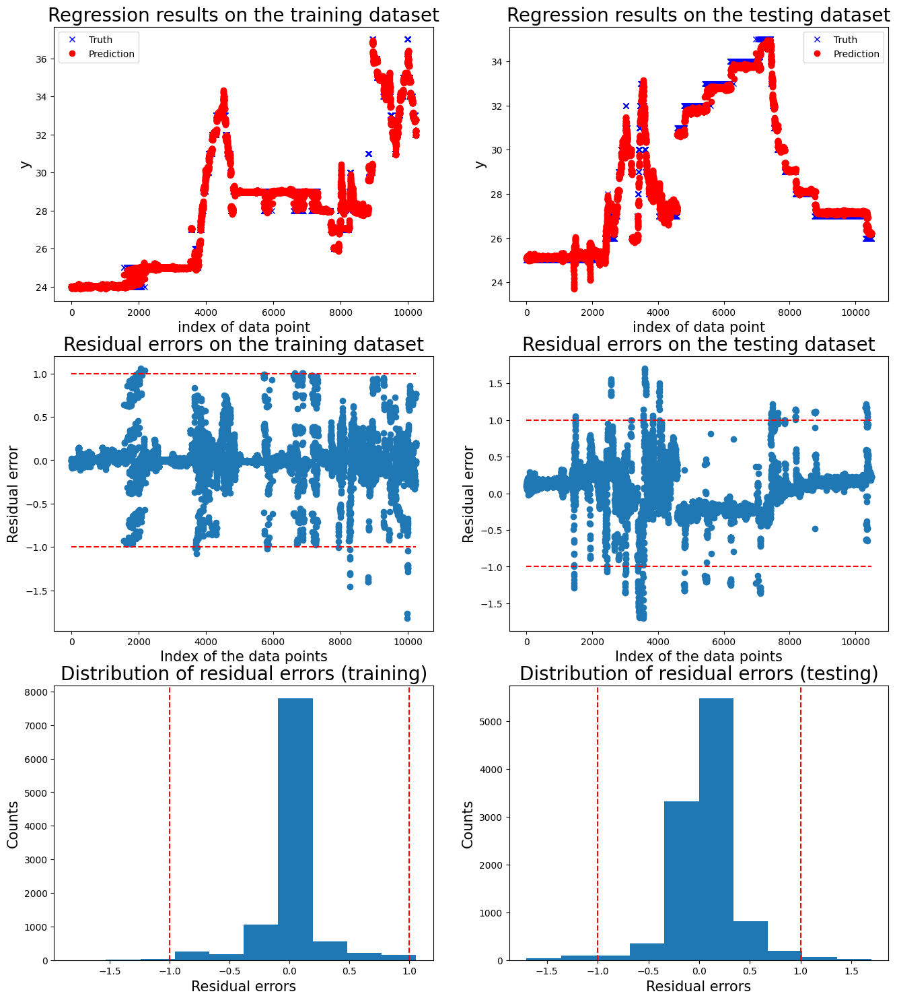


 New run:

training performance, max error is: 1.279054902151941
training performance, mean root square error is: 0.21225722946929237
training performance, residual error > 1: 0.6017946375799259%

 New run:

testing performance, max error is: 2.0033286172322846
testing performance, mean root square error is: 0.39638887884247676
testing performance, residual error > 1: 2.4493641073951955%


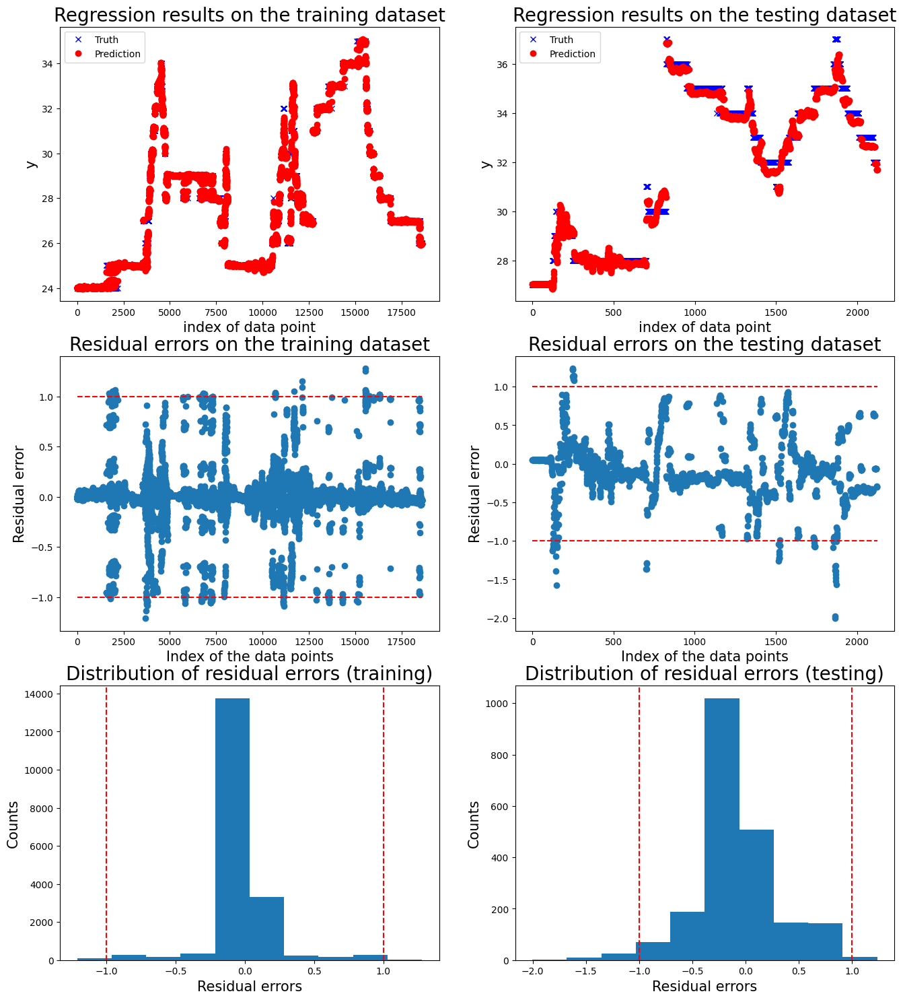

   Max error      RMSE  Exceed boundary rate
0   1.238883  0.253926              0.013505
1   1.094550  0.260015              0.016696
2   1.142067  0.306495              0.049020
3   1.702027  0.332121              0.022599
4   2.003329  0.396389              0.024494


Mean performance metric and standard error:
Max error: 1.4362 +- 0.3983
RMSE: 0.3098 +- 0.0583
Exceed boundary rate: 0.0253 +- 0.0140




In [39]:
from utility import run_cv_one_motor

threshold = 1
window_size = 100
sample_step = 10

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=mdl_linear_regreession, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')

Model for motor 6:

 New run:

training performance, max error is: 1.202471309847855
training performance, mean root square error is: 0.2082717968411072
training performance, residual error > 1: 0.07833684844832782%

 New run:

testing performance, max error is: 2.540413057439043
testing performance, mean root square error is: 1.0358770973775902
testing performance, residual error > 1: 40.089997954591944%


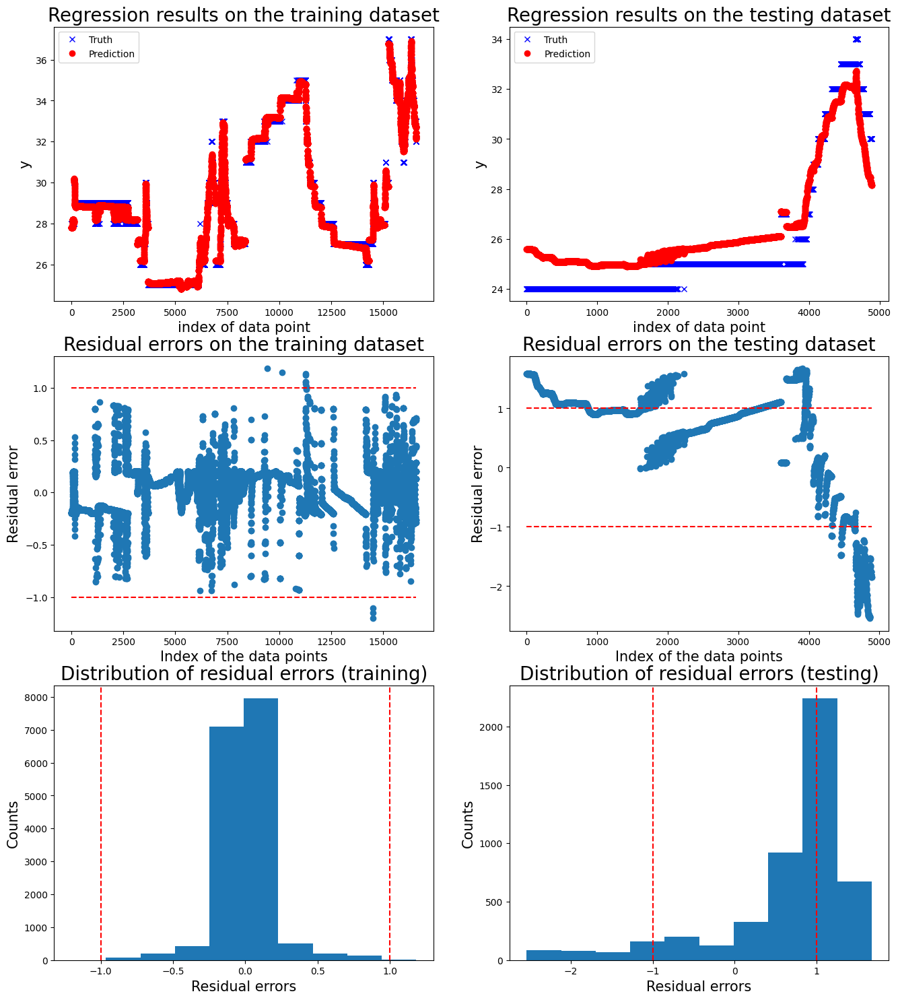


 New run:

training performance, max error is: 1.2618186529207556
training performance, mean root square error is: 0.2018392319802242
training performance, residual error > 1: 0.09751340809361286%

 New run:

testing performance, max error is: 1.183322262616997
testing performance, mean root square error is: 0.7469120049715517
testing performance, residual error > 1: 2.3801652892561984%


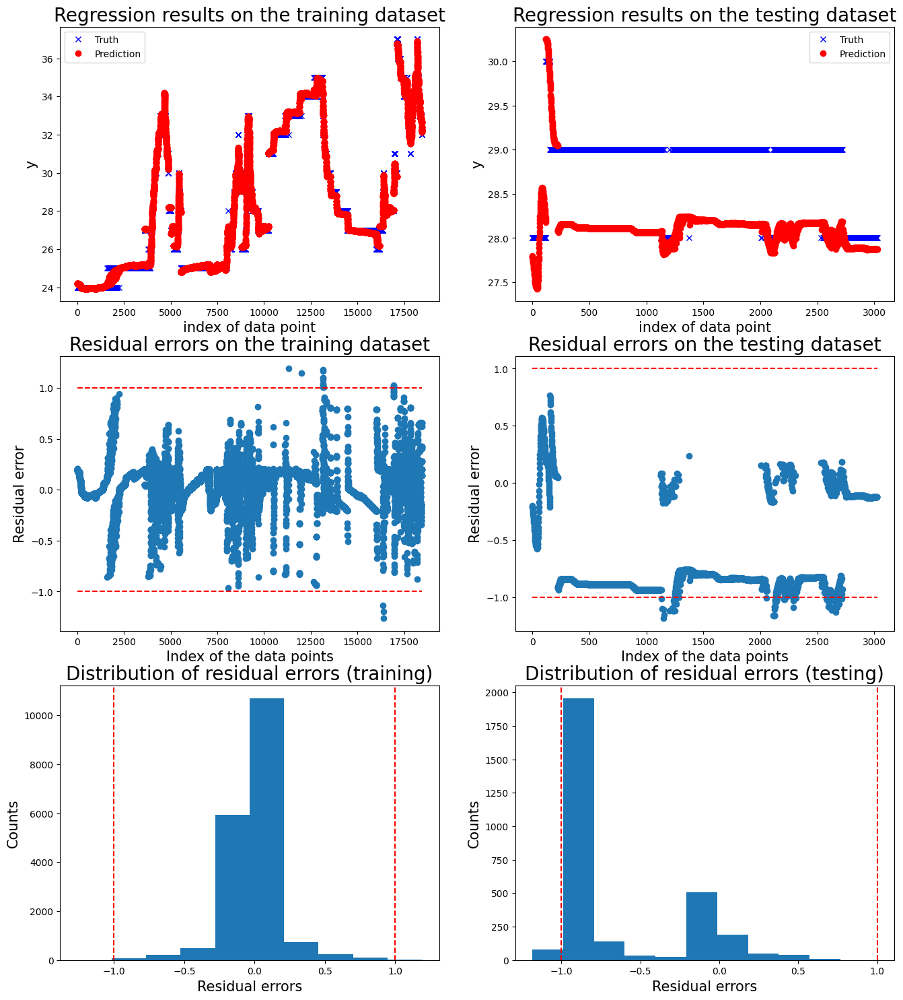


 New run:

training performance, max error is: 1.208271922038577
training performance, mean root square error is: 0.20801929275907816
training performance, residual error > 1: 0.06242796772954284%

 New run:

testing performance, max error is: 2.38083275446931
testing performance, mean root square error is: 1.450410587527268
testing performance, residual error > 1: 39.39393939393939%


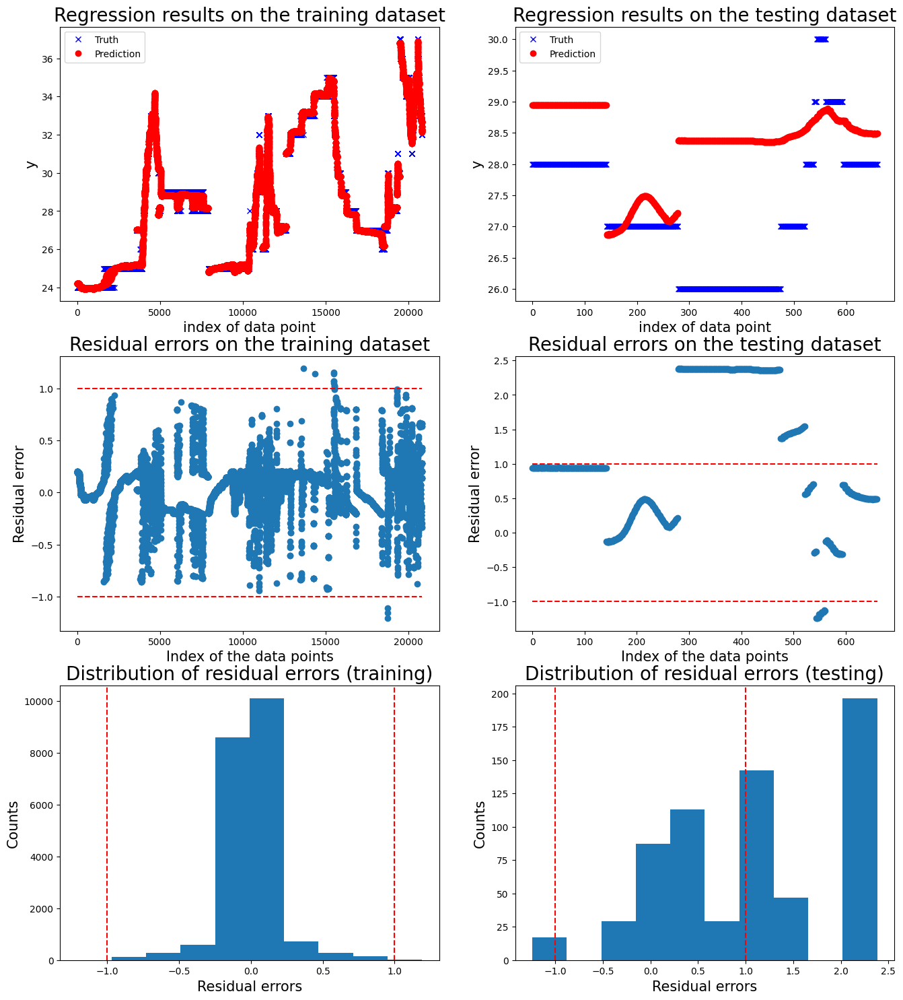


 New run:

training performance, max error is: 1.2649639225311624
training performance, mean root square error is: 0.2350074801379405
training performance, residual error > 1: 0.027657416797271135%

 New run:

testing performance, max error is: 4.3644942695167686
testing performance, mean root square error is: 1.8476179794436942
testing performance, residual error > 1: 67.0771834163768%


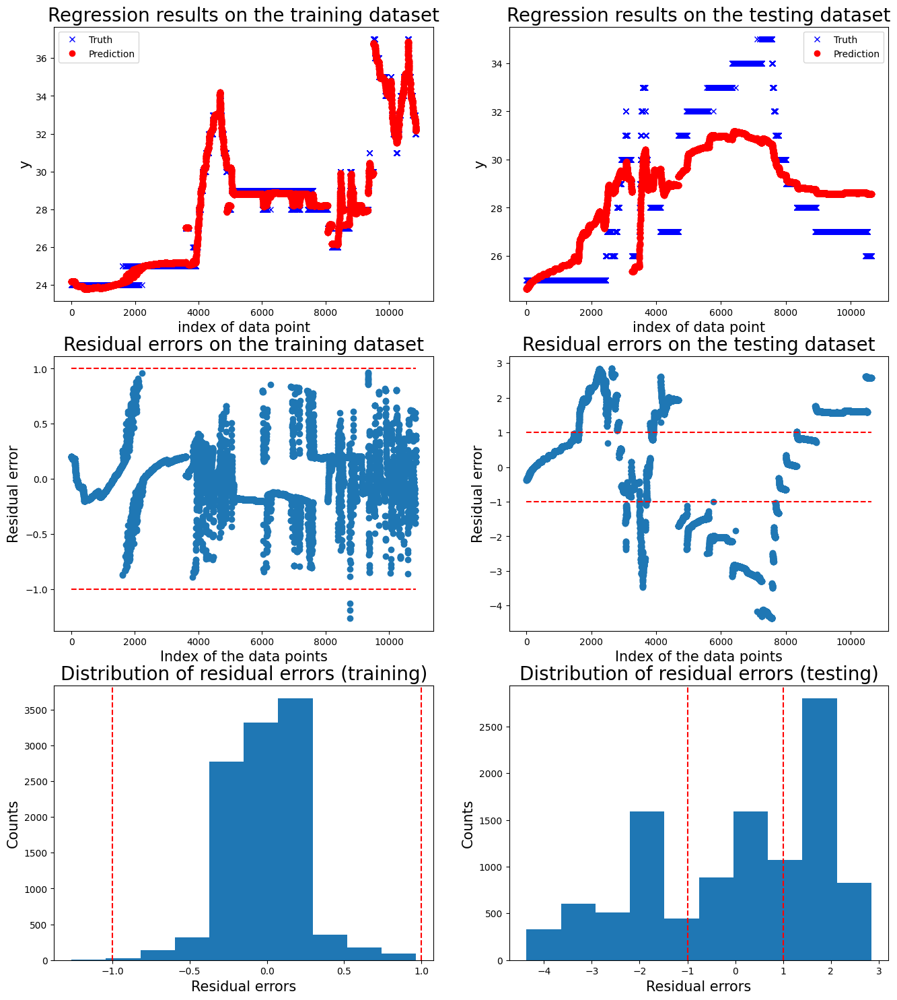


 New run:

training performance, max error is: 1.1789949745237251
training performance, mean root square error is: 0.2008128363877981
training performance, residual error > 1: 0.0624642132111811%

 New run:

testing performance, max error is: 6.807258713876326
testing performance, mean root square error is: 3.2844209932301633
testing performance, residual error > 1: 66.12406511218654%


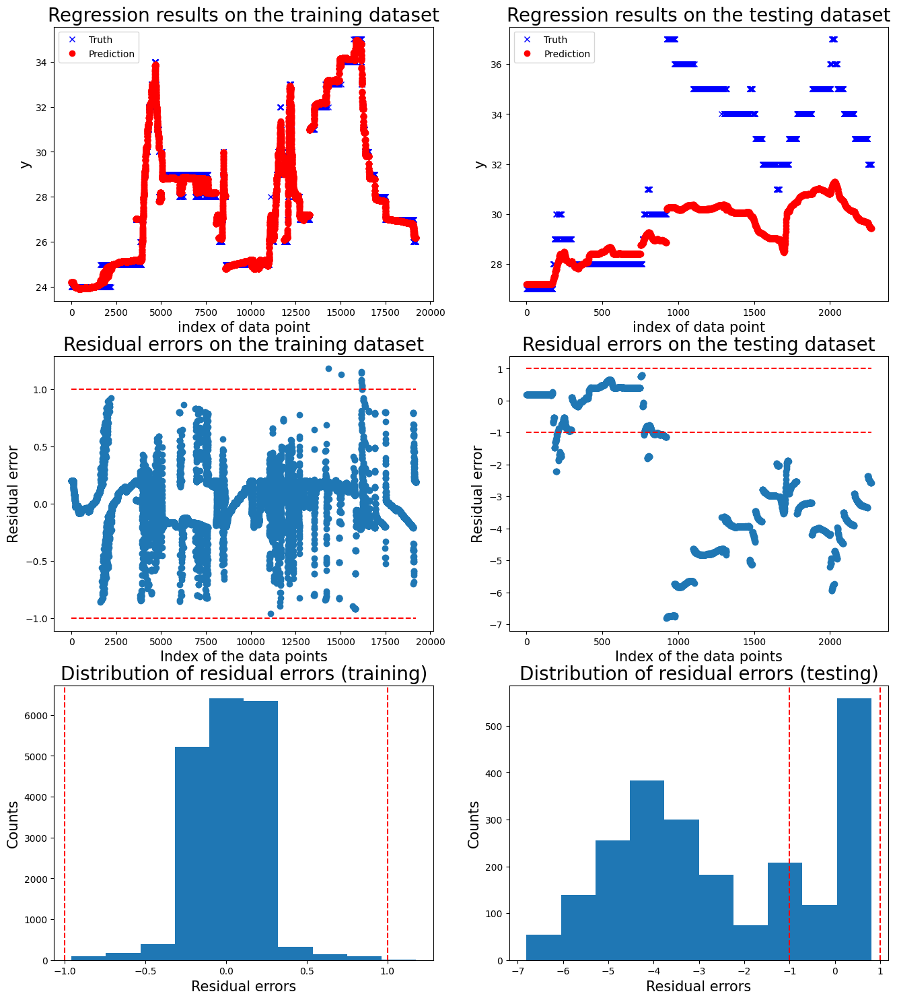

   Max error      RMSE  Exceed boundary rate
0   2.540413  1.035877              0.400900
1   1.183322  0.746912              0.023802
2   2.380833  1.450411              0.393939
3   4.364494  1.847618              0.670772
4   6.807259  3.284421              0.661241


Mean performance metric and standard error:
Max error: 3.4553 +- 2.1918
RMSE: 1.6730 +- 0.9925
Exceed boundary rate: 0.4301 +- 0.2639




In [36]:
from sklearn.svm import SVR 
from sklearn.model_selection import GridSearchCV
import warnings

# Ignore warnings.
warnings.filterwarnings('ignore')

# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SVR(C=1.0, epsilon=0.2))    # Step 2: Linear Regression
]

# Create the pipeline
pipeline = Pipeline(steps)

# Define hyperparameters to search
param_grid = {
    'regressor__C': [1, 10, 100]  # Inverse of regularization strength
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, scoring='f1', cv=5)

threshold = 1
window_size = 50
sample_step = 5

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=grid_search, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')


Model for motor 6:

 New run:

training performance, max error is: 1.5739797085927307
training performance, mean root square error is: 0.20025993668051886
training performance, residual error > 1: 0.7592648388068696%

 New run:

testing performance, max error is: 1.1067035495828748
testing performance, mean root square error is: 0.21261495398706234
testing performance, residual error > 1: 0.6136224176723257%


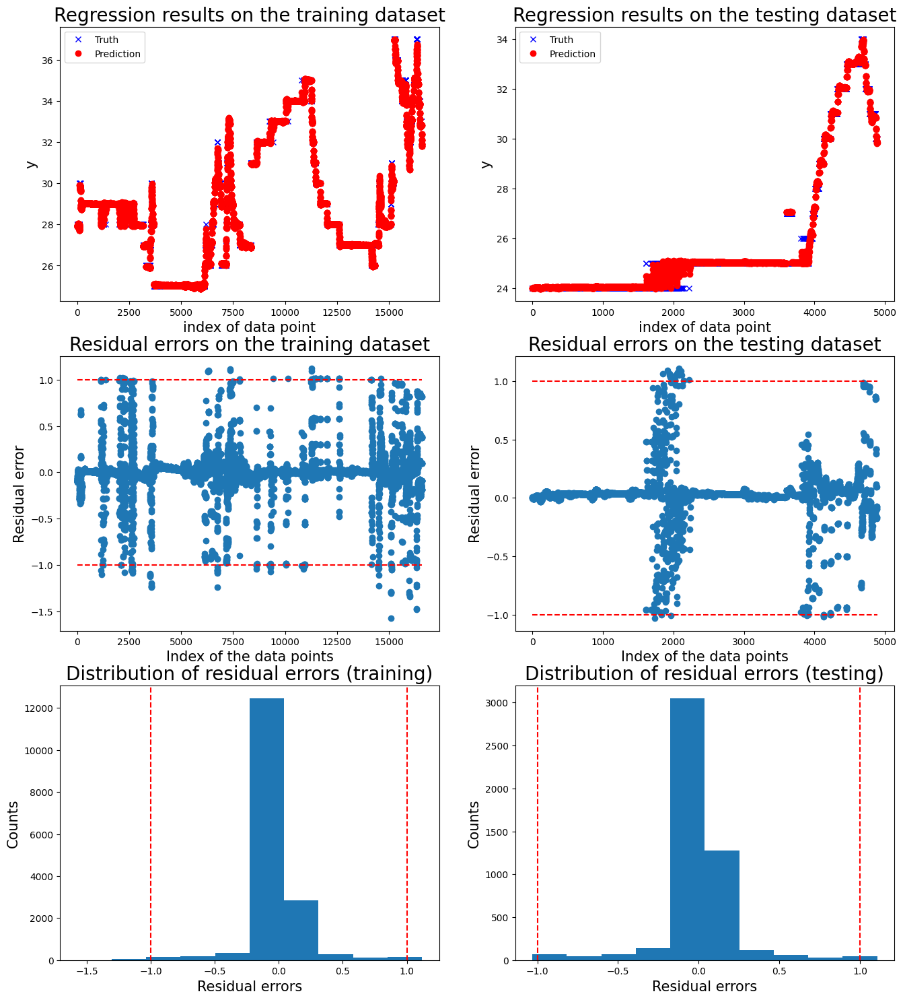


 New run:

training performance, max error is: 1.5417628514690023
training performance, mean root square error is: 0.2019745355238138
training performance, residual error > 1: 0.6771764450945338%

 New run:

testing performance, max error is: 1.0456791540852706
testing performance, mean root square error is: 0.22105547683403634
testing performance, residual error > 1: 1.090909090909091%


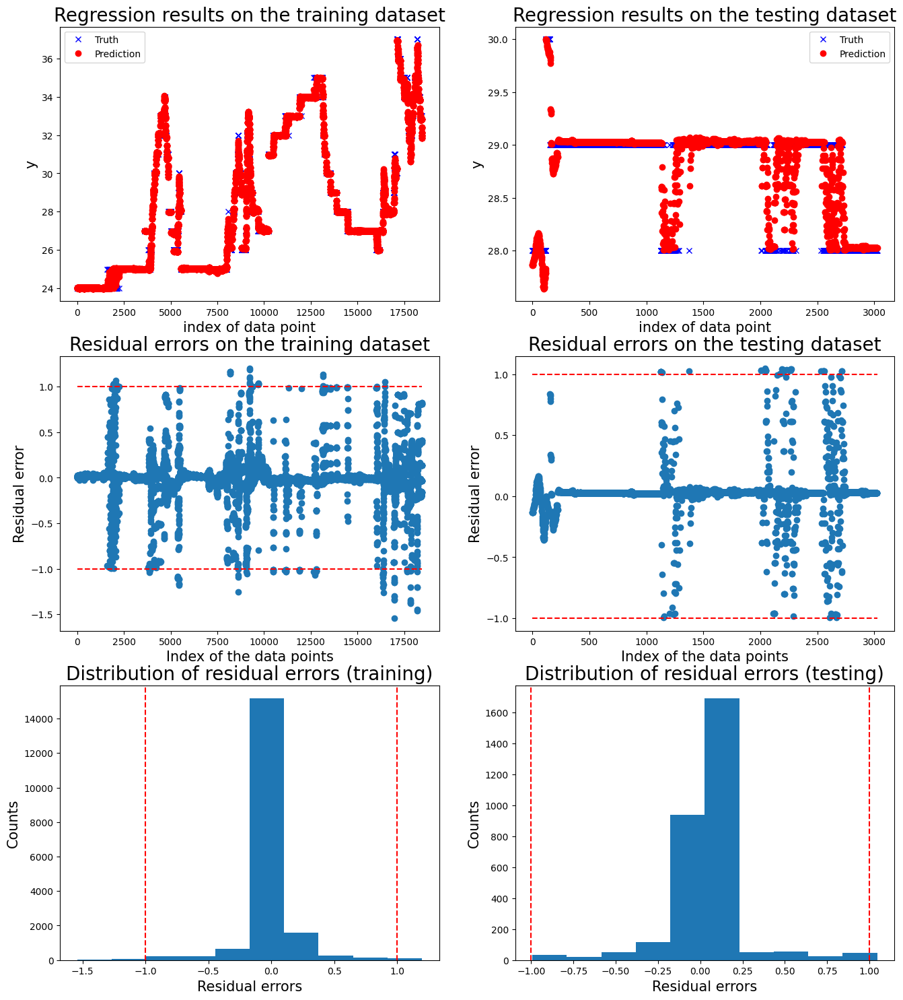


 New run:

training performance, max error is: 1.5720575965940355
training performance, mean root square error is: 0.20531915550477553
training performance, residual error > 1: 0.7635420668459469%

 New run:

testing performance, max error is: 1.290156338137983
testing performance, mean root square error is: 0.2816694373188184
testing performance, residual error > 1: 1.8181818181818181%


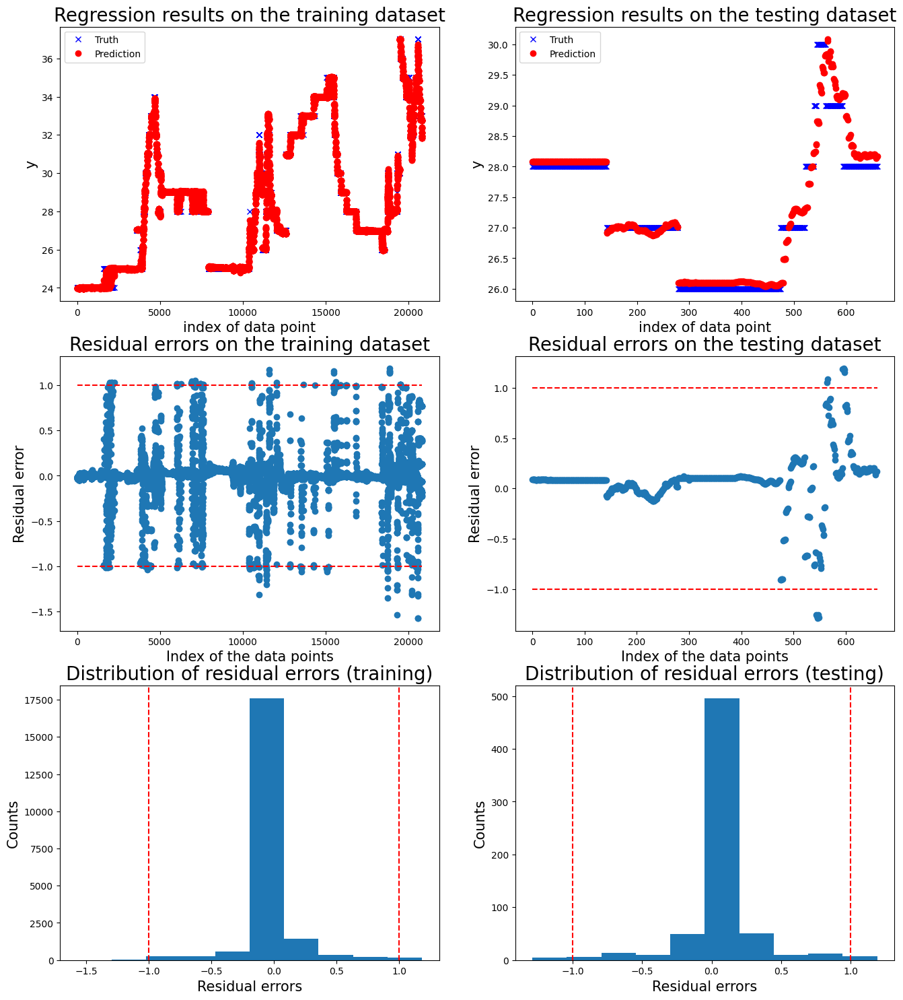


 New run:

training performance, max error is: 1.652705899801603
training performance, mean root square error is: 0.24231375111954603
training performance, residual error > 1: 0.6176823084723887%

 New run:

testing performance, max error is: 1.603998022886266
testing performance, mean root square error is: 0.261178306646089
testing performance, residual error > 1: 1.306759424649807%


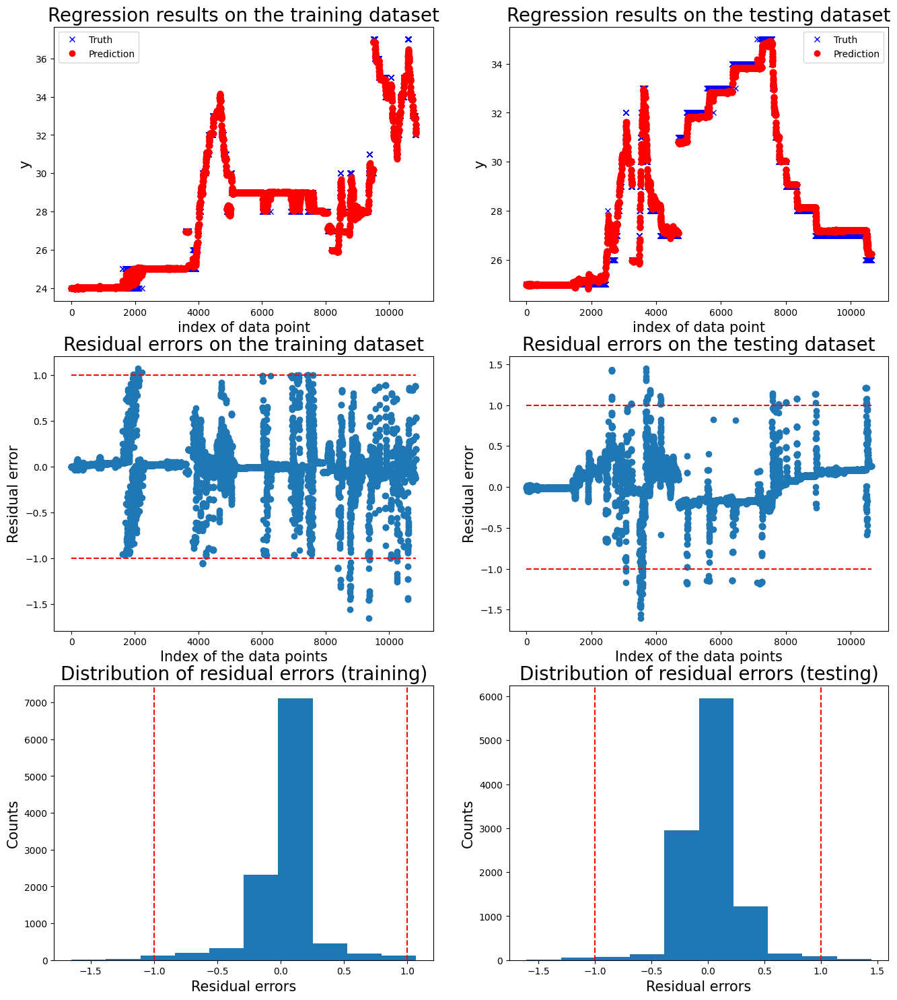


 New run:

training performance, max error is: 1.2511162866830503
training performance, mean root square error is: 0.18973163539031465
training performance, residual error > 1: 0.47368695018478996%

 New run:

testing performance, max error is: 1.5661472544731083
testing performance, mean root square error is: 0.32965518105797265
testing performance, residual error > 1: 2.1997360316761987%


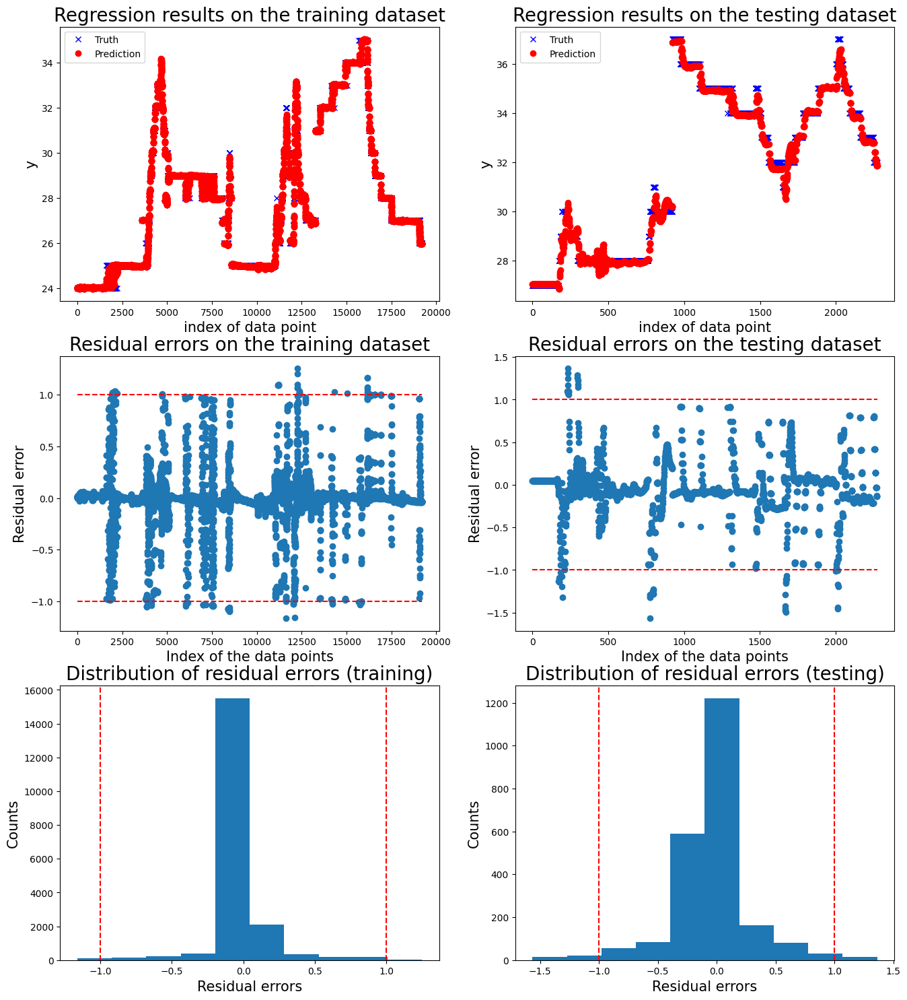

   Max error      RMSE  Exceed boundary rate
0   1.106704  0.212615              0.006136
1   1.045679  0.221055              0.010909
2   1.290156  0.281669              0.018182
3   1.603998  0.261178              0.013068
4   1.566147  0.329655              0.021997


Mean performance metric and standard error:
Max error: 1.3225 +- 0.2563
RMSE: 0.2612 +- 0.0476
Exceed boundary rate: 0.0141 +- 0.0062




In [37]:
from sklearn.linear_model import SGDRegressor 
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from utility import run_cv_one_motor
import warnings

# Ignore warnings.
warnings.filterwarnings('ignore')

# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SGDRegressor(max_iter=1000, tol=1e-3))    # Step 2: Linear Regression
]

# Create the pipeline
pipeline = Pipeline(steps)

# Define hyperparameters to search
param_grid = {
    'regressor__alpha': [0.0001, 0.001, 0.01]  # Inverse of regularization strength
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, scoring='f1', cv=5)

threshold = 1
window_size = 50
sample_step = 5

df_perf = run_cv_one_motor(motor_idx=6, df_data=df_data_smoothing, mdl=grid_search, 
            feature_list=feature_list_selected, n_fold=5, 
            threshold=threshold, window_size=window_size, sample_step=sample_step, mdl_type='reg')


**Summary of the results - Sliding window**

Please add a table in the end, summarying the results from all the models. Please write a few texts to explain what is the best model you got (including the features and preprocessing you did), its performance, and how could you further improve it.

| Model   (also report parameters like window_size, sample_step, prediction_lead_time, etc.) | Max error | MRSE | Exceed boundary rate |
|---------|----------|-----------|--------|
| Linear Regression (window size 50, sample step 5) |  1.2240 +- 0.1389  |  0.2316 +- 0.0349  |  0.0152 +- 0.0042  | 
| Support Vector Machine Regression |  3.4553 +- 2.1918  |  1.6730 +- 0.9925   |  0.4301 +- 0.2639  | 
| Stochastic Gradient Descent Regression |  1.3225 +- 0.2563  |   0.2612 +- 0.0476   | 0.0141 +- 0.0062  | 


# Task 2 Fault detection based on regression model

In this exercise, we use the dataset that contains the failure of motor 6 to test the fault detection model based on the regression model trained before. 

[This notebook](demo_FaultDetectReg.ipynb) presents a demonstration of how to use the provided supporting function to develop fault detection model based on the regression model. Please have a look at this notebook, and try to improve the performance of the baseline model.

#### linear regression

Model for motor 6:


100%|██████████| 1/1 [00:04<00:00,  4.17s/it]



 New run:

testing performance, max error is: 3.9321065748313564
testing performance, mean root square error is: 1.3683783928986168
testing performance, residual error > 0.9: 60.84855805526197%

 New run:

testing performance, accuracy is: 0.4535708893250793
testing performance, precision is: 0.12779156327543426
testing performance, recall: 0.8319870759289176
testing performance, F1: 0.2215530221553022




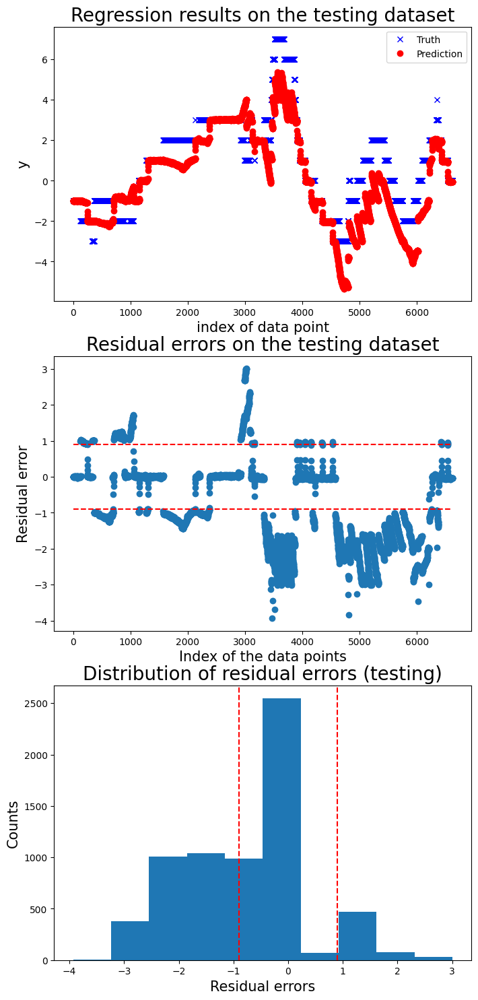

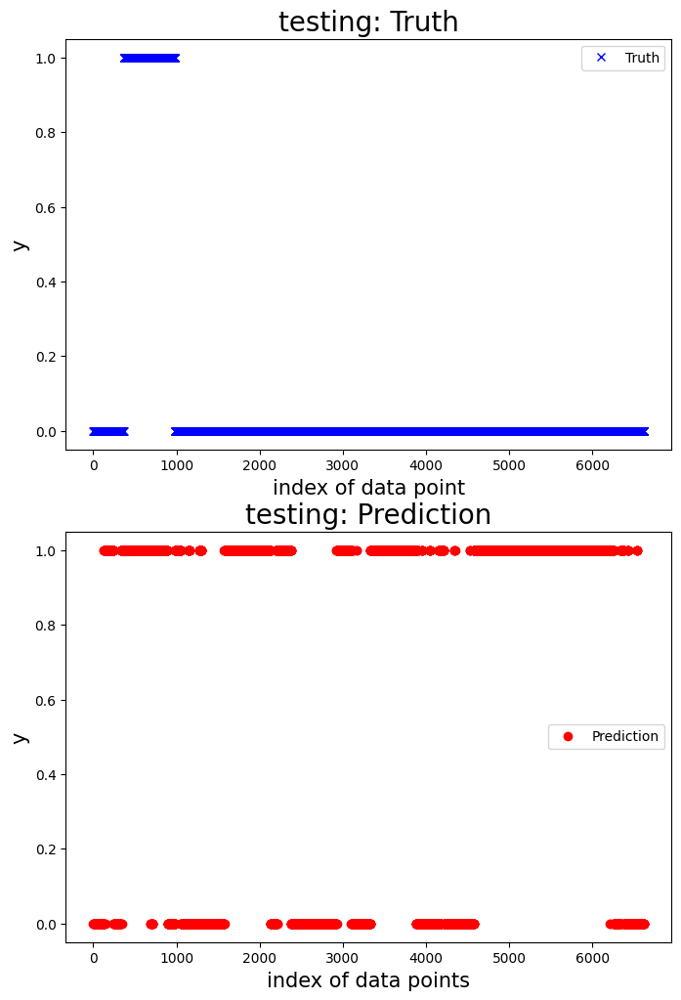

100%|██████████| 1/1 [00:00<00:00,  8.51it/s]



 New run:

testing performance, max error is: 3.996588124449299
testing performance, mean root square error is: 1.5614757286782537
testing performance, residual error > 0.9: 47.02970297029702%

 New run:

testing performance, accuracy is: 0.8564356435643564
testing performance, precision is: 0.7789473684210526
testing performance, recall: 0.9024390243902439
testing performance, F1: 0.8361581920903954




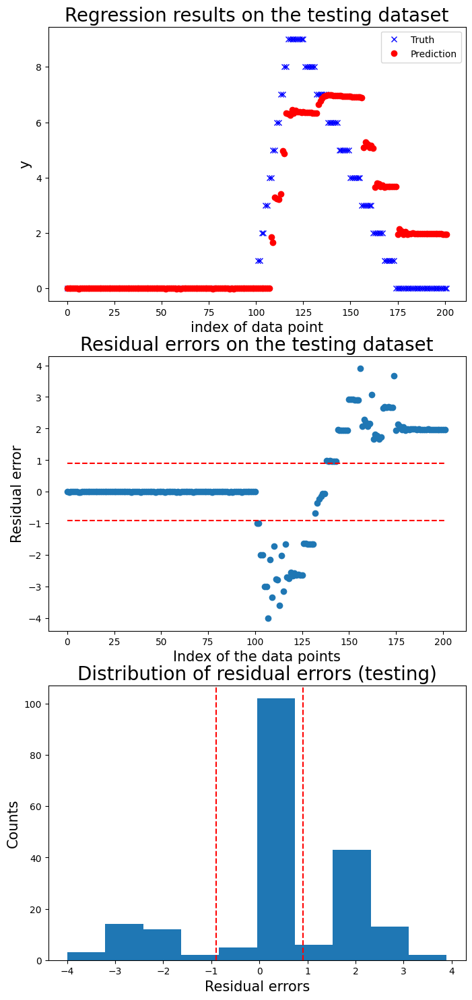

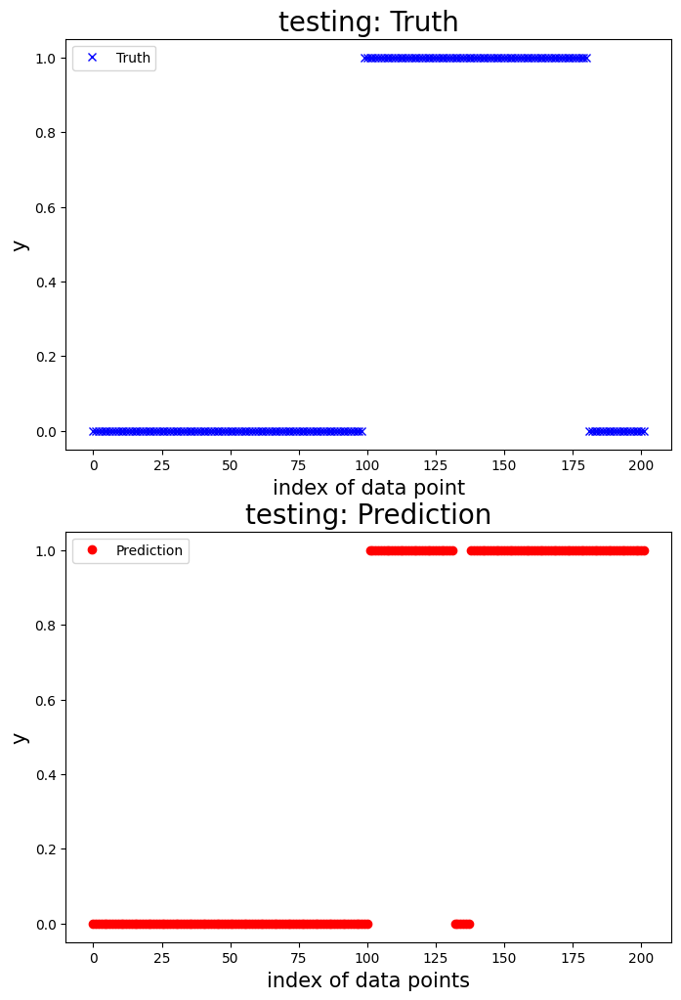

100%|██████████| 1/1 [00:00<00:00,  3.26it/s]



 New run:

testing performance, max error is: 3.0000292168613014
testing performance, mean root square error is: 1.1287302034254325
testing performance, residual error > 0.9: 41.431261770244824%

 New run:

testing performance, accuracy is: 0.6854990583804144
testing performance, precision is: 0.41363636363636364
testing performance, recall: 0.7054263565891473
testing performance, F1: 0.5214899713467048




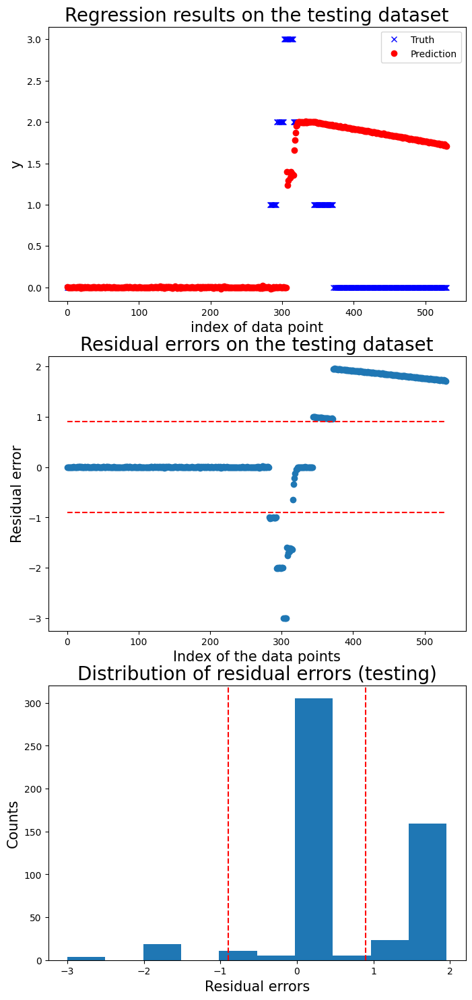

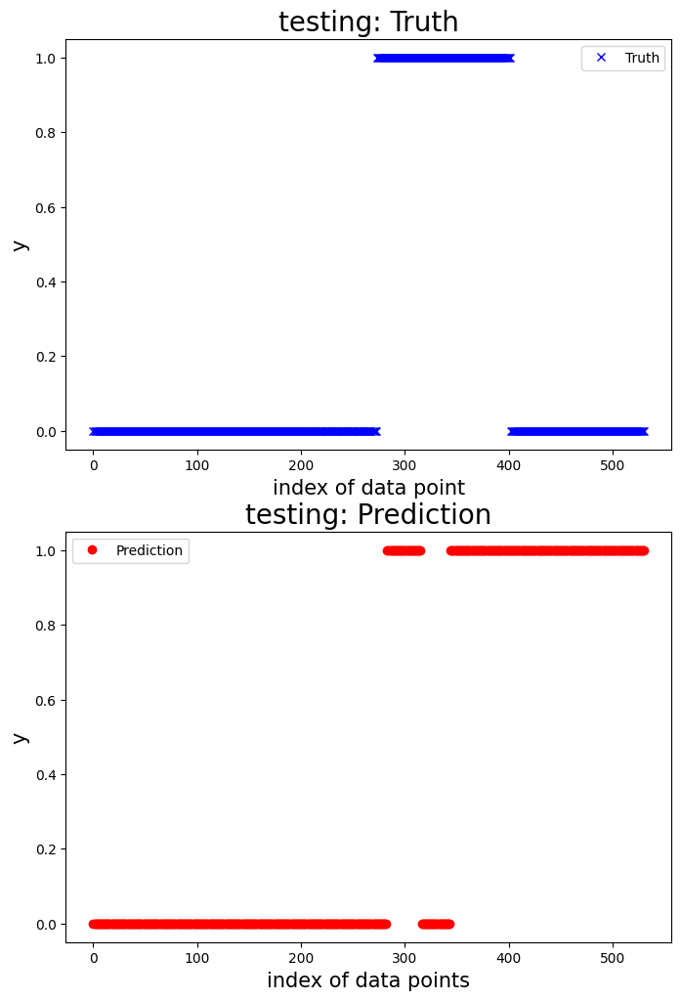

100%|██████████| 1/1 [00:00<00:00,  1.65it/s]



 New run:

testing performance, max error is: 2.019767356958299
testing performance, mean root square error is: 0.23861546004930928
testing performance, residual error > 0.9: 3.4482758620689653%

 New run:

testing performance, accuracy is: 0.9724137931034482
testing performance, precision is: 1.0
testing performance, recall: 0.5555555555555556
testing performance, F1: 0.7142857142857143




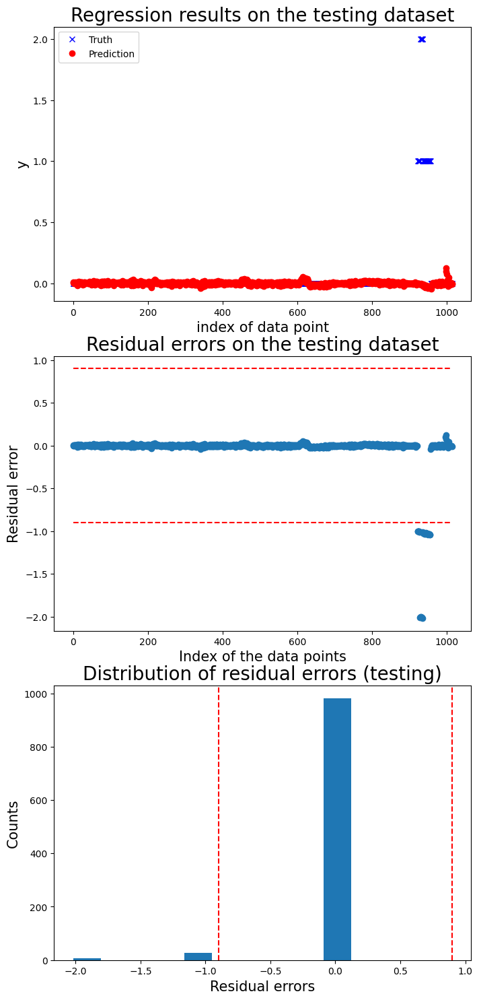

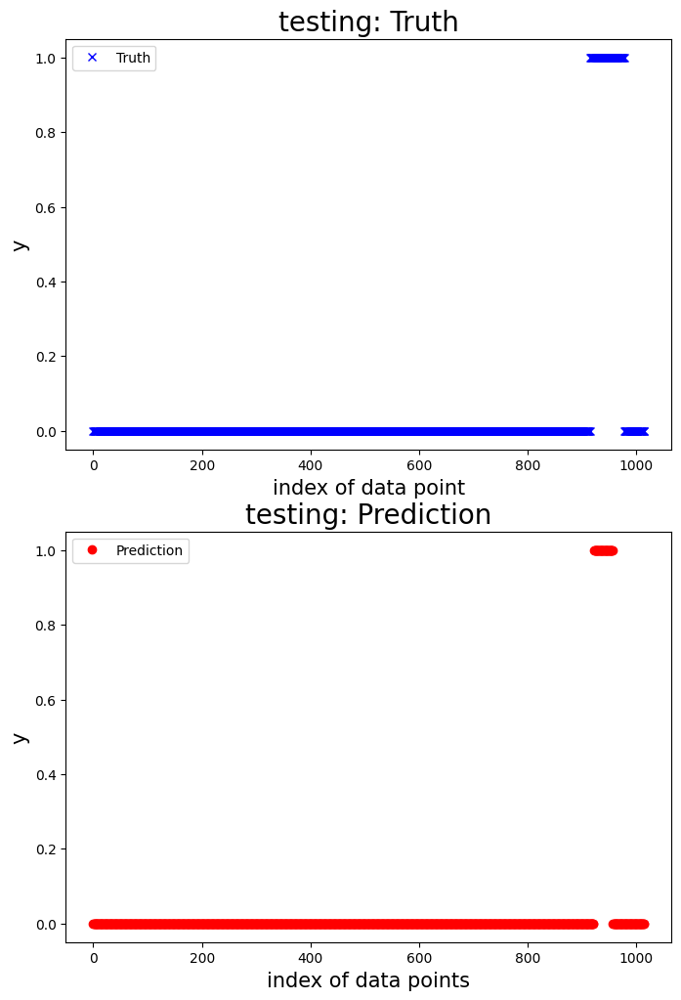

100%|██████████| 1/1 [00:00<00:00,  1.56it/s]



 New run:

testing performance, max error is: 4.001718008181203
testing performance, mean root square error is: 1.3843416872522183
testing performance, residual error > 0.9: 49.01785714285714%

 New run:

testing performance, accuracy is: 0.7589285714285714
testing performance, precision is: 0.5701275045537341
testing performance, recall: 0.9020172910662824
testing performance, F1: 0.6986607142857143




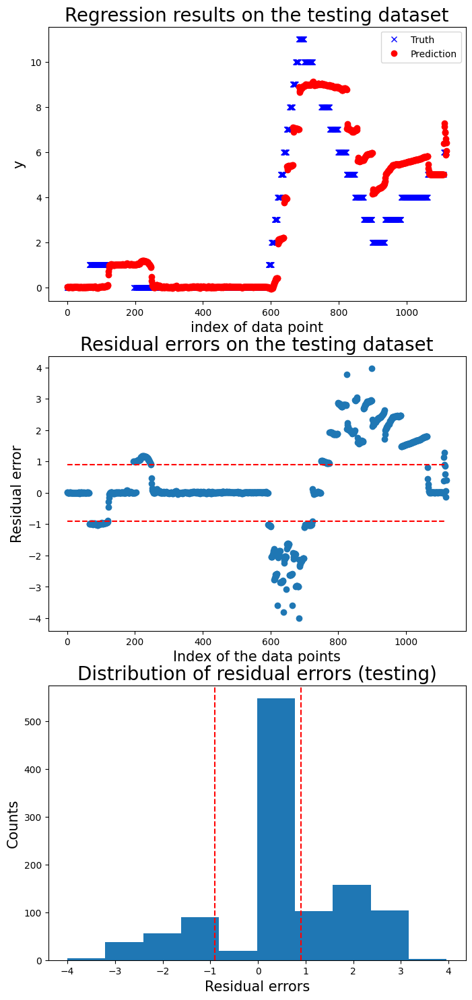

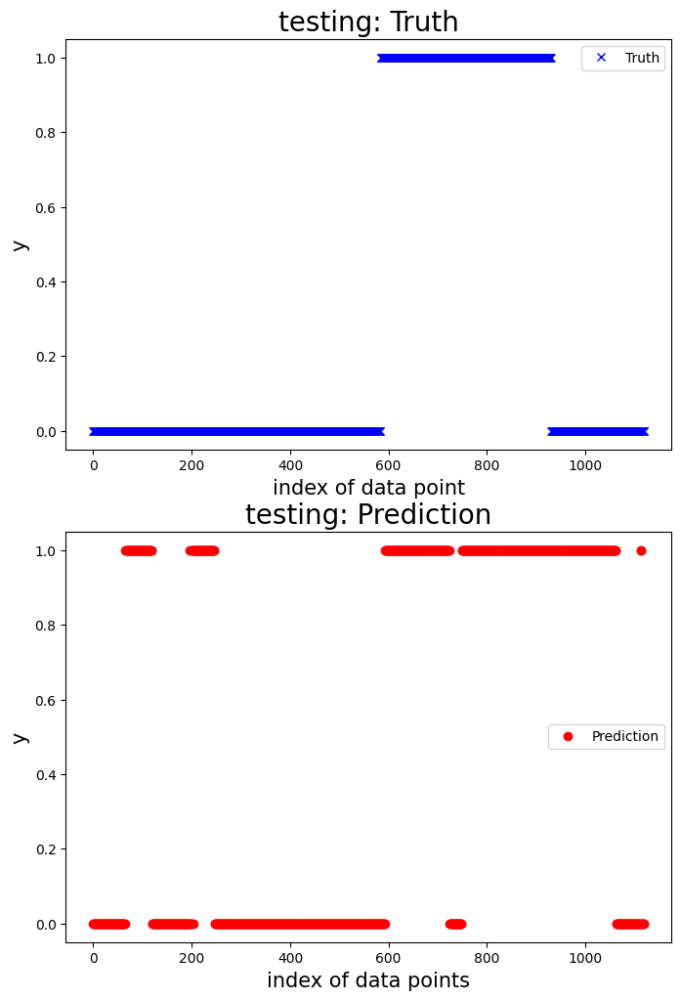

100%|██████████| 1/1 [00:00<00:00,  2.90it/s]



 New run:

testing performance, max error is: 3.948838344174477
testing performance, mean root square error is: 1.8907020842483186
testing performance, residual error > 0.9: 75.08771929824562%

 New run:

testing performance, accuracy is: 0.8421052631578947
testing performance, precision is: 0.955607476635514
testing performance, recall: 0.8520833333333333
testing performance, F1: 0.9008810572687225




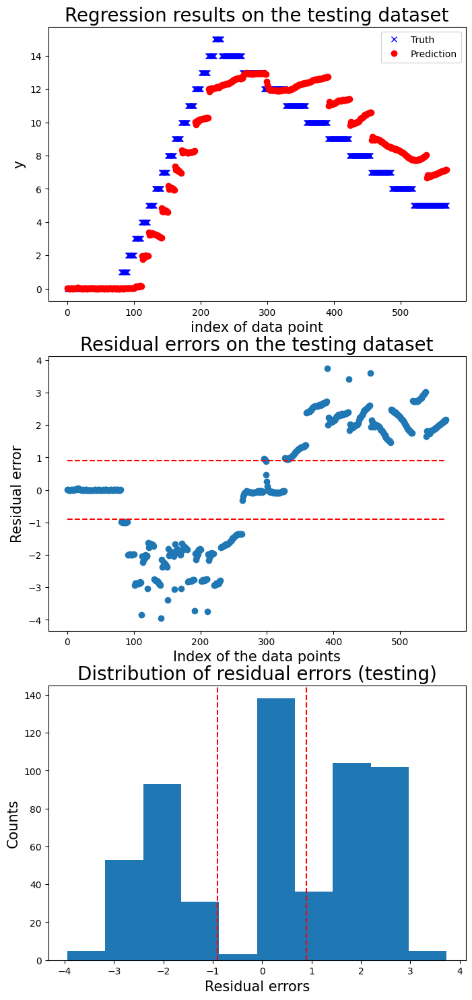

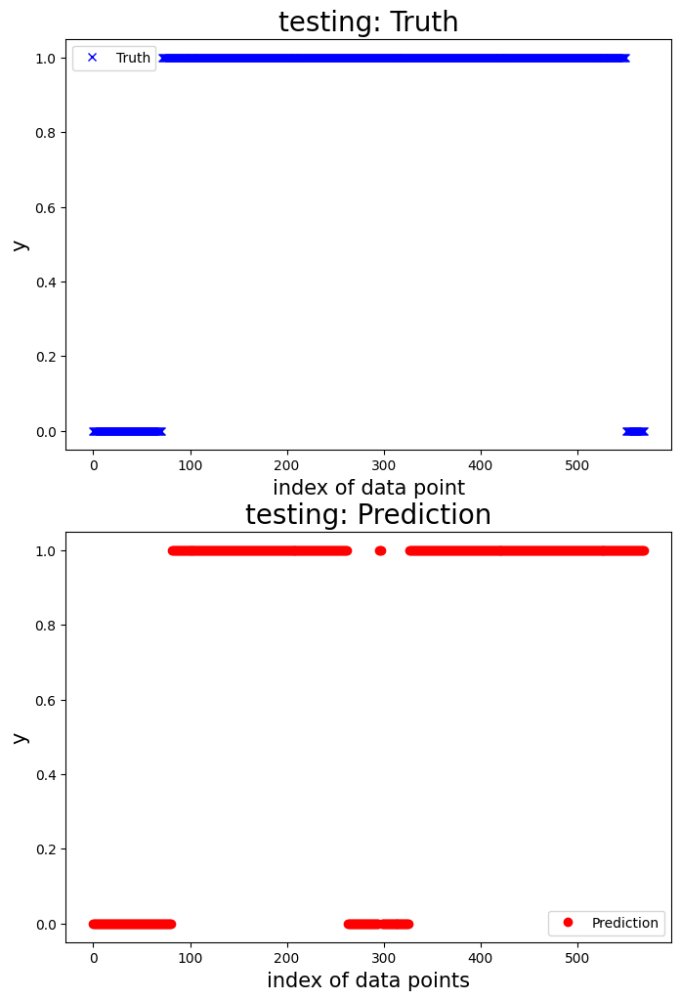

100%|██████████| 1/1 [00:00<00:00,  2.35it/s]



 New run:

testing performance, max error is: 3.0162103255674713
testing performance, mean root square error is: 1.047431133987332
testing performance, residual error > 0.9: 46.657754010695186%

 New run:

testing performance, accuracy is: 0.5601604278074866
testing performance, precision is: 0.332378223495702
testing performance, recall: 0.5471698113207547
testing performance, F1: 0.41354723707664887




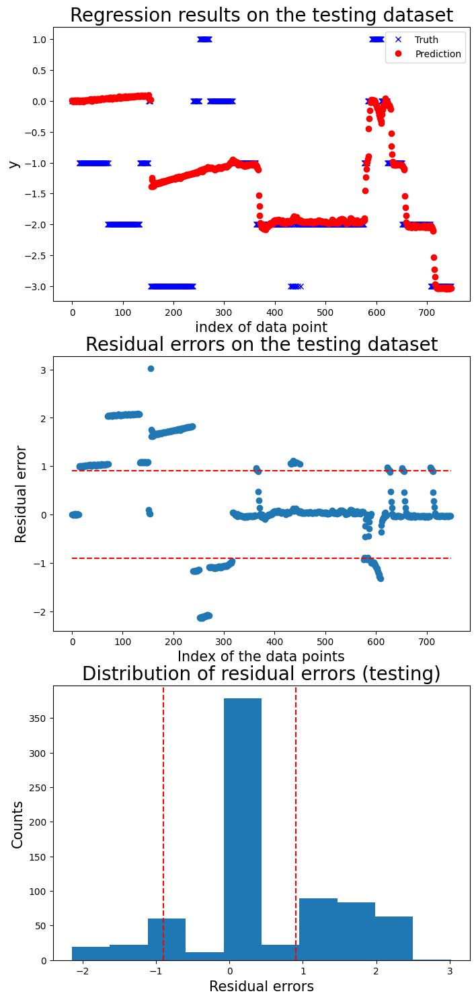

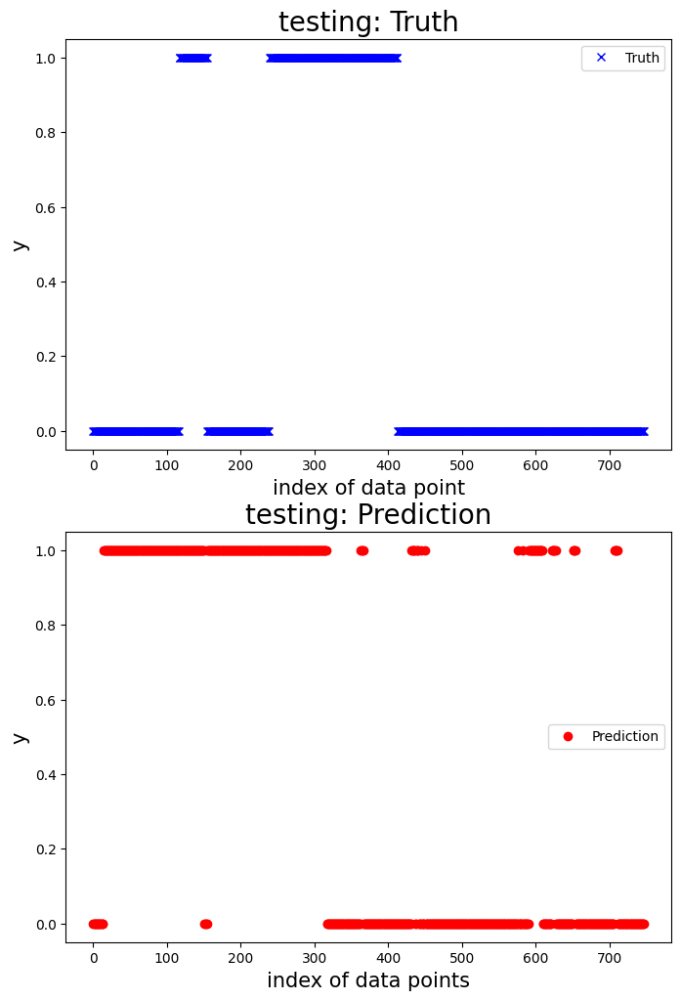

   Accuracy  Precision    Recall  F1 score
0  0.453571   0.127792  0.831987  0.221553
1  0.856436   0.778947  0.902439  0.836158
2  0.685499   0.413636  0.705426  0.521490
3  0.972414   1.000000  0.555556  0.714286
4  0.758929   0.570128  0.902017  0.698661
5  0.842105   0.955607  0.852083  0.900881
6  0.560160   0.332378  0.547170  0.413547


Mean performance metric and standard error:
Accuracy: 0.7327 +- 0.1804
Precision: 0.5969 +- 0.3288
Recall: 0.7567 +- 0.1550
F1 score: 0.6152 +- 0.2421




In [47]:
# Your code here:

from sklearn.linear_model import LinearRegression
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg


# Pre-train the model.
# Get all the normal data.
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213',
    '20240325_152902', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']

df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

df_tr = df_data[df_data['test_condition'].isin(normal_test_id)]

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature', 
                    'data_motor_1_position_diff', 'data_motor_1_temperature_diff', 
                    'data_motor_2_position_diff', 'data_motor_2_temperature_diff', 
                    'data_motor_3_position_diff', 'data_motor_3_temperature_diff', 
                    'data_motor_4_position_diff', 'data_motor_4_temperature_diff', 
                    'data_motor_5_position_diff', 'data_motor_5_temperature_diff', 
                    'data_motor_6_position_diff', 'data_motor_6_temperature_diff']

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

# Prepare feature and response of the training dataset.
x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

# Enrich the features based on the sliding window.
window_size = 10
sample_step = 1
prediction_lead_time = 1 
threshold = .9
abnormal_limit = 3

x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=window_size, sample_step=sample_step, prediction_lead_time=prediction_lead_time, mdl_type='reg')

# Test data.
test_id = [
    '20240325_155003',
    '20240425_093699',
    '20240425_094425',
    '20240426_140055',
    '20240503_163963',
    '20240503_164675',
    '20240503_165189'
]
df_test = df_data[df_data['test_condition'].isin(test_id)]


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', LinearRegression())    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)
# Fit the model
mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

# Define the fault detector.
detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=threshold, abnormal_limit=abnormal_limit, window_size=window_size, sample_step=sample_step, pred_lead_time=prediction_lead_time)

# # Run cross validation
n_fold = 7
_, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='clf')
x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

motor_idx = 6
print(f'Model for motor {motor_idx}:')
# Run cross validation.
df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, 
                                        n_fold=n_fold)
print(df_perf)
print('\n')
# Print the mean performance and standard error.
print('Mean performance metric and standard error:')
for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
    print(f'{name}: {metric:.4f} +- {error:.4f}') 
print('\n')


Model for motor 6:


100%|██████████| 1/1 [00:04<00:00,  4.19s/it]



 New run:

testing performance, max error is: 3.892071860580679
testing performance, mean root square error is: 1.163031667262925
testing performance, residual error > 1.0926275961541314: 36.22968251557041%

 New run:

testing performance, accuracy is: 0.5214947592283153
testing performance, precision is: 0.06347016212487064
testing performance, recall: 0.2972536348949919
testing performance, F1: 0.1046048891415577




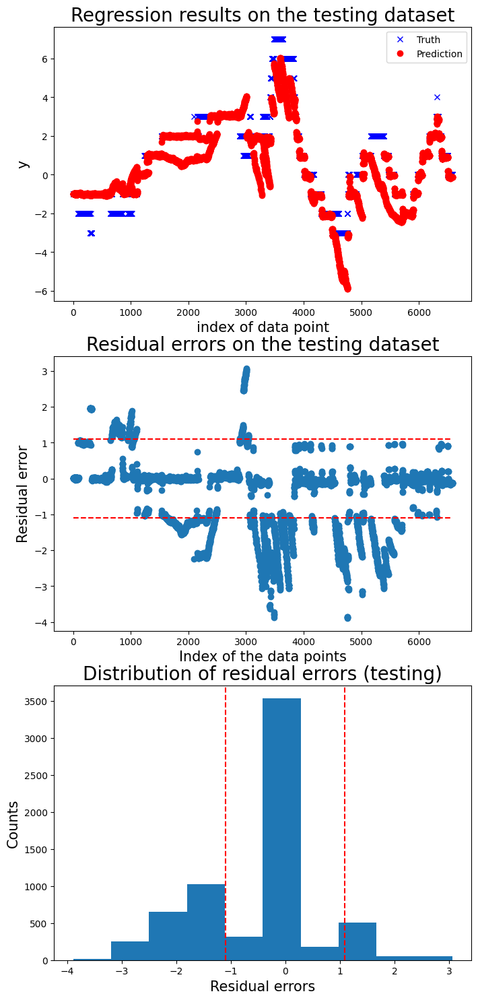

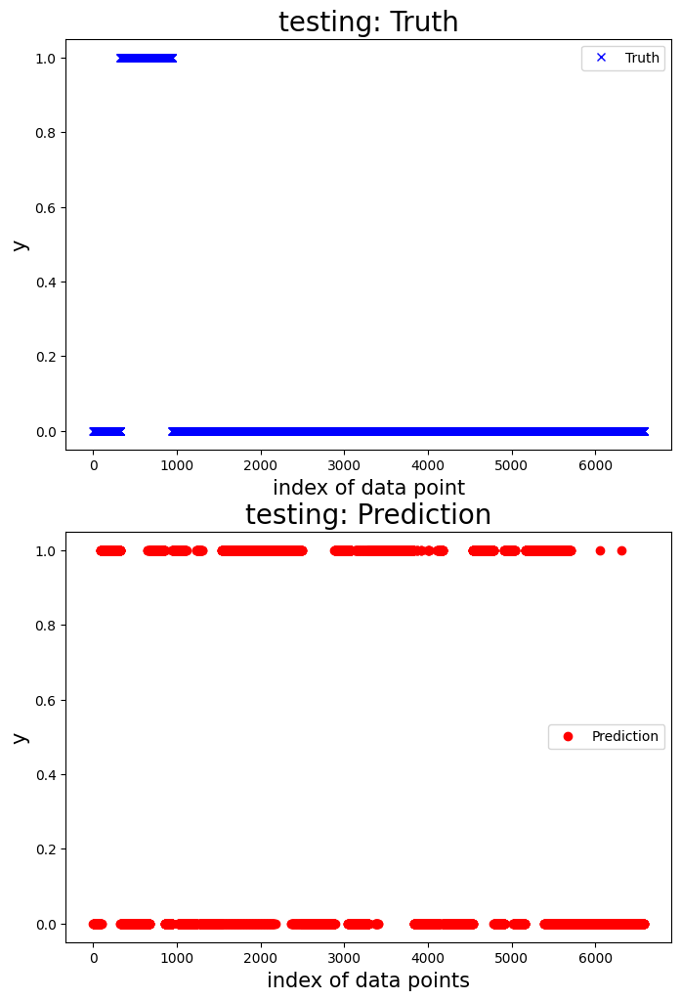

100%|██████████| 1/1 [00:00<00:00, 11.46it/s]



 New run:

testing performance, max error is: 5.9958632980613995
testing performance, mean root square error is: 1.7410251885149046
testing performance, residual error > 1.4497595664635665: 26.543209876543212%

 New run:

testing performance, accuracy is: 0.8209876543209876
testing performance, precision is: 1.0
testing performance, recall: 0.6463414634146342
testing performance, F1: 0.7851851851851852




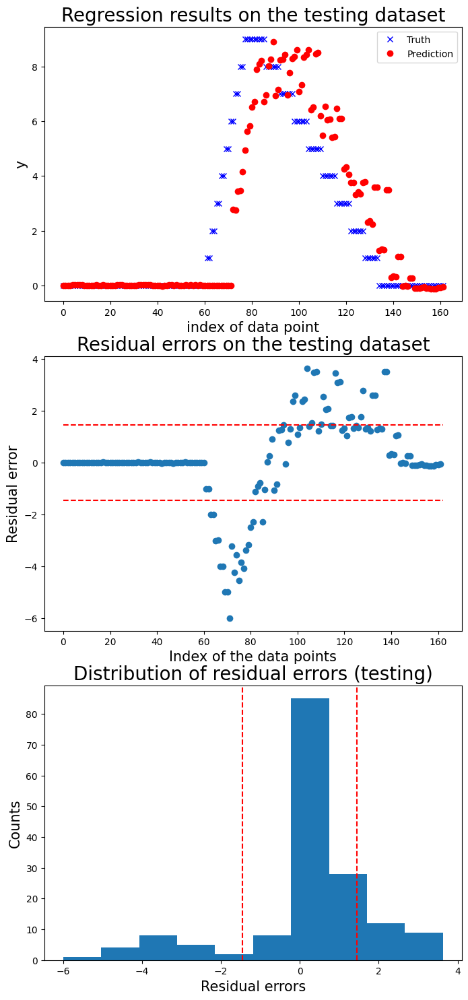

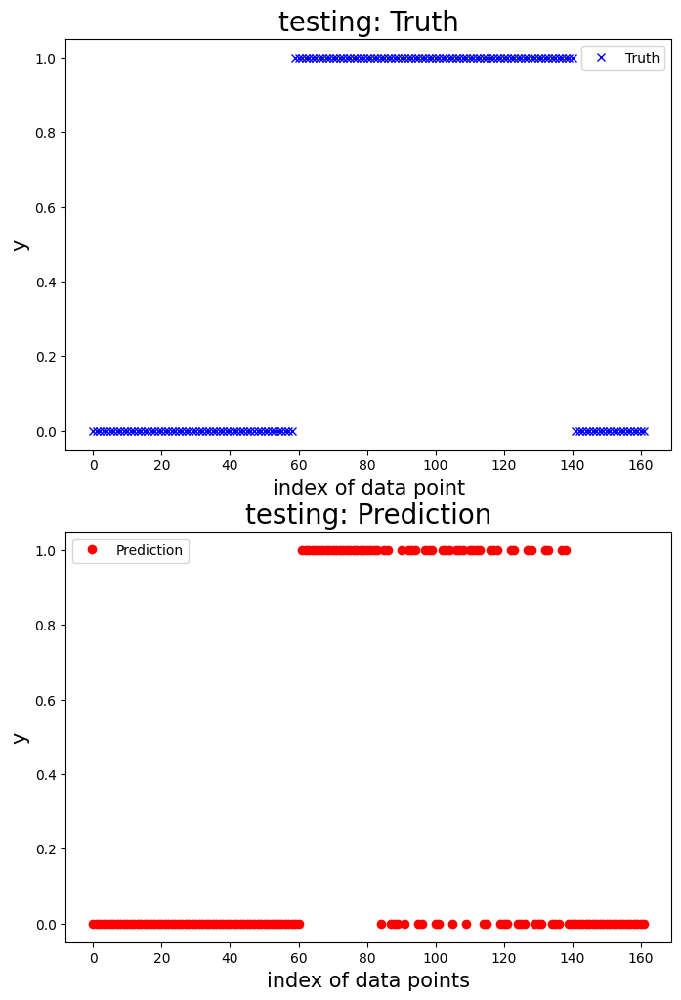

100%|██████████| 1/1 [00:00<00:00,  3.66it/s]



 New run:

testing performance, max error is: 3.1338388211674775
testing performance, mean root square error is: 0.7932626782371008
testing performance, residual error > 0.9: 18.329938900203665%

 New run:

testing performance, accuracy is: 0.9205702647657841
testing performance, precision is: 1.0
testing performance, recall: 0.6976744186046512
testing performance, F1: 0.821917808219178




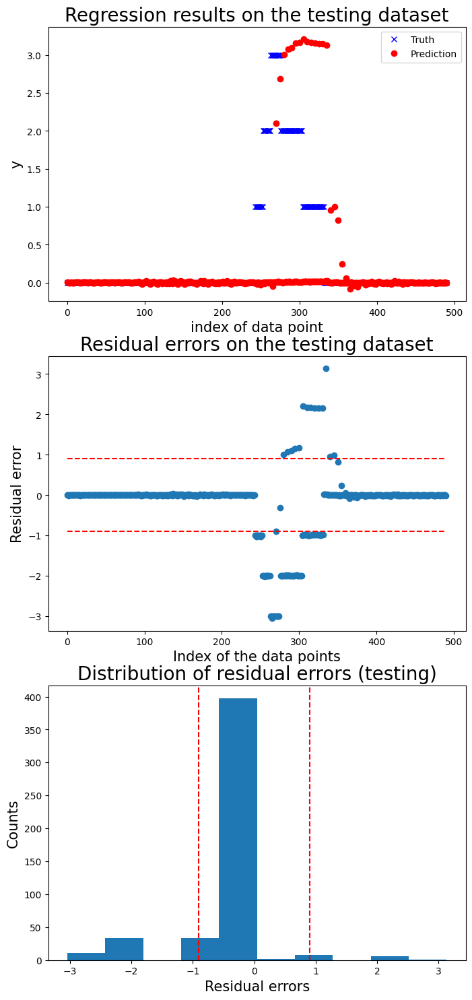

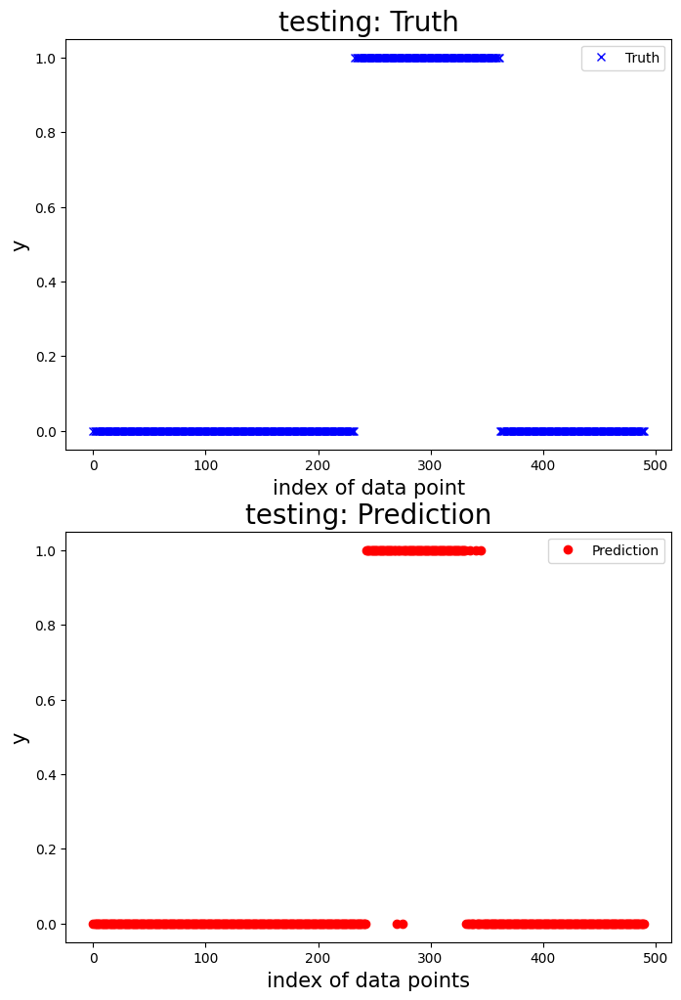

100%|██████████| 1/1 [00:00<00:00,  1.82it/s]



 New run:

testing performance, max error is: 2.0136741427454385
testing performance, mean root square error is: 0.24697010840953043
testing performance, residual error > 0.9: 3.5897435897435894%

 New run:

testing performance, accuracy is: 0.9712820512820513
testing performance, precision is: 1.0
testing performance, recall: 0.5555555555555556
testing performance, F1: 0.7142857142857143




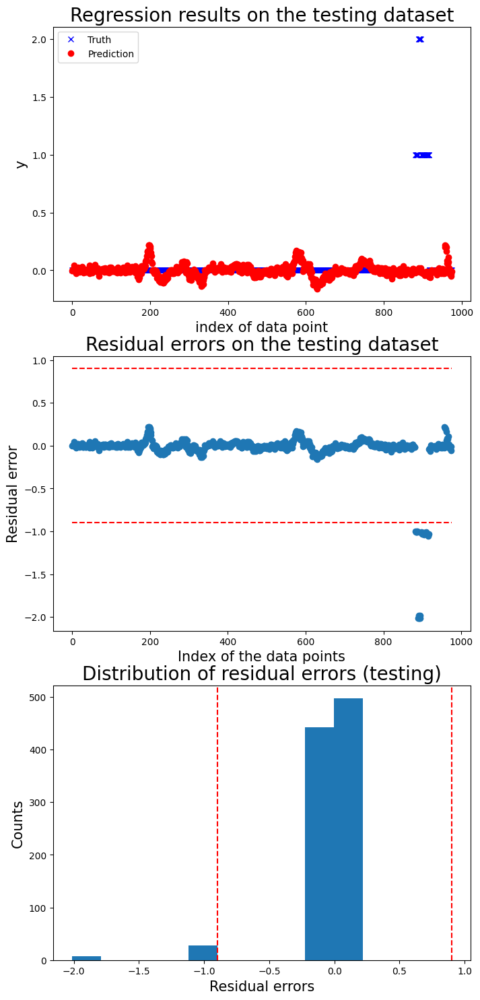

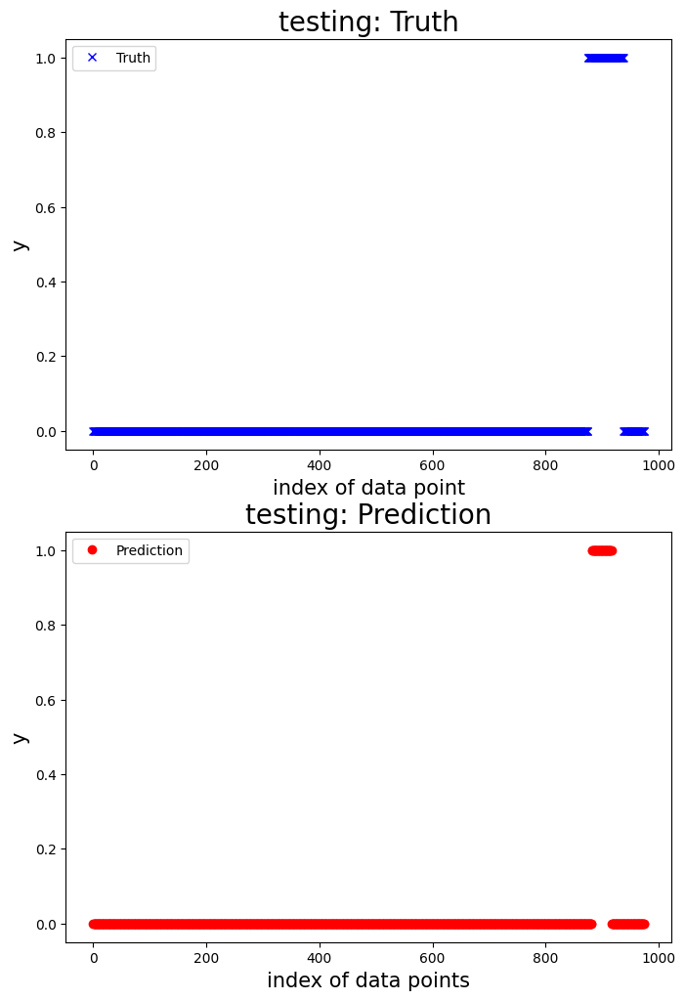

100%|██████████| 1/1 [00:00<00:00,  1.73it/s]



 New run:

testing performance, max error is: 2.026183201115435
testing performance, mean root square error is: 0.4598253494318091
testing performance, residual error > 1.4967270059171691: 0.8333333333333334%

 New run:

testing performance, accuracy is: 0.6194444444444445
testing performance, precision is: 0.0
testing performance, recall: 0.0
testing performance, F1: 0.0




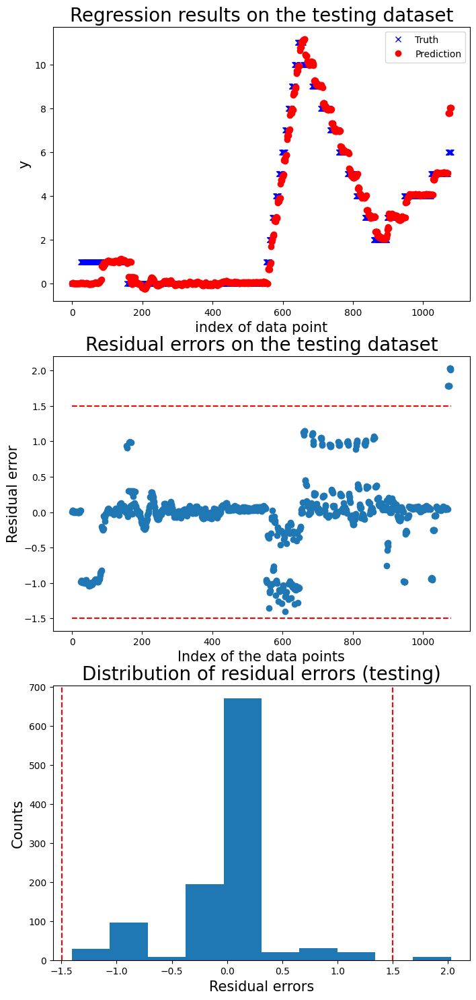

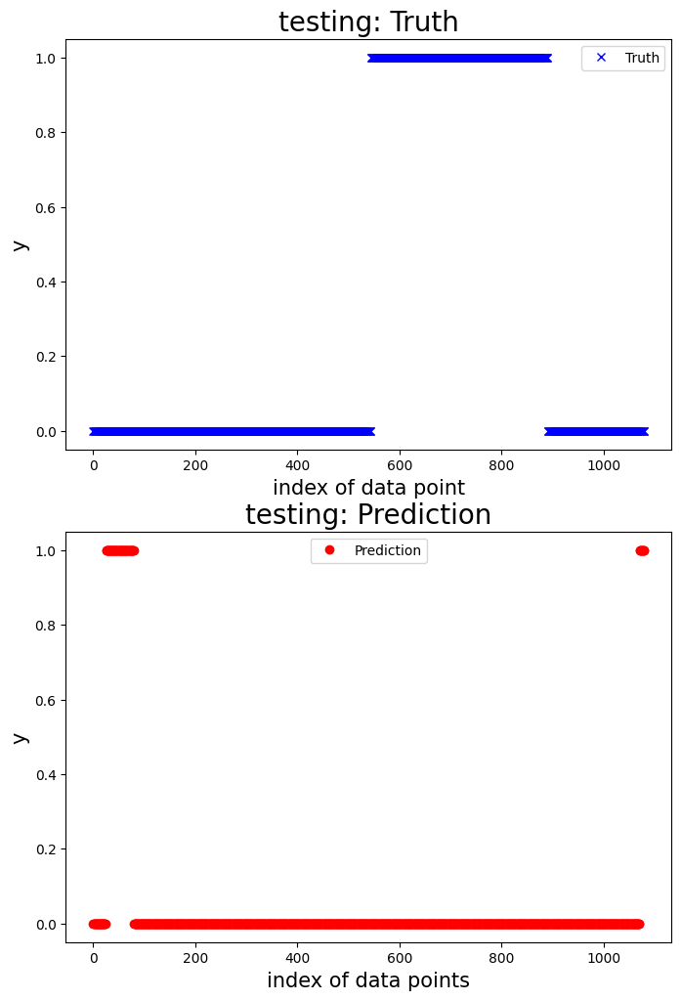

100%|██████████| 1/1 [00:00<00:00,  3.41it/s]



 New run:

testing performance, max error is: 3.8223035274024117
testing performance, mean root square error is: 1.2111010297234048
testing performance, residual error > 1.3616405878665798: 17.92452830188679%

 New run:

testing performance, accuracy is: 0.330188679245283
testing performance, precision is: 1.0
testing performance, recall: 0.2604166666666667
testing performance, F1: 0.4132231404958678




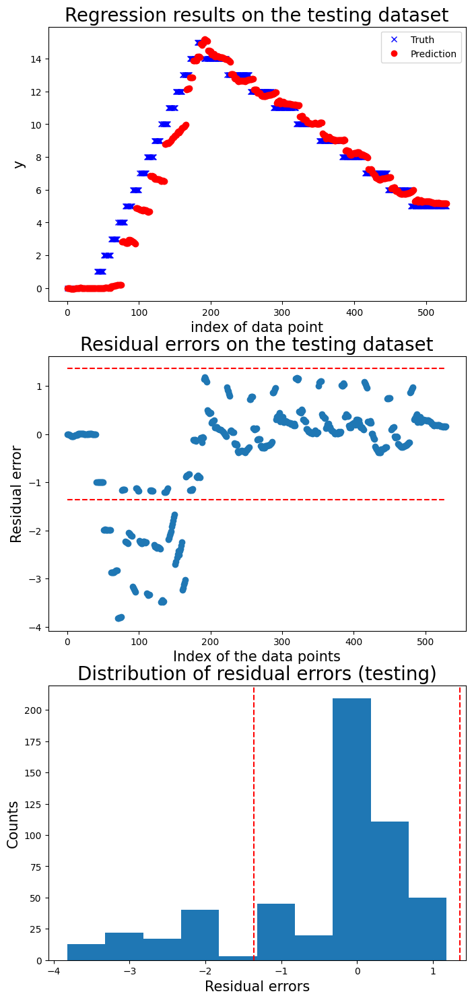

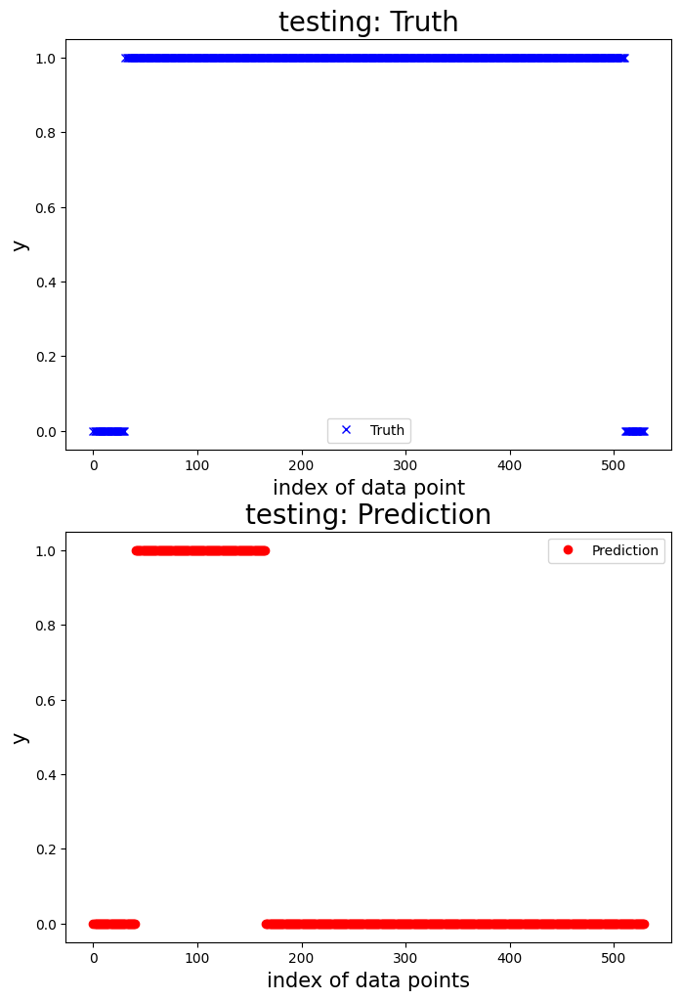

100%|██████████| 1/1 [00:00<00:00,  2.51it/s]



 New run:

testing performance, max error is: 2.1968043559778034
testing performance, mean root square error is: 0.8558765169541953
testing performance, residual error > 1.4694301615072134: 11.864406779661017%

 New run:

testing performance, accuracy is: 0.5466101694915254
testing performance, precision is: 0.1390728476821192
testing performance, recall: 0.09905660377358491
testing performance, F1: 0.11570247933884298




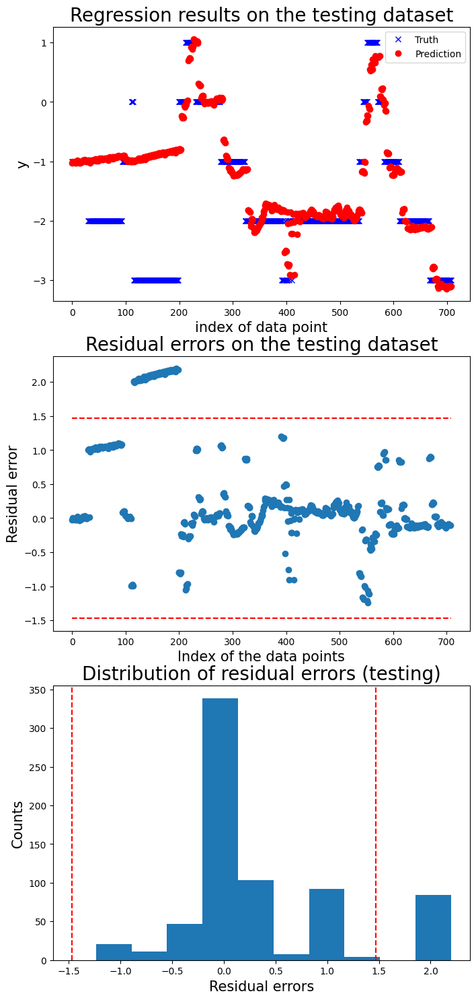

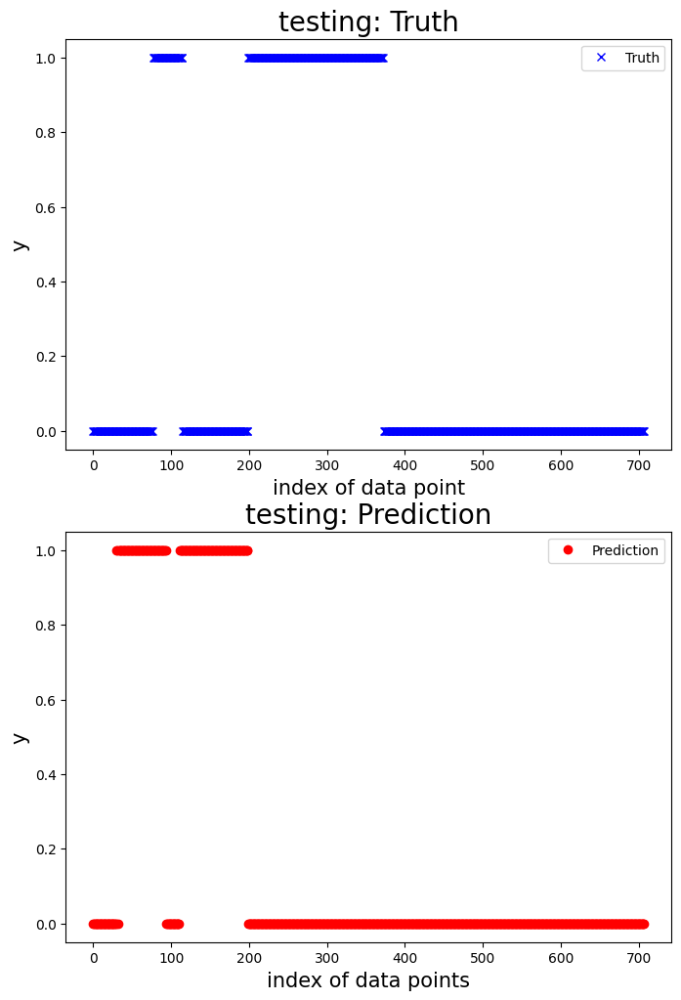

   Accuracy  Precision    Recall  F1 score
0  0.521495   0.063470  0.297254  0.104605
1  0.820988   1.000000  0.646341  0.785185
2  0.920570   1.000000  0.697674  0.821918
3  0.971282   1.000000  0.555556  0.714286
4  0.619444   0.000000  0.000000  0.000000
5  0.330189   1.000000  0.260417  0.413223
6  0.546610   0.139073  0.099057  0.115702


Mean performance metric and standard error:
Accuracy: 0.6758 +- 0.2350
Precision: 0.6004 +- 0.5001
Recall: 0.3652 +- 0.2725
F1 score: 0.4221 +- 0.3536




In [48]:
# Your code here:

from sklearn.linear_model import LinearRegression
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg


# Pre-train the model.
# Get all the normal data.
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213',
    '20240325_152902', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']

df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

df_tr = df_data[df_data['test_condition'].isin(normal_test_id)]

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature', 
                    'data_motor_1_position_diff', 'data_motor_1_temperature_diff', 
                    'data_motor_2_position_diff', 'data_motor_2_temperature_diff', 
                    'data_motor_3_position_diff', 'data_motor_3_temperature_diff', 
                    'data_motor_4_position_diff', 'data_motor_4_temperature_diff', 
                    'data_motor_5_position_diff', 'data_motor_5_temperature_diff', 
                    'data_motor_6_position_diff', 'data_motor_6_temperature_diff']

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

# Prepare feature and response of the training dataset.
x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

# Enrich the features based on the sliding window.
window_size = 50
sample_step = 5
prediction_lead_time = 1 
threshold = .9
abnormal_limit = 3

x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=window_size, sample_step=sample_step, prediction_lead_time=prediction_lead_time, mdl_type='reg')

# Test data.
test_id = [
    '20240325_155003',
    '20240425_093699',
    '20240425_094425',
    '20240426_140055',
    '20240503_163963',
    '20240503_164675',
    '20240503_165189'
]
df_test = df_data[df_data['test_condition'].isin(test_id)]


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', LinearRegression())    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)
# Fit the model
mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

# Define the fault detector.
detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=threshold, abnormal_limit=abnormal_limit, window_size=window_size, sample_step=sample_step, pred_lead_time=prediction_lead_time)

# # Run cross validation
n_fold = 7
_, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='clf')
x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

motor_idx = 6
print(f'Model for motor {motor_idx}:')
# Run cross validation.
df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, 
                                        n_fold=n_fold)
print(df_perf)
print('\n')
# Print the mean performance and standard error.
print('Mean performance metric and standard error:')
for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
    print(f'{name}: {metric:.4f} +- {error:.4f}') 
print('\n')


#### support vector machine regression

Model for motor 6:


100%|██████████| 1/1 [00:06<00:00,  6.82s/it]



 New run:

testing performance, max error is: 5.167549789592075
testing performance, mean root square error is: 2.0784020002250743
testing performance, residual error > 1.4995631425576024: 45.961044843726405%

 New run:

testing performance, accuracy is: 0.6151290955760229
testing performance, precision is: 0.19539141414141414
testing performance, recall: 1.0
testing performance, F1: 0.32690784261948774




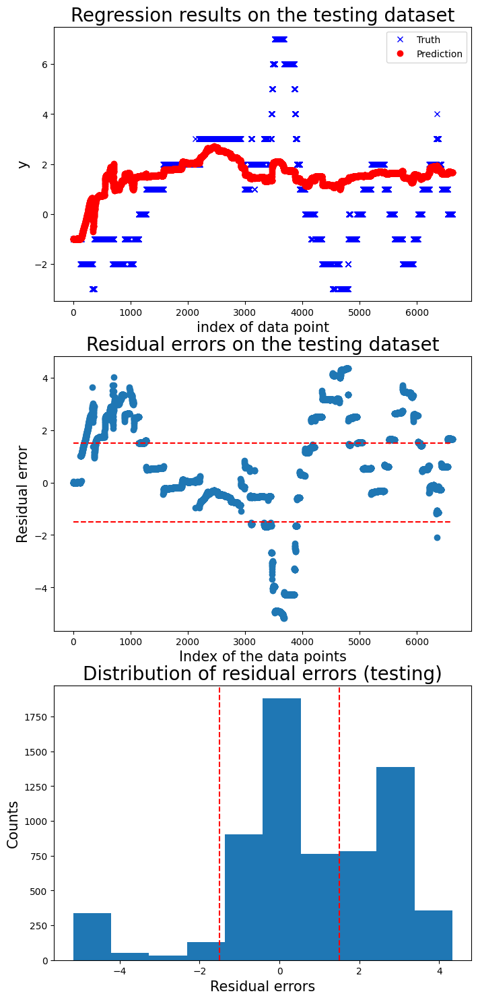

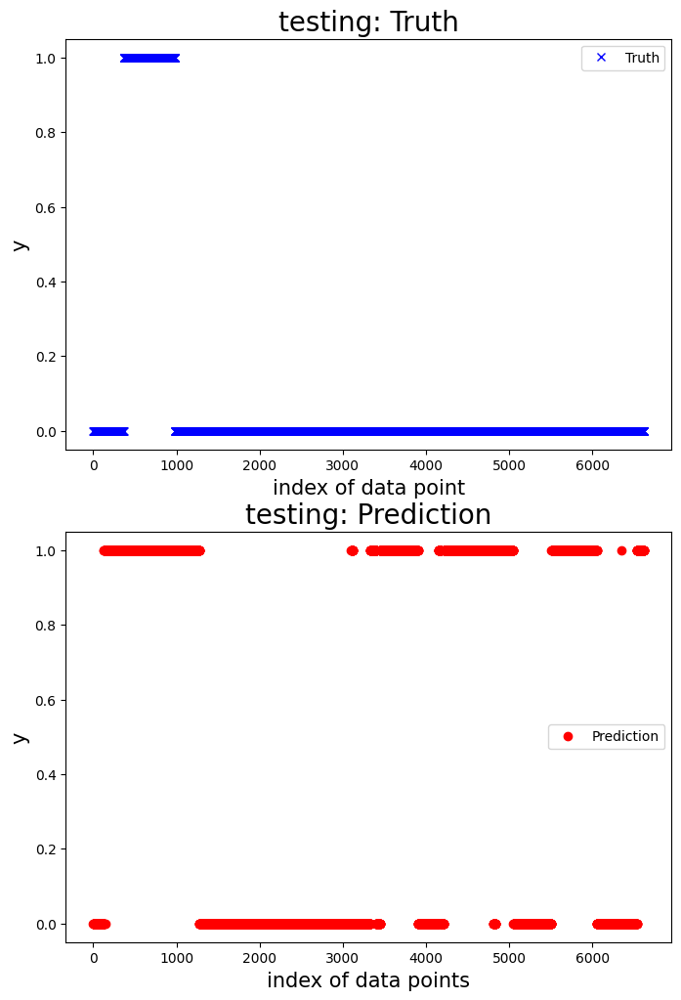

100%|██████████| 1/1 [00:00<00:00,  4.50it/s]



 New run:

testing performance, max error is: 3.9747448439780166
testing performance, mean root square error is: 1.5338625142869378
testing performance, residual error > 0.9834312955459878: 41.089108910891085%

 New run:

testing performance, accuracy is: 0.8118811881188119
testing performance, precision is: 0.7558139534883721
testing performance, recall: 0.7926829268292683
testing performance, F1: 0.7738095238095238




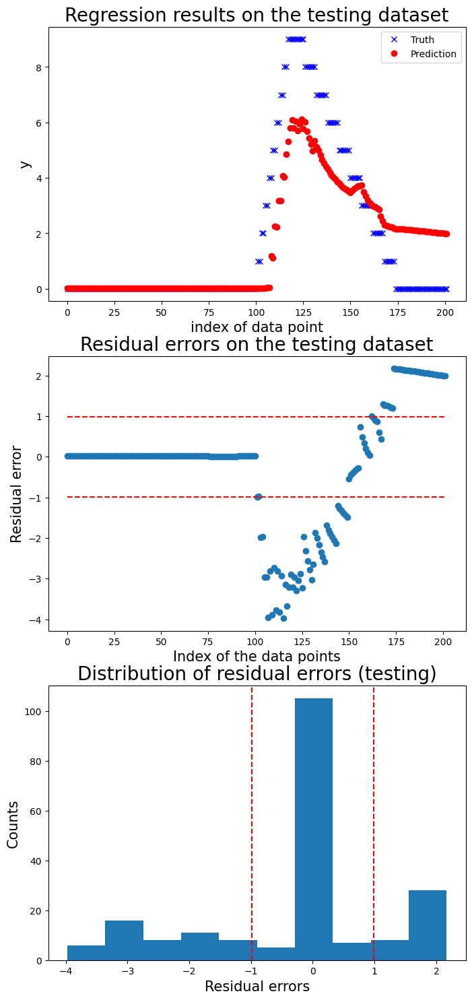

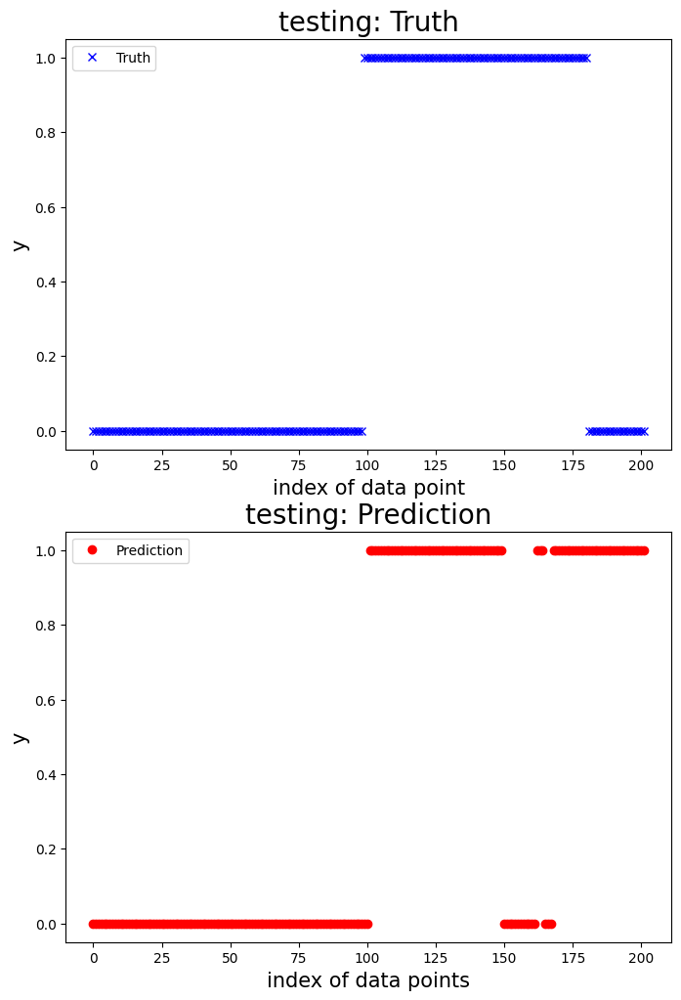

100%|██████████| 1/1 [00:00<00:00,  2.05it/s]



 New run:

testing performance, max error is: 3.0246257694706165
testing performance, mean root square error is: 0.9311888221621065
testing performance, residual error > 0.9: 41.431261770244824%

 New run:

testing performance, accuracy is: 0.6854990583804144
testing performance, precision is: 0.41363636363636364
testing performance, recall: 0.7054263565891473
testing performance, F1: 0.5214899713467048




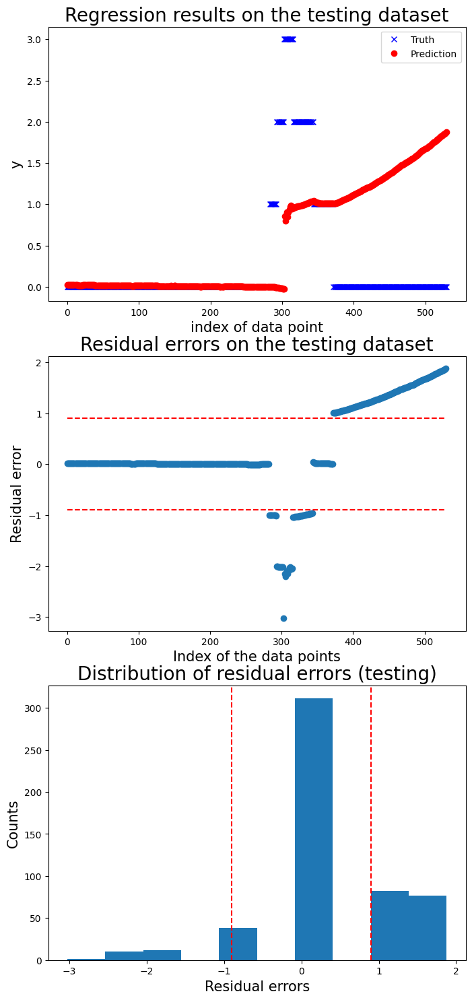

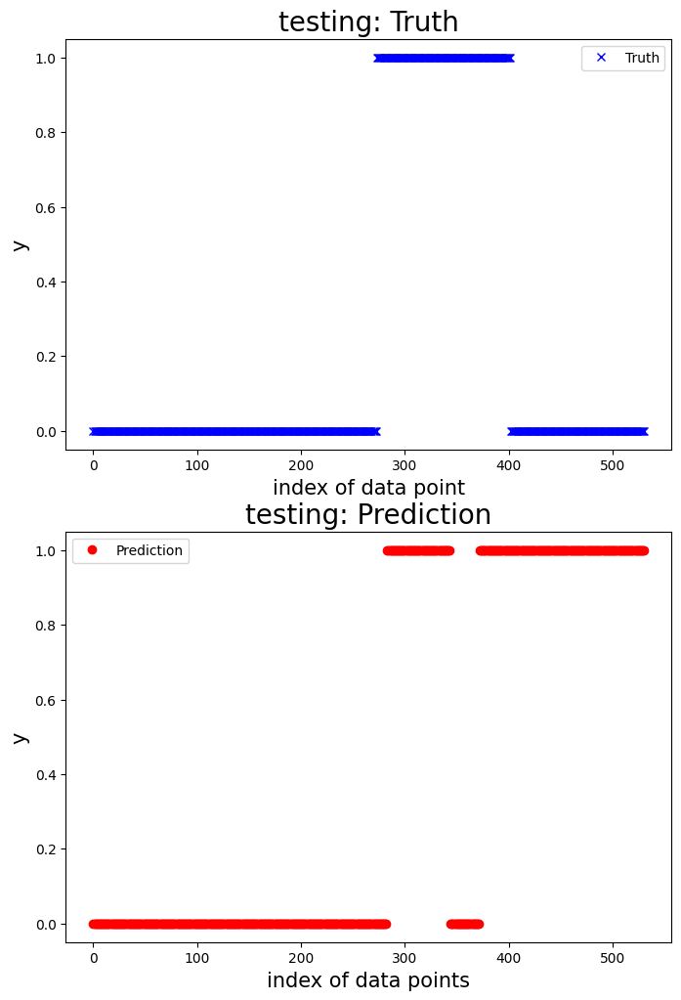

100%|██████████| 1/1 [00:00<00:00,  1.07it/s]



 New run:

testing performance, max error is: 3.046168602021397
testing performance, mean root square error is: 1.5651777043948185
testing performance, residual error > 0.9: 48.3743842364532%

 New run:

testing performance, accuracy is: 0.5231527093596059
testing performance, precision is: 0.07128309572301425
testing performance, recall: 0.5555555555555556
testing performance, F1: 0.1263537906137184




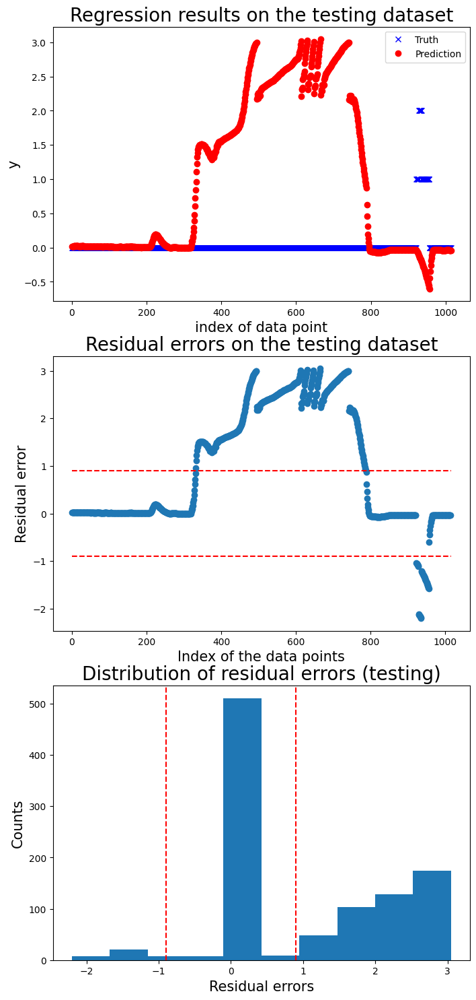

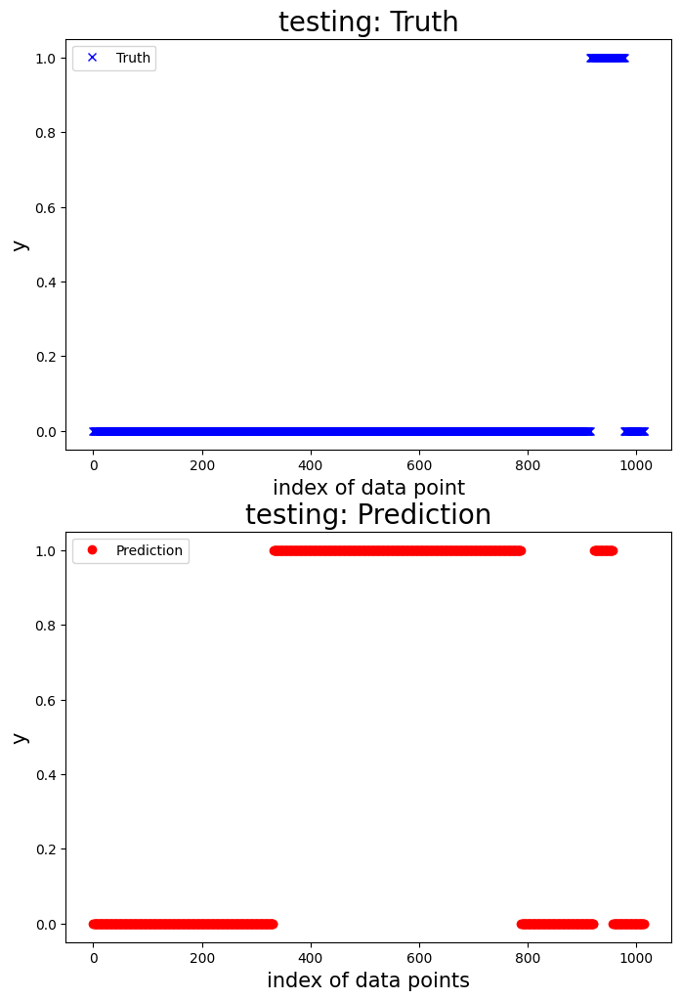

100%|██████████| 1/1 [00:01<00:00,  1.02s/it]



 New run:

testing performance, max error is: 7.24225578443618
testing performance, mean root square error is: 2.3625543041229378
testing performance, residual error > 1.4979200785751923: 41.25%

 New run:

testing performance, accuracy is: 0.7678571428571429
testing performance, precision is: 0.5923566878980892
testing performance, recall: 0.8040345821325648
testing performance, F1: 0.6821515892420538




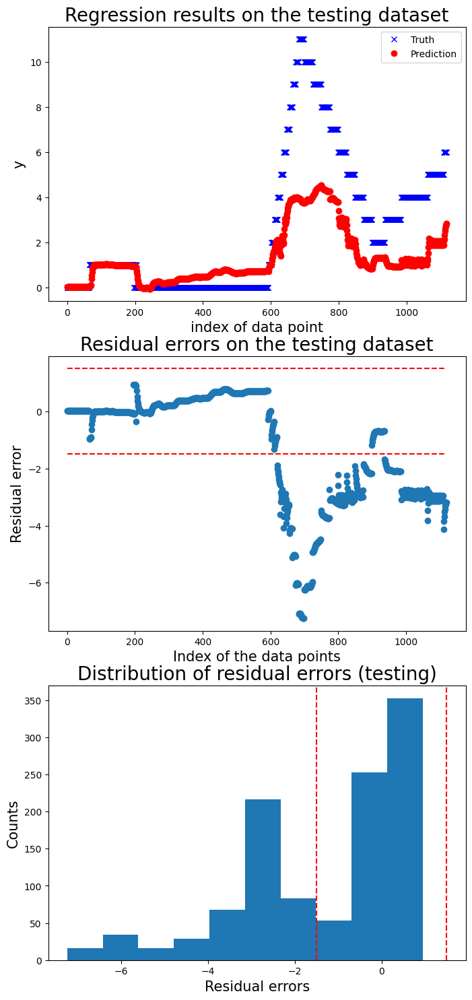

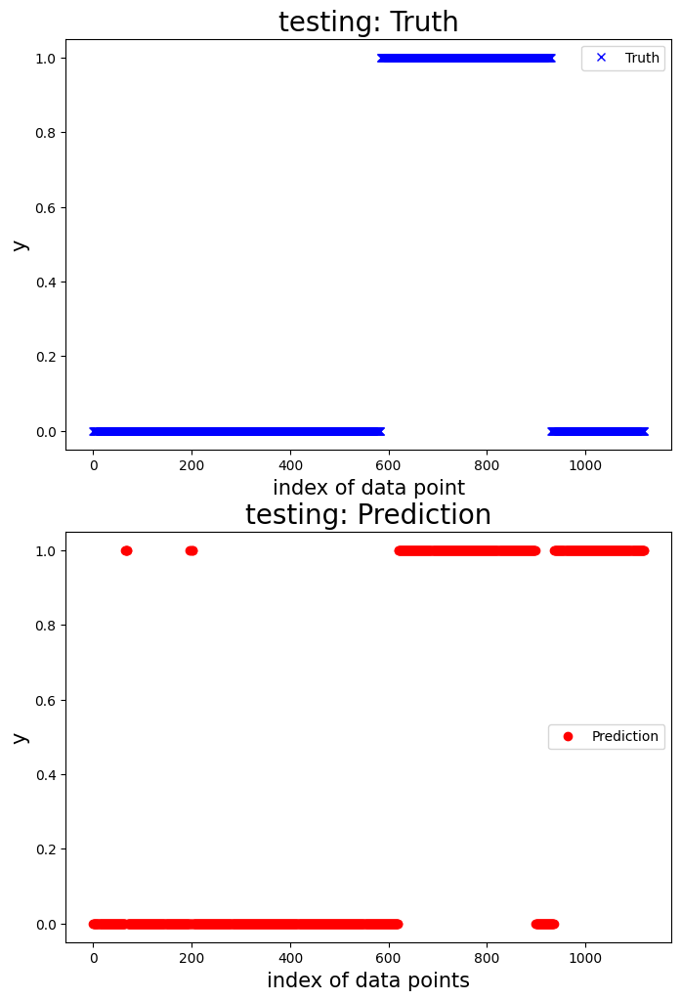

100%|██████████| 1/1 [00:00<00:00,  1.95it/s]



 New run:

testing performance, max error is: 10.157314472962735
testing performance, mean root square error is: 4.952169601167254
testing performance, residual error > 0.9: 85.78947368421052%

 New run:

testing performance, accuracy is: 0.9491228070175438
testing performance, precision is: 0.9611451942740287
testing performance, recall: 0.9791666666666666
testing performance, F1: 0.9700722394220846




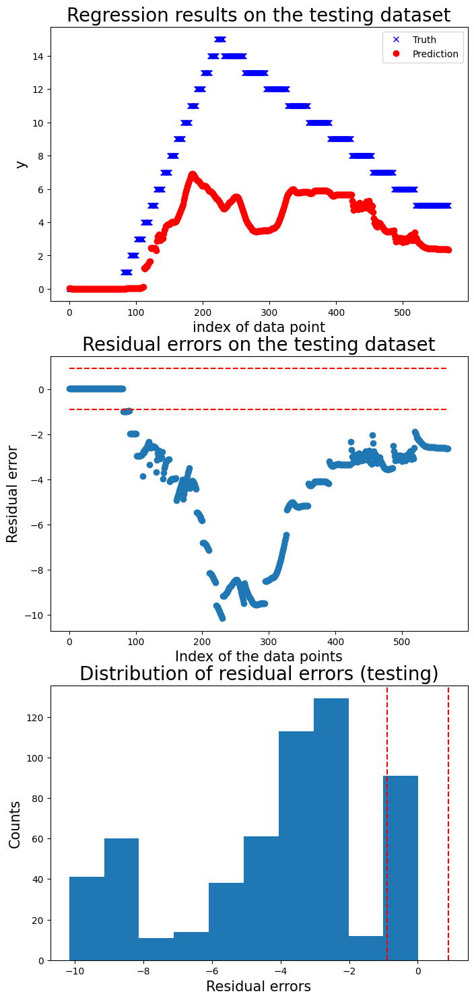

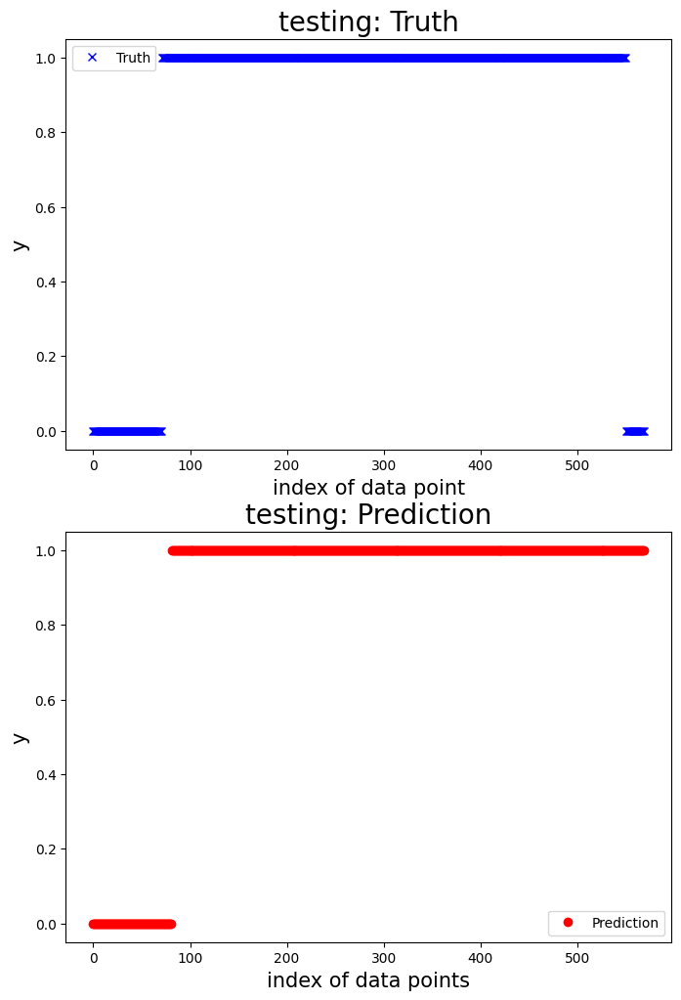

100%|██████████| 1/1 [00:00<00:00,  1.44it/s]



 New run:

testing performance, max error is: 3.7697938442014323
testing performance, mean root square error is: 1.4838182299178893
testing performance, residual error > 1.497655553154063: 32.62032085561498%

 New run:

testing performance, accuracy is: 0.38235294117647056
testing performance, precision is: 0.1069182389937107
testing performance, recall: 0.16037735849056603
testing performance, F1: 0.12830188679245283




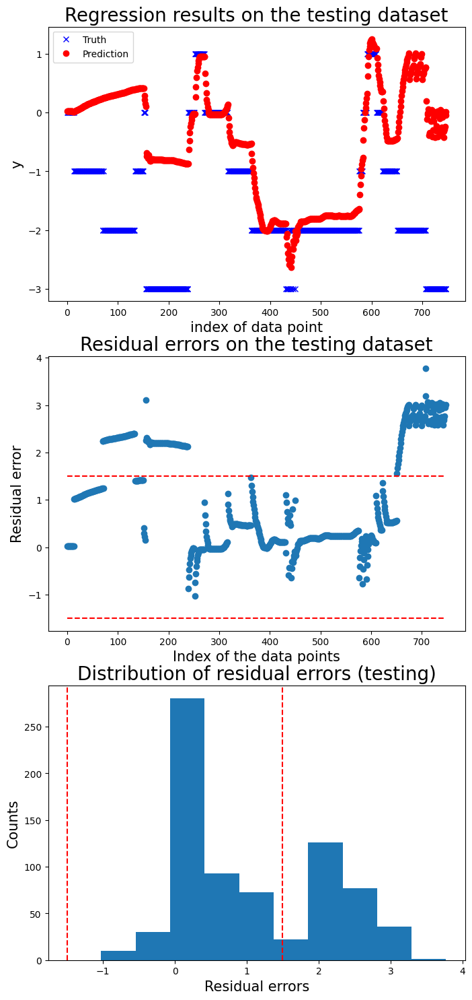

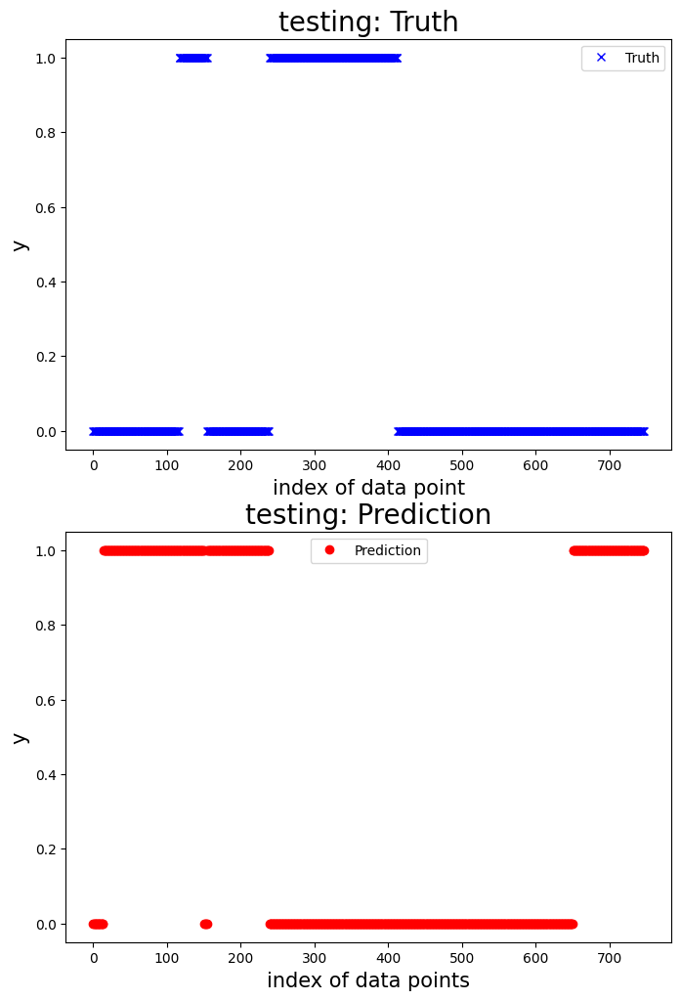

   Accuracy  Precision    Recall  F1 score
0  0.615129   0.195391  1.000000  0.326908
1  0.811881   0.755814  0.792683  0.773810
2  0.685499   0.413636  0.705426  0.521490
3  0.523153   0.071283  0.555556  0.126354
4  0.767857   0.592357  0.804035  0.682152
5  0.949123   0.961145  0.979167  0.970072
6  0.382353   0.106918  0.160377  0.128302


Mean performance metric and standard error:
Accuracy: 0.6764 +- 0.1892
Precision: 0.4424 +- 0.3420
Recall: 0.7139 +- 0.2881
F1 score: 0.5042 +- 0.3259




In [49]:
# Your code here:

from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg
from sklearn.svm import SVR 

# Pre-train the model.
# Get all the normal data.
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213',
    '20240325_152902', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']

df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

df_tr = df_data[df_data['test_condition'].isin(normal_test_id)]

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

# Prepare feature and response of the training dataset.
x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

# Enrich the features based on the sliding window.
window_size = 10
sample_step = 1
prediction_lead_time = 1 
threshold = .9
abnormal_limit = 3

x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=window_size, sample_step=sample_step, prediction_lead_time=prediction_lead_time, mdl_type='reg')

# Test data.
test_id = [
    '20240325_155003',
    '20240425_093699',
    '20240425_094425',
    '20240426_140055',
    '20240503_163963',
    '20240503_164675',
    '20240503_165189'
]
df_test = df_data[df_data['test_condition'].isin(test_id)]


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SVR(C=1.0, epsilon=0.2))    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)
# Fit the model
mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

# Define the fault detector.
detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=threshold, abnormal_limit=abnormal_limit, window_size=window_size, sample_step=sample_step, pred_lead_time=prediction_lead_time)

# # Run cross validation
n_fold = 7
_, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='clf')
x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

motor_idx = 6
print(f'Model for motor {motor_idx}:')
# Run cross validation.
df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, 
                                        n_fold=n_fold)
print(df_perf)
print('\n')
# Print the mean performance and standard error.
print('Mean performance metric and standard error:')
for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
    print(f'{name}: {metric:.4f} +- {error:.4f}') 
print('\n')


Model for motor 6:


100%|██████████| 1/1 [00:07<00:00,  7.60s/it]



 New run:

testing performance, max error is: 5.38452990268493
testing performance, mean root square error is: 2.012852253534094
testing performance, residual error > 1.499775572912603: 35.6980100258241%

 New run:

testing performance, accuracy is: 0.6691478049521494
testing performance, precision is: 0.16928298684768775
testing performance, recall: 0.6445880452342488
testing performance, F1: 0.26814516129032256




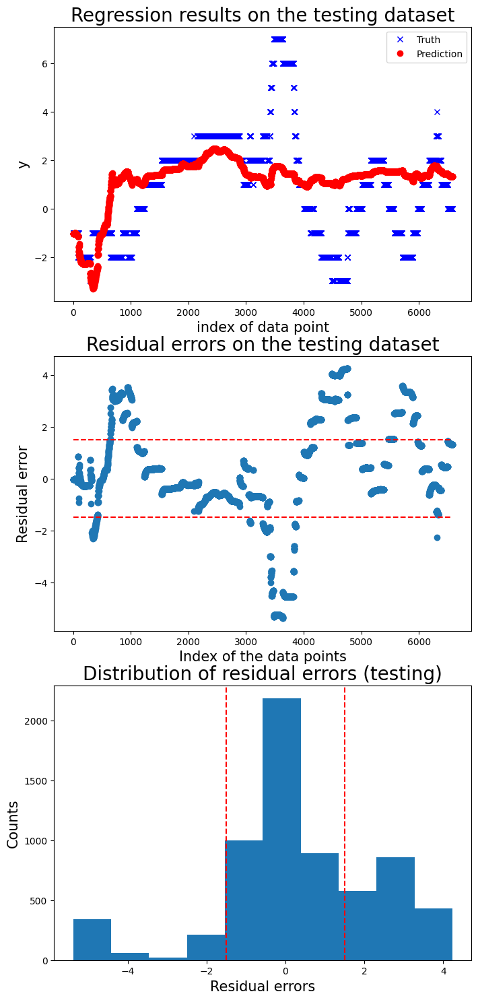

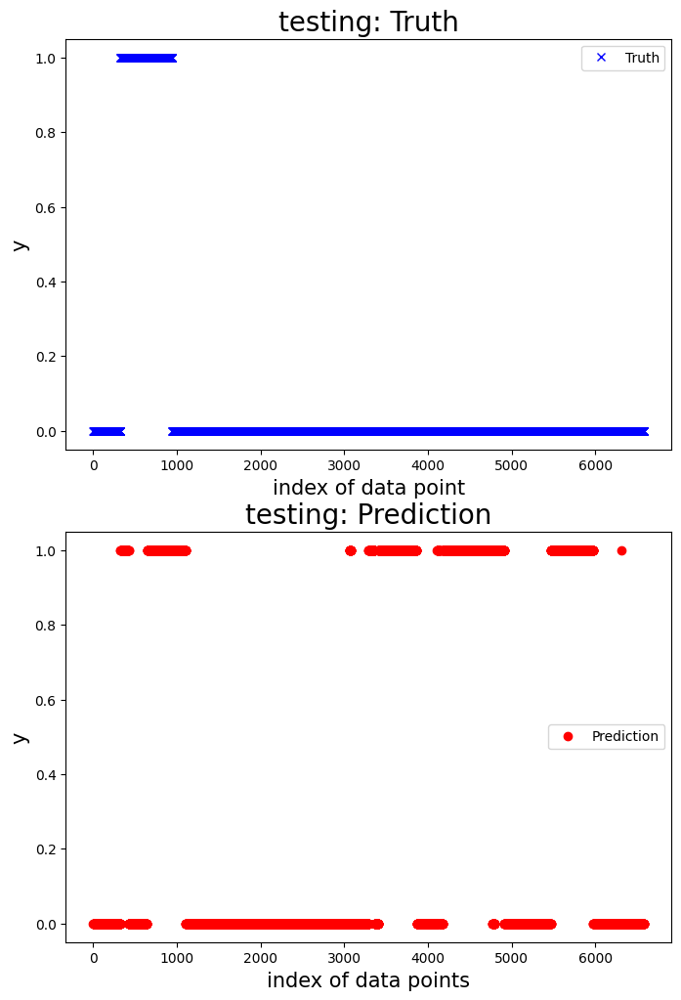

100%|██████████| 1/1 [00:00<00:00,  5.90it/s]



 New run:

testing performance, max error is: 5.361701150302071
testing performance, mean root square error is: 1.989124592953208
testing performance, residual error > 1.4725946158816747: 42.592592592592595%

 New run:

testing performance, accuracy is: 0.691358024691358
testing performance, precision is: 0.7162162162162162
testing performance, recall: 0.6463414634146342
testing performance, F1: 0.6794871794871795




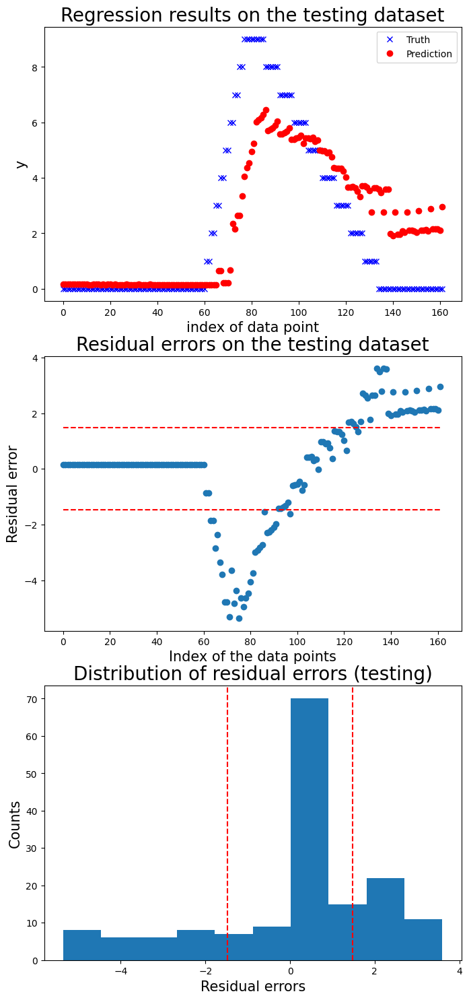

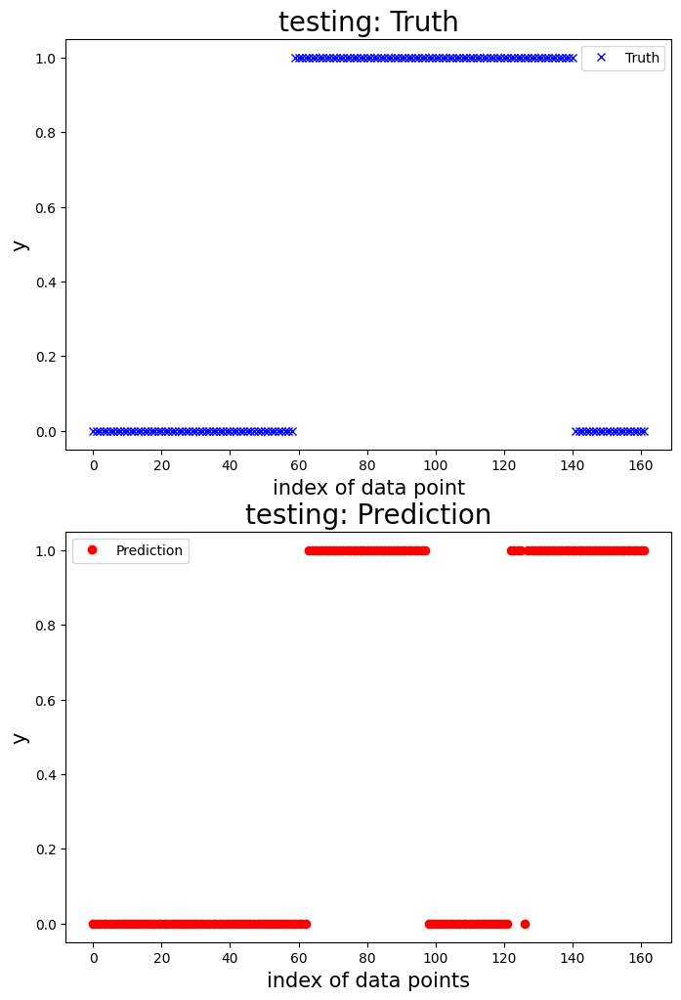

100%|██████████| 1/1 [00:00<00:00,  1.69it/s]



 New run:

testing performance, max error is: 3.053492048011793
testing performance, mean root square error is: 1.4813913488799775
testing performance, residual error > 1.0378300169304921: 42.76985743380855%

 New run:

testing performance, accuracy is: 0.639511201629328
testing performance, precision is: 0.38571428571428573
testing performance, recall: 0.627906976744186
testing performance, F1: 0.4778761061946903




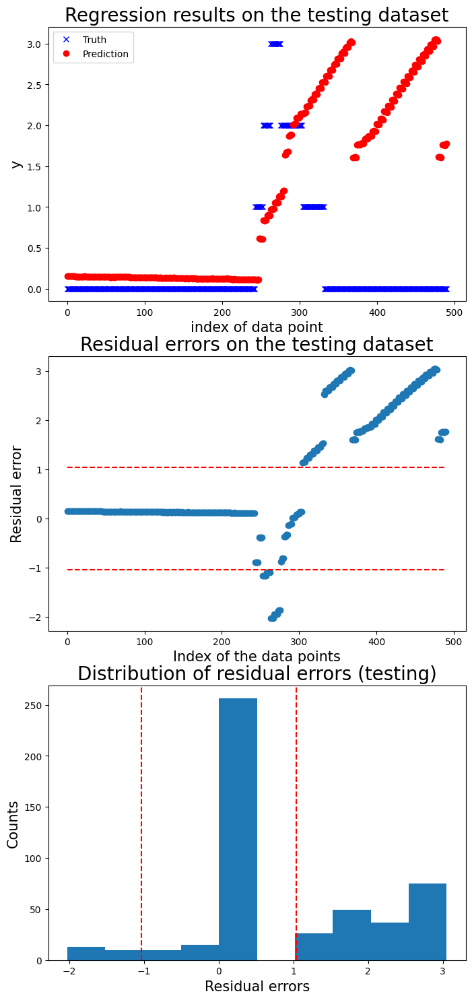

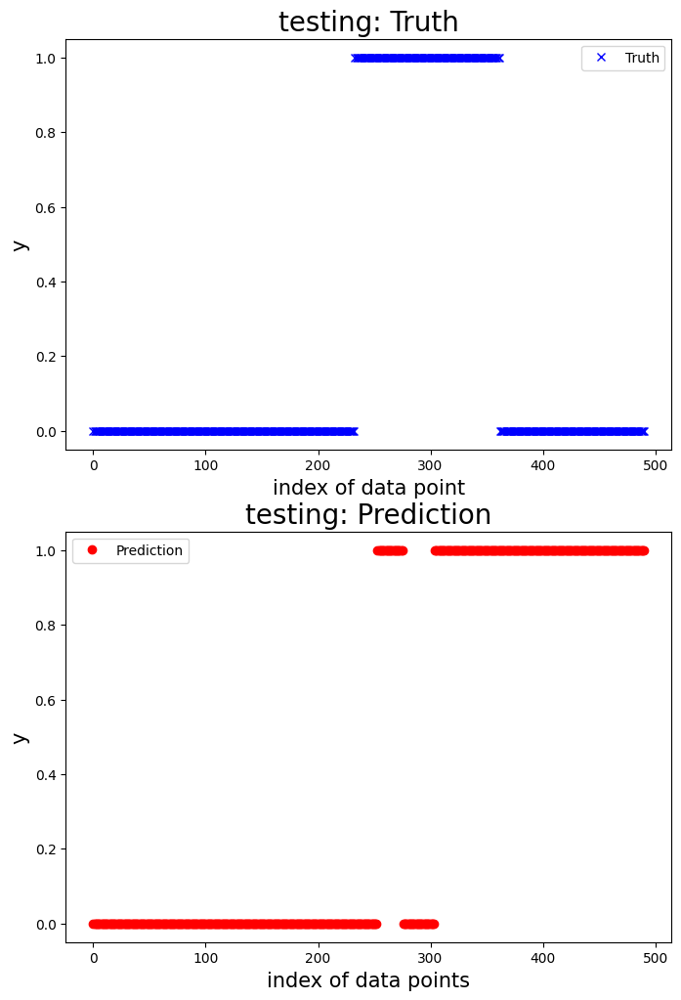

100%|██████████| 1/1 [00:01<00:00,  1.02s/it]



 New run:

testing performance, max error is: 3.1236044249052206
testing performance, mean root square error is: 1.7289550194929284
testing performance, residual error > 1.418227383480178: 53.53846153846153%

 New run:

testing performance, accuracy is: 0.3528205128205128
testing performance, precision is: 0.012027491408934709
testing performance, recall: 0.1111111111111111
testing performance, F1: 0.021705426356589147




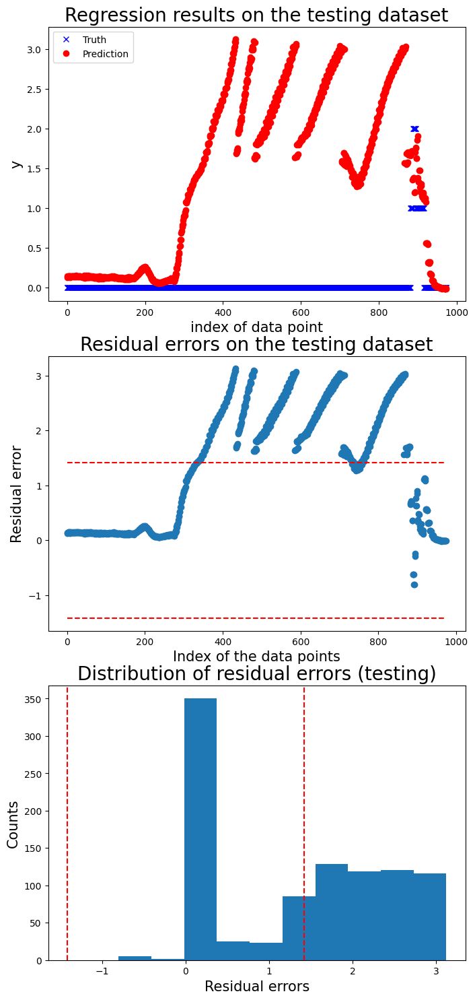

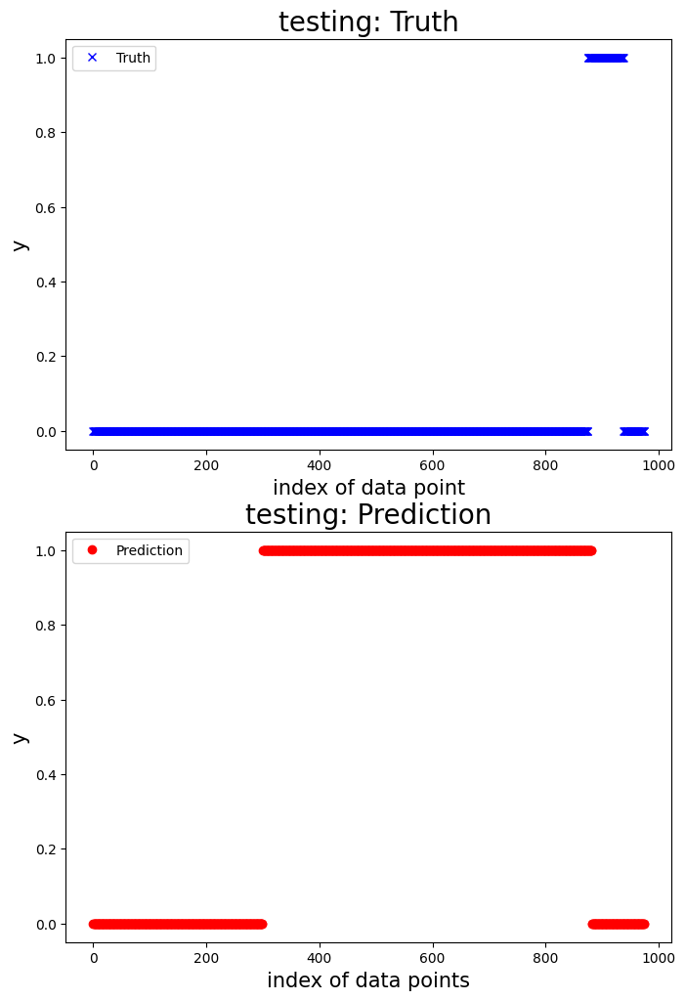

100%|██████████| 1/1 [00:01<00:00,  1.17s/it]



 New run:

testing performance, max error is: 7.338932098277783
testing performance, mean root square error is: 2.5715602158281485
testing performance, residual error > 1.4964478469147755: 43.611111111111114%

 New run:

testing performance, accuracy is: 0.7759259259259259
testing performance, precision is: 0.6114649681528662
testing performance, recall: 0.829971181556196
testing performance, F1: 0.7041564792176039




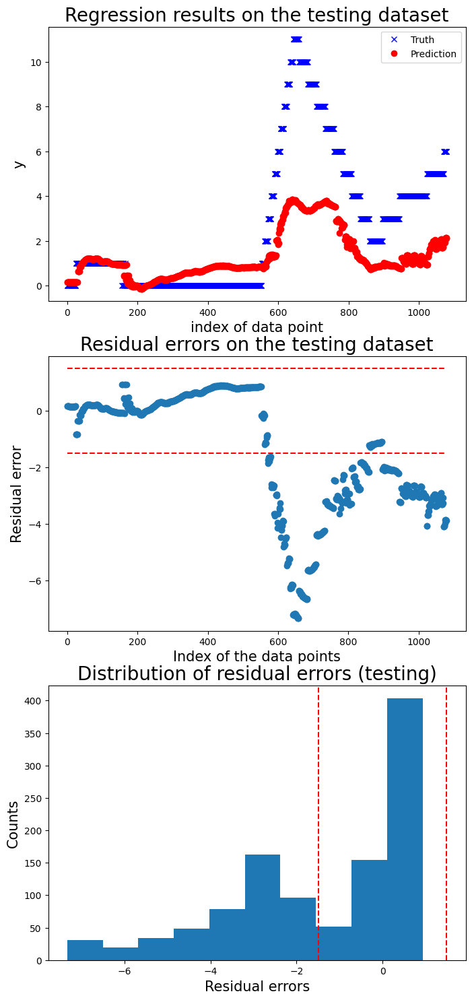

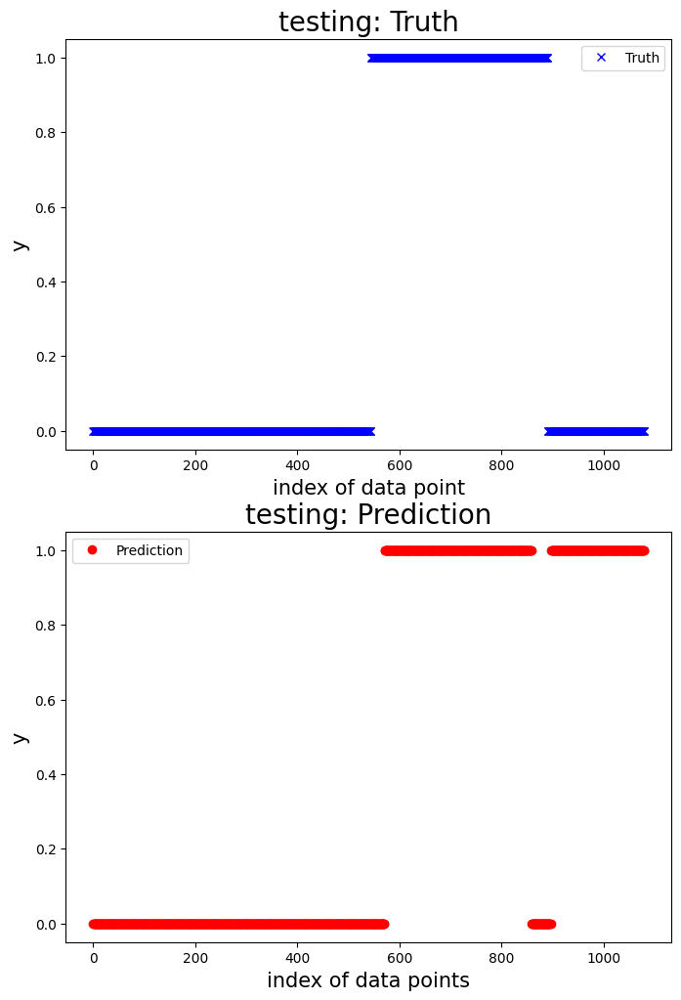

100%|██████████| 1/1 [00:00<00:00,  1.82it/s]



 New run:

testing performance, max error is: 9.767299297159195
testing performance, mean root square error is: 5.3596201666860095
testing performance, residual error > 1.4682214969342513: 83.39622641509435%

 New run:

testing performance, accuracy is: 0.8754716981132076
testing performance, precision is: 0.9683257918552036
testing performance, recall: 0.8916666666666667
testing performance, F1: 0.928416485900217




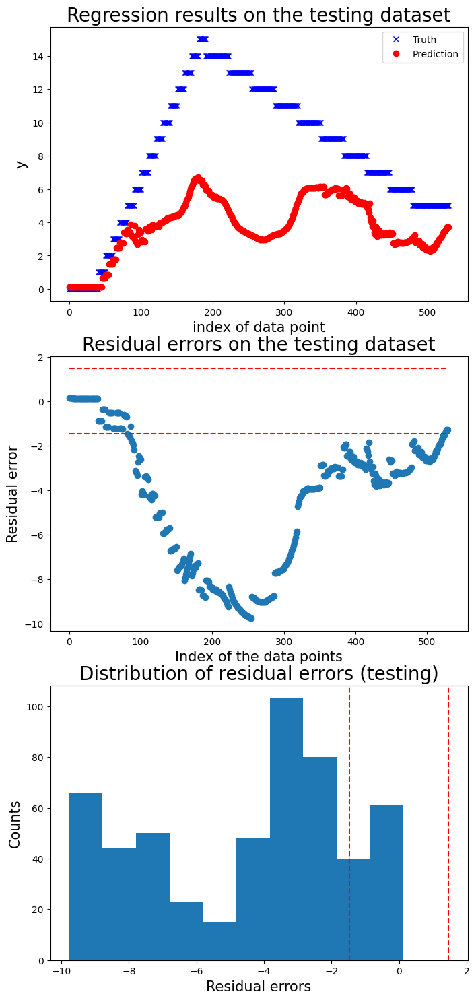

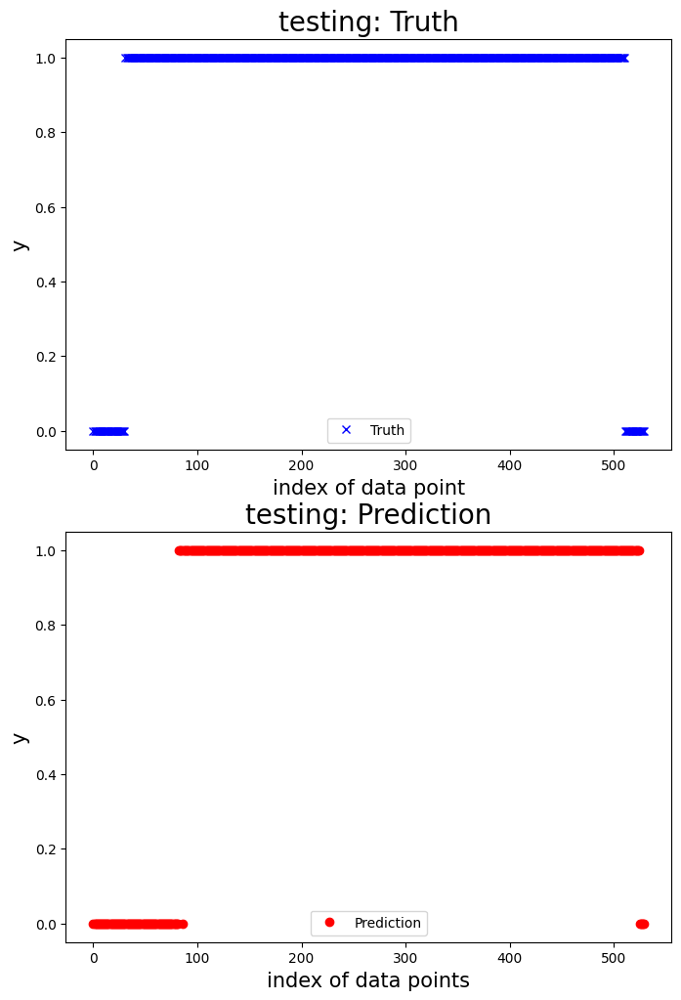

100%|██████████| 1/1 [00:00<00:00,  1.35it/s]



 New run:

testing performance, max error is: 3.0735050481938346
testing performance, mean root square error is: 1.146317039430196
testing performance, residual error > 1.4240803791648962: 22.88135593220339%

 New run:

testing performance, accuracy is: 0.480225988700565
testing performance, precision is: 0.09375
testing performance, recall: 0.08490566037735849
testing performance, F1: 0.0891089108910891




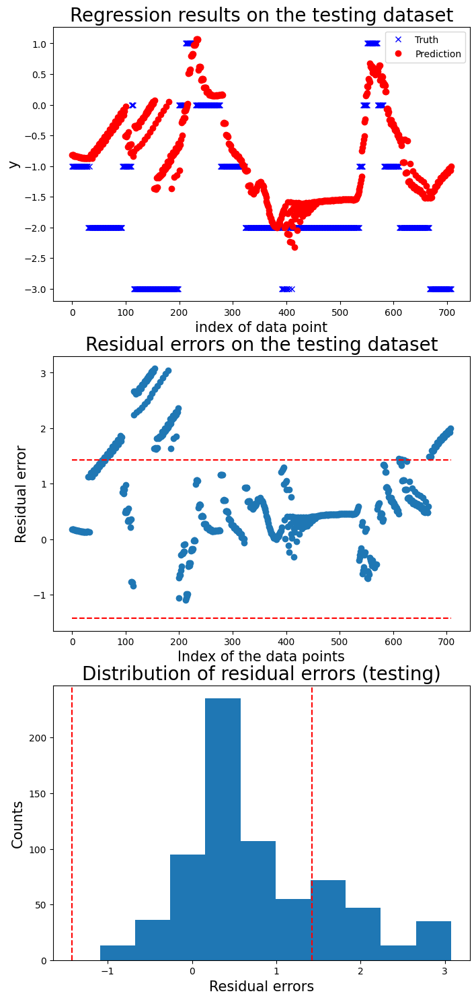

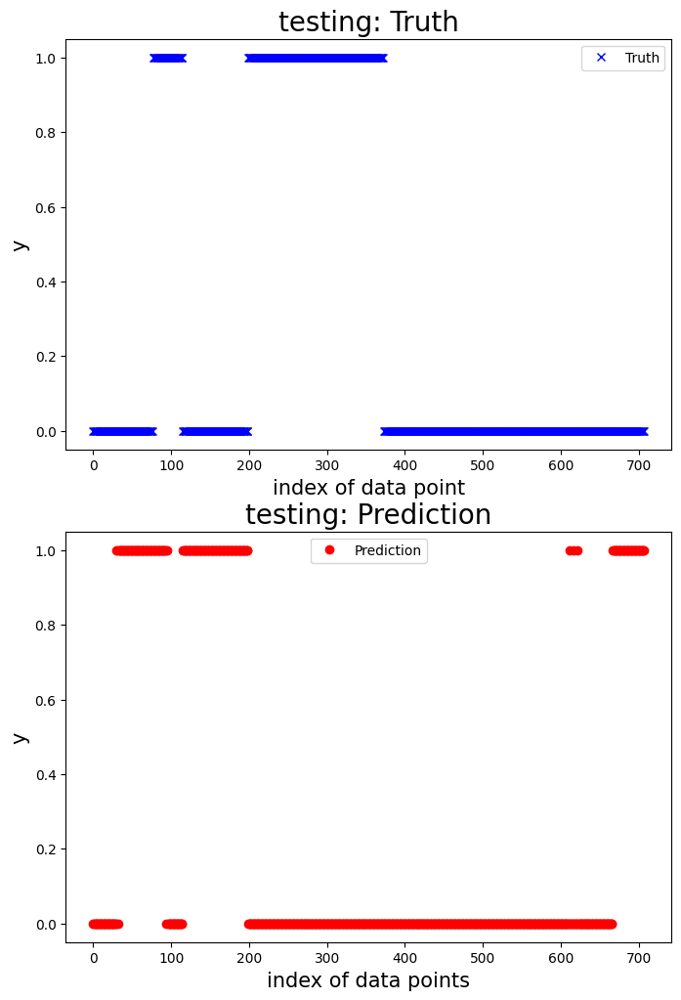

   Accuracy  Precision    Recall  F1 score
0  0.669148   0.169283  0.644588  0.268145
1  0.691358   0.716216  0.646341  0.679487
2  0.639511   0.385714  0.627907  0.477876
3  0.352821   0.012027  0.111111  0.021705
4  0.775926   0.611465  0.829971  0.704156
5  0.875472   0.968326  0.891667  0.928416
6  0.480226   0.093750  0.084906  0.089109


Mean performance metric and standard error:
Accuracy: 0.6406 +- 0.1758
Precision: 0.4224 +- 0.3564
Recall: 0.5481 +- 0.3236
F1 score: 0.4527 +- 0.3400




In [51]:
# Your code here:

from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg
from sklearn.svm import SVR 

# Pre-train the model.
# Get all the normal data.
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213',
    '20240325_152902', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']

df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

df_tr = df_data[df_data['test_condition'].isin(normal_test_id)]

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

# Prepare feature and response of the training dataset.
x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

# Enrich the features based on the sliding window.
window_size = 50
sample_step = 5
prediction_lead_time = 1 
threshold = .9
abnormal_limit = 3

x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=window_size, sample_step=sample_step, prediction_lead_time=prediction_lead_time, mdl_type='reg')

# Test data.
test_id = [
    '20240325_155003',
    '20240425_093699',
    '20240425_094425',
    '20240426_140055',
    '20240503_163963',
    '20240503_164675',
    '20240503_165189'
]
df_test = df_data[df_data['test_condition'].isin(test_id)]


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SVR(C=1.0, epsilon=0.2))    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)
# Fit the model
mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

# Define the fault detector.
detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=threshold, abnormal_limit=abnormal_limit, window_size=window_size, sample_step=sample_step, pred_lead_time=prediction_lead_time)

# # Run cross validation
n_fold = 7
_, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='clf')
x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

motor_idx = 6
print(f'Model for motor {motor_idx}:')
# Run cross validation.
df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, 
                                        n_fold=n_fold)
print(df_perf)
print('\n')
# Print the mean performance and standard error.
print('Mean performance metric and standard error:')
for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
    print(f'{name}: {metric:.4f} +- {error:.4f}') 
print('\n')


#### stochastic gradient descent regression

Model for motor 6:


100%|██████████| 1/1 [00:03<00:00,  3.95s/it]



 New run:

testing performance, max error is: 4.007068412168708
testing performance, mean root square error is: 1.893008248172896
testing performance, residual error > 0.9: 64.71387588706024%

 New run:

testing performance, accuracy is: 0.34244300166087877
testing performance, precision is: 0.06416238917405506
testing performance, recall: 0.44426494345718903
testing performance, F1: 0.11213047910295616




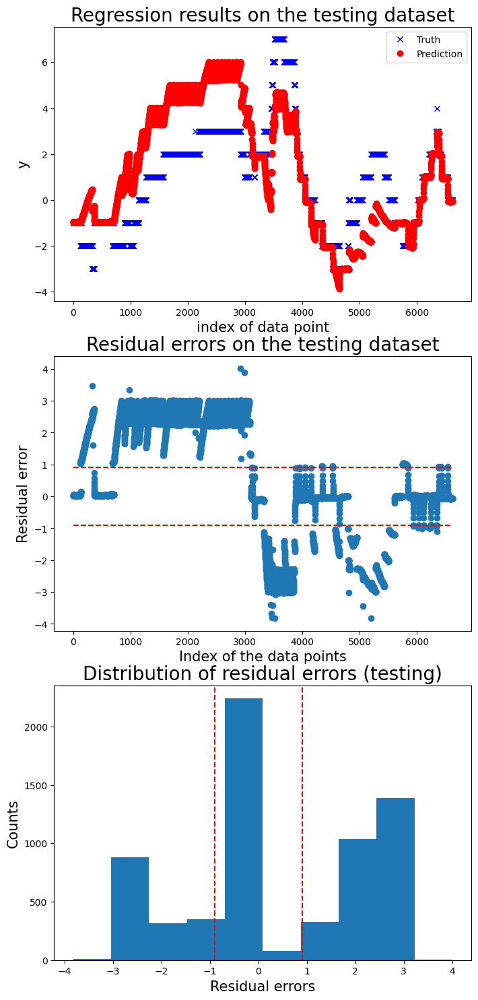

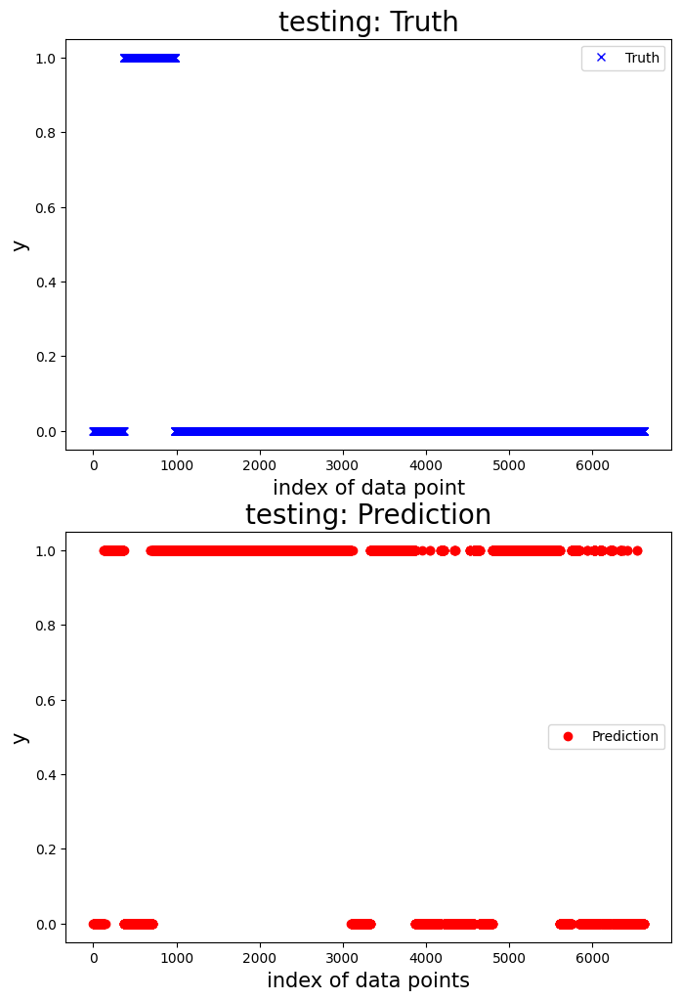

100%|██████████| 1/1 [00:00<00:00,  7.57it/s]



 New run:

testing performance, max error is: 3.9815823128993344
testing performance, mean root square error is: 1.7901231482264117
testing performance, residual error > 0.9: 47.02970297029702%

 New run:

testing performance, accuracy is: 0.8564356435643564
testing performance, precision is: 0.7789473684210526
testing performance, recall: 0.9024390243902439
testing performance, F1: 0.8361581920903954




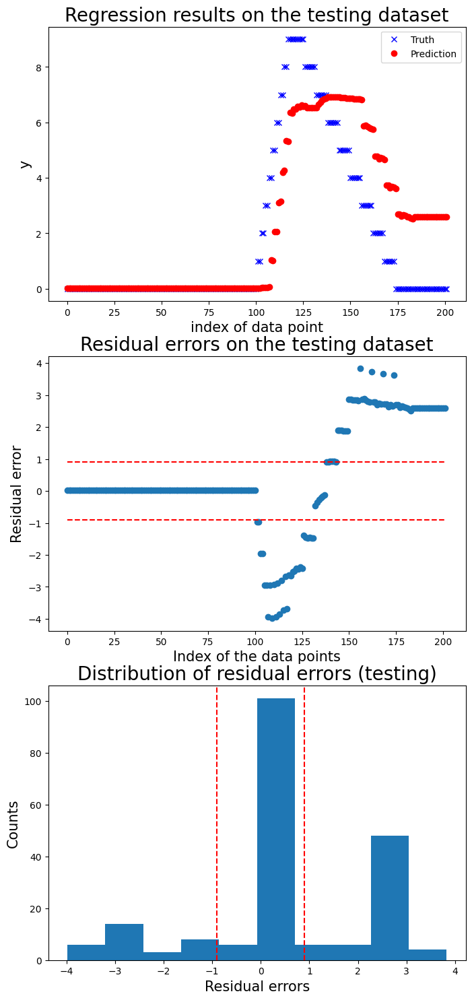

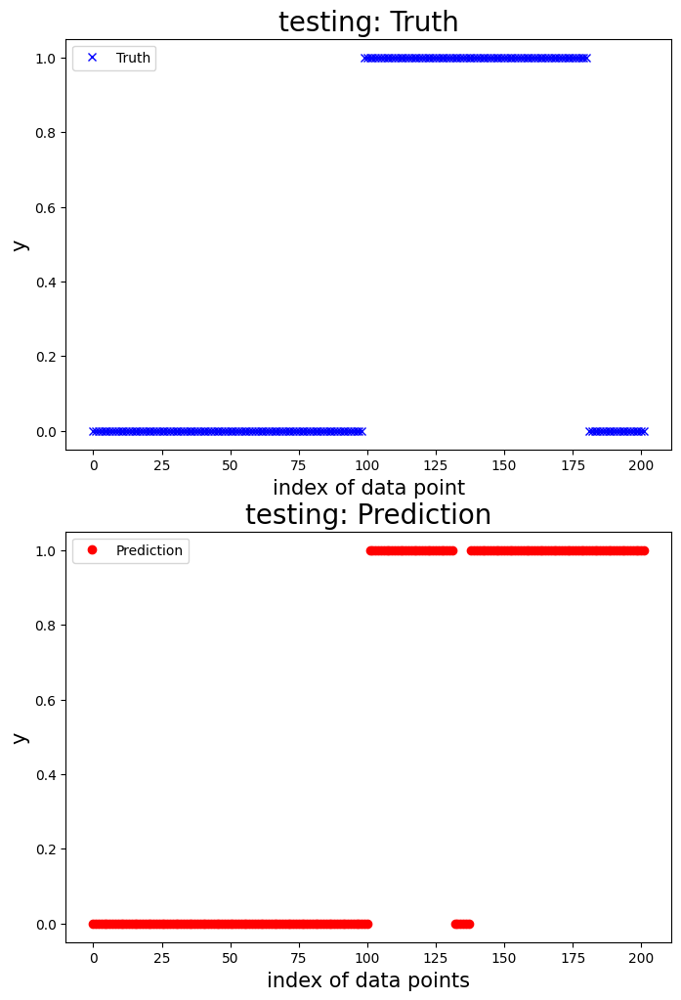

100%|██████████| 1/1 [00:00<00:00,  3.38it/s]



 New run:

testing performance, max error is: 2.8757266553204284
testing performance, mean root square error is: 0.9527035536374794
testing performance, residual error > 0.9: 41.431261770244824%

 New run:

testing performance, accuracy is: 0.6854990583804144
testing performance, precision is: 0.41363636363636364
testing performance, recall: 0.7054263565891473
testing performance, F1: 0.5214899713467048




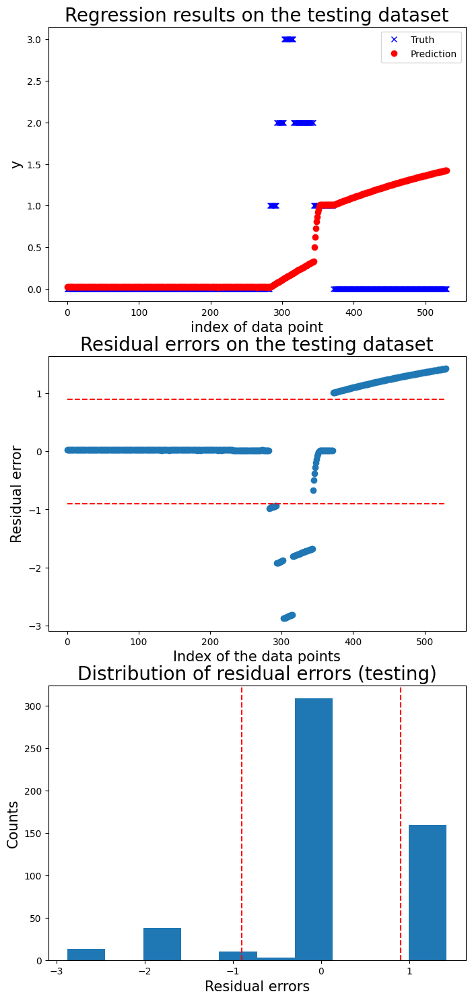

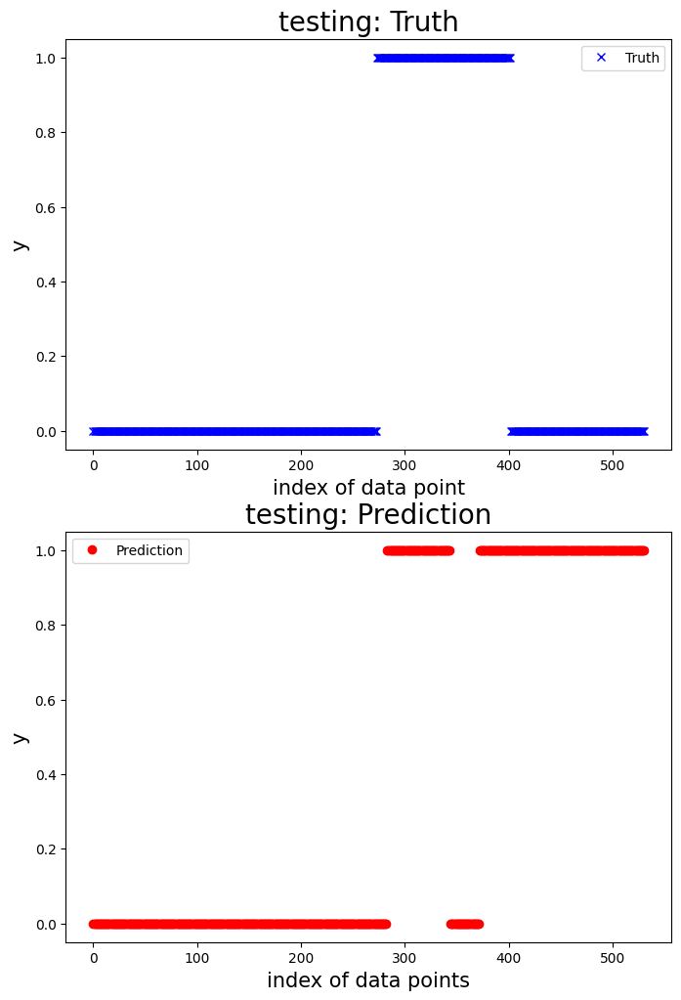

100%|██████████| 1/1 [00:00<00:00,  1.68it/s]



 New run:

testing performance, max error is: 1.9699940429839709
testing performance, mean root square error is: 0.22637655536261625
testing performance, residual error > 0.9: 3.152709359605911%

 New run:

testing performance, accuracy is: 0.9694581280788177
testing performance, precision is: 1.0
testing performance, recall: 0.5079365079365079
testing performance, F1: 0.6736842105263158




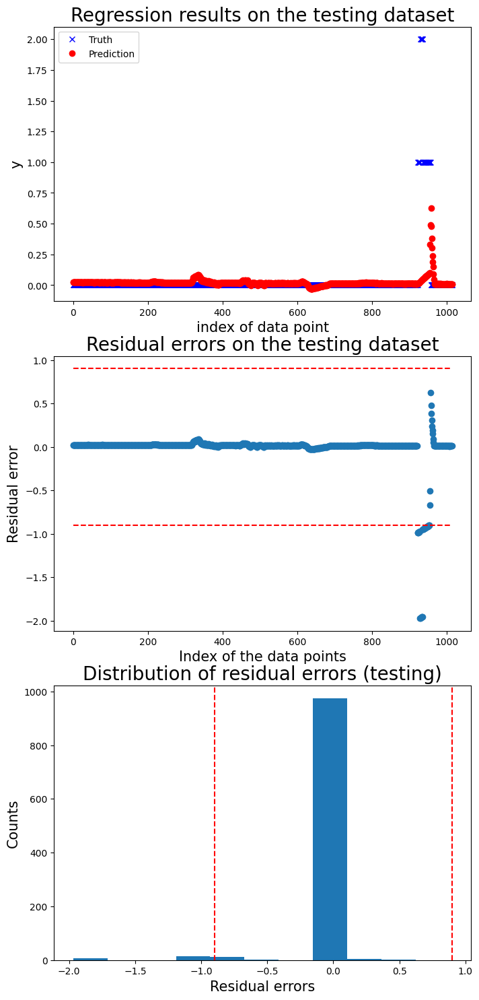

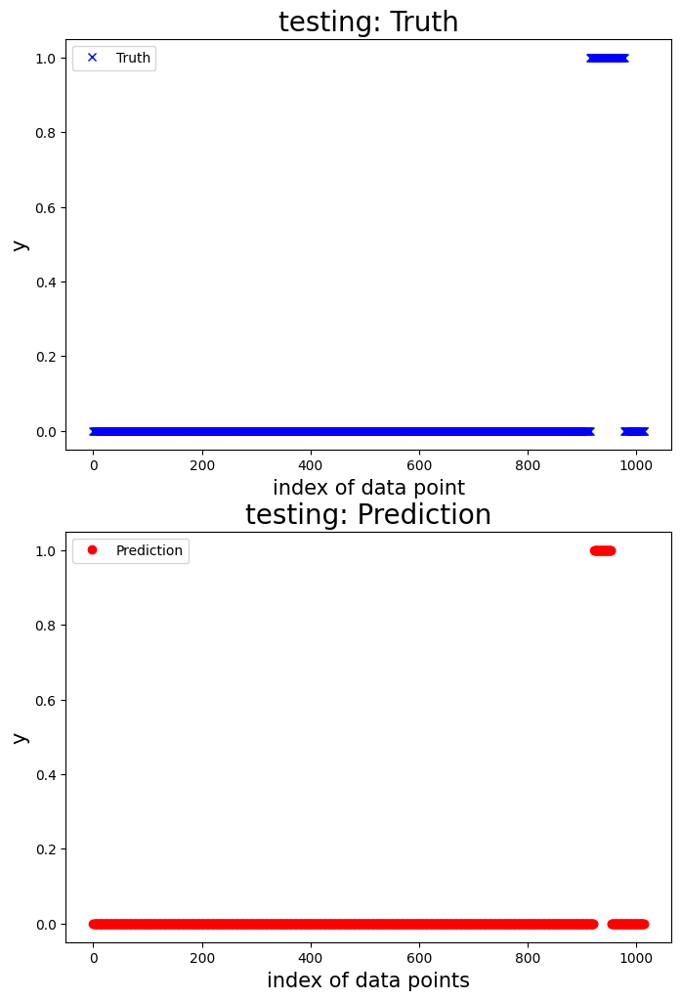

100%|██████████| 1/1 [00:00<00:00,  1.41it/s]



 New run:

testing performance, max error is: 3.0105384779818354
testing performance, mean root square error is: 1.28725680307309
testing performance, residual error > 1.4890921601555054: 27.589285714285715%

 New run:

testing performance, accuracy is: 0.3455357142857143
testing performance, precision is: 0.04481132075471698
testing performance, recall: 0.05475504322766571
testing performance, F1: 0.04928664072632944




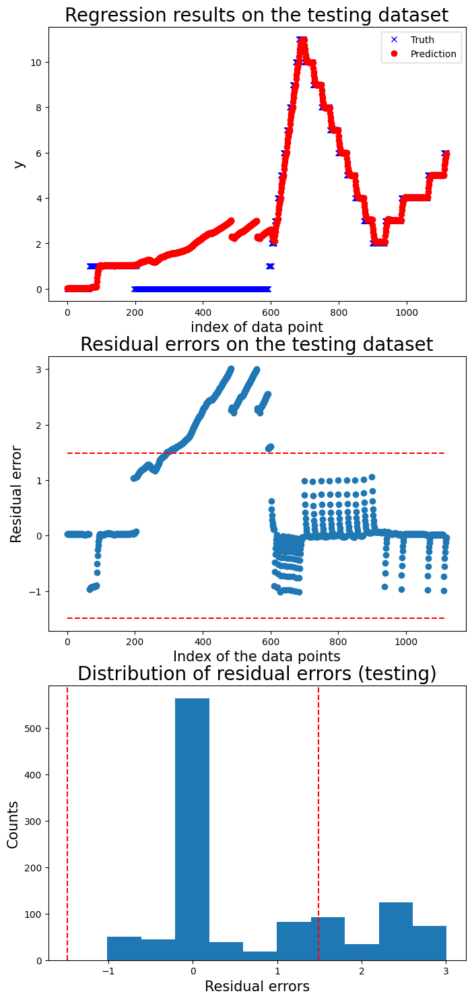

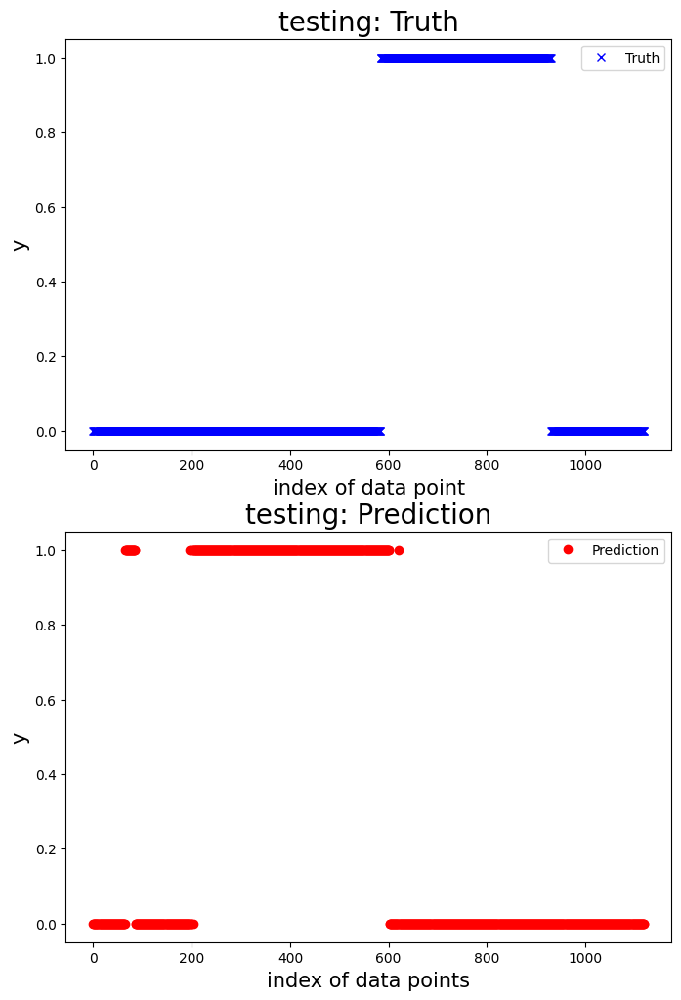

100%|██████████| 1/1 [00:00<00:00,  3.21it/s]



 New run:

testing performance, max error is: 4.001976681893655
testing performance, mean root square error is: 1.3295065271370794
testing performance, residual error > 1.3956019792992327: 24.561403508771928%

 New run:

testing performance, accuracy is: 0.4649122807017544
testing performance, precision is: 1.0
testing performance, recall: 0.3645833333333333
testing performance, F1: 0.5343511450381679




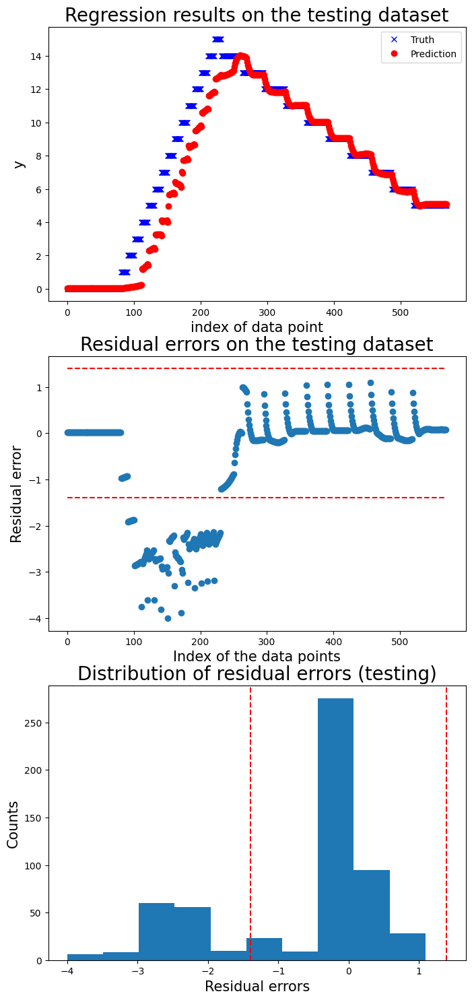

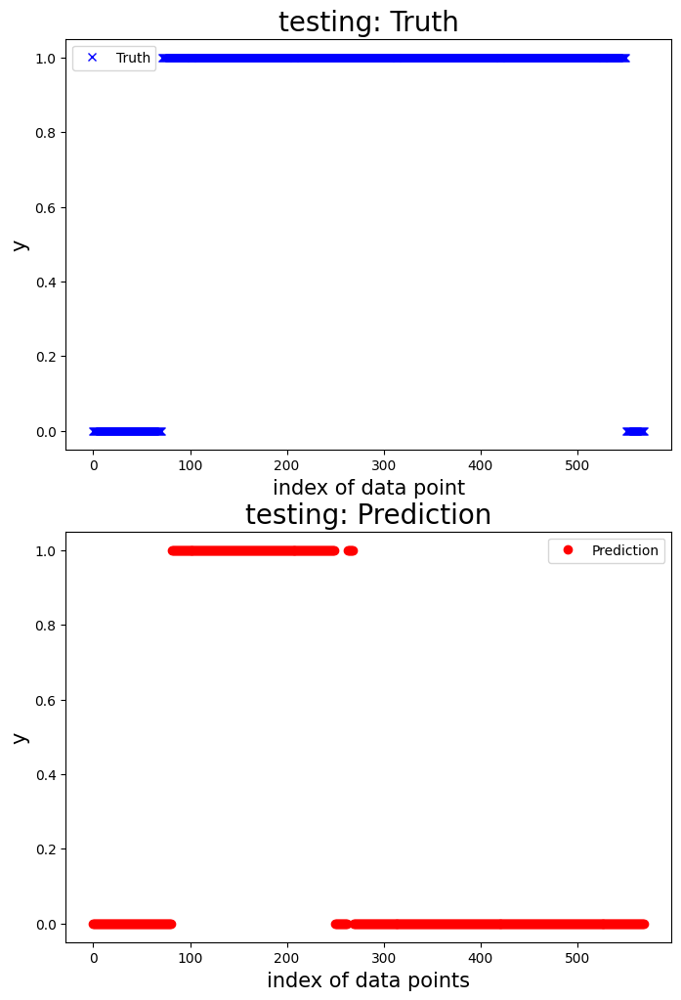

100%|██████████| 1/1 [00:00<00:00,  2.37it/s]



 New run:

testing performance, max error is: 3.2562960917849657
testing performance, mean root square error is: 1.2327825697148287
testing performance, residual error > 1.499893586338208: 21.92513368983957%

 New run:

testing performance, accuracy is: 0.5120320855614974
testing performance, precision is: 0.15384615384615385
testing performance, recall: 0.16037735849056603
testing performance, F1: 0.15704387990762125




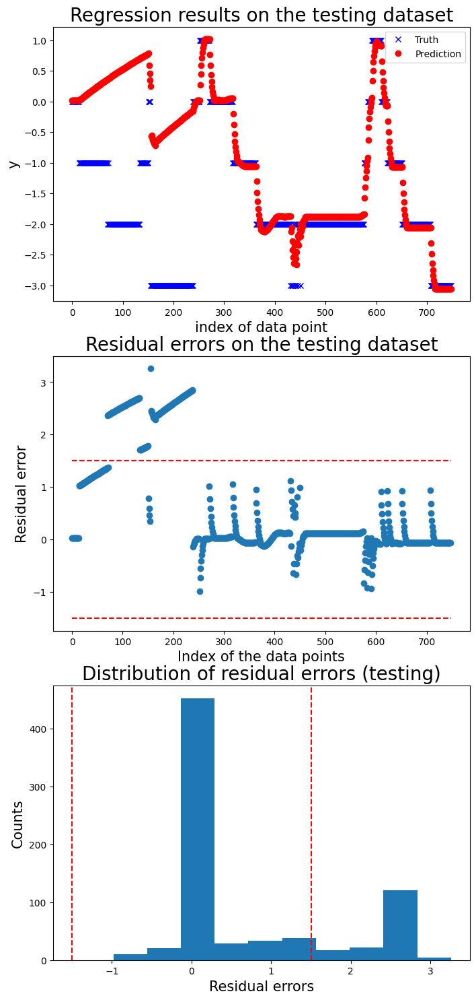

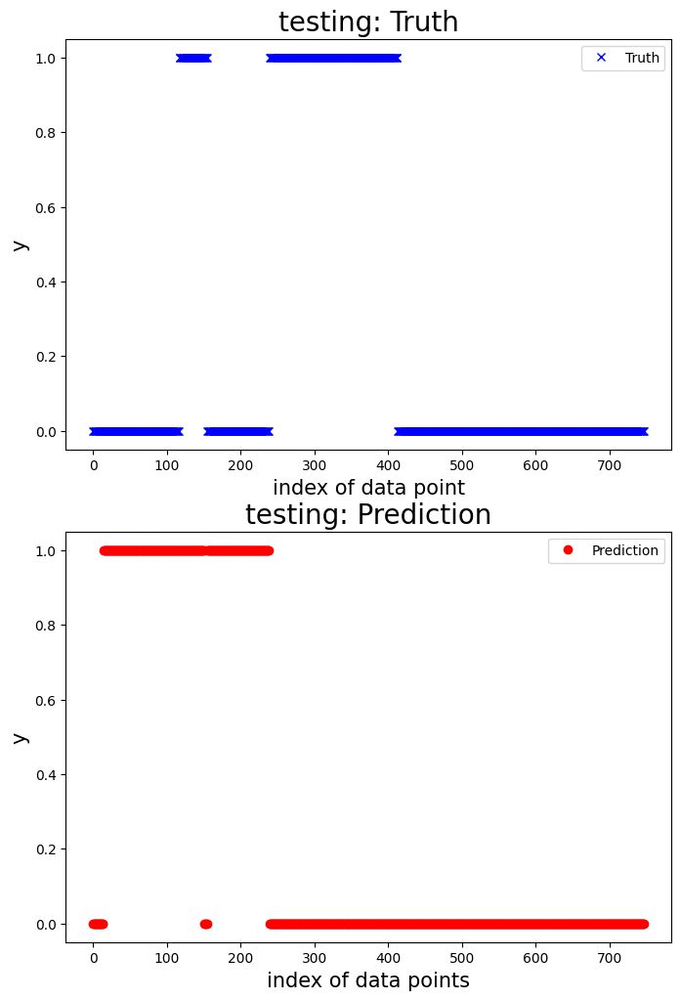

   Accuracy  Precision    Recall  F1 score
0  0.342443   0.064162  0.444265  0.112130
1  0.856436   0.778947  0.902439  0.836158
2  0.685499   0.413636  0.705426  0.521490
3  0.969458   1.000000  0.507937  0.673684
4  0.345536   0.044811  0.054755  0.049287
5  0.464912   1.000000  0.364583  0.534351
6  0.512032   0.153846  0.160377  0.157044


Mean performance metric and standard error:
Accuracy: 0.5966 +- 0.2472
Precision: 0.4936 +- 0.4286
Recall: 0.4485 +- 0.2946
F1 score: 0.4120 +- 0.3060




In [50]:
# Your code here:

from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg
from sklearn.linear_model import SGDRegressor 

# Pre-train the model.
# Get all the normal data.
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213',
    '20240325_152902', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']

df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

df_tr = df_data[df_data['test_condition'].isin(normal_test_id)]

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

# Prepare feature and response of the training dataset.
x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

# Enrich the features based on the sliding window.
window_size = 10
sample_step = 1
prediction_lead_time = 1 
threshold = .9
abnormal_limit = 3

x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=window_size, sample_step=sample_step, prediction_lead_time=prediction_lead_time, mdl_type='reg')

# Test data.
test_id = [
    '20240325_155003',
    '20240425_093699',
    '20240425_094425',
    '20240426_140055',
    '20240503_163963',
    '20240503_164675',
    '20240503_165189'
]
df_test = df_data[df_data['test_condition'].isin(test_id)]


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SGDRegressor(max_iter=1000, tol=1e-3, alpha=0.0001))    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)
# Fit the model
mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

# Define the fault detector.
detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=threshold, abnormal_limit=abnormal_limit, window_size=window_size, sample_step=sample_step, pred_lead_time=prediction_lead_time)

# # Run cross validation
n_fold = 7
_, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='clf')
x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

motor_idx = 6
print(f'Model for motor {motor_idx}:')
# Run cross validation.
df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, 
                                        n_fold=n_fold)
print(df_perf)
print('\n')
# Print the mean performance and standard error.
print('Mean performance metric and standard error:')
for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
    print(f'{name}: {metric:.4f} +- {error:.4f}') 
print('\n')


Model for motor 6:


100%|██████████| 1/1 [00:04<00:00,  4.71s/it]



 New run:

testing performance, max error is: 3.0888298275961454
testing performance, mean root square error is: 0.6455758000973721
testing performance, residual error > 1.4999897621951306: 7.777608992860398%

 New run:

testing performance, accuracy is: 0.9138690566610967
testing performance, precision is: 0.5426229508196722
testing performance, recall: 0.5347334410339257
testing performance, F1: 0.5386493083807974




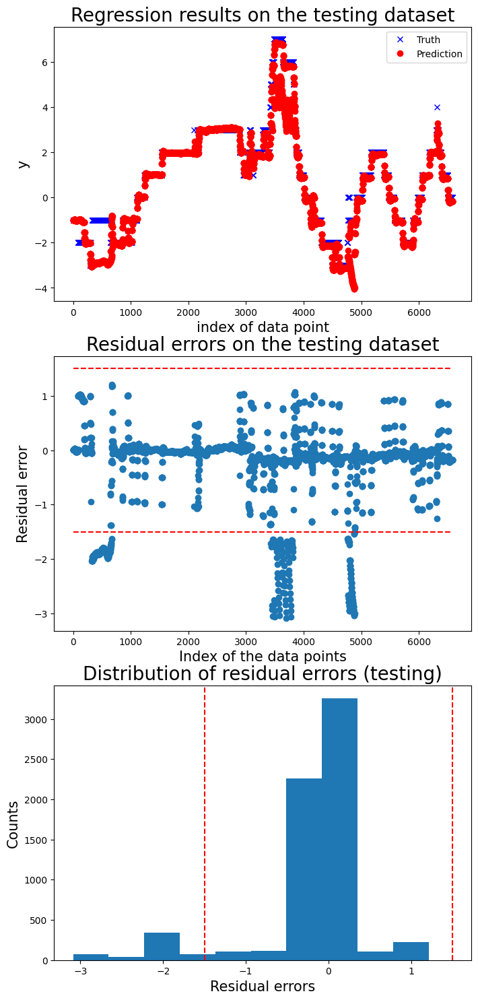

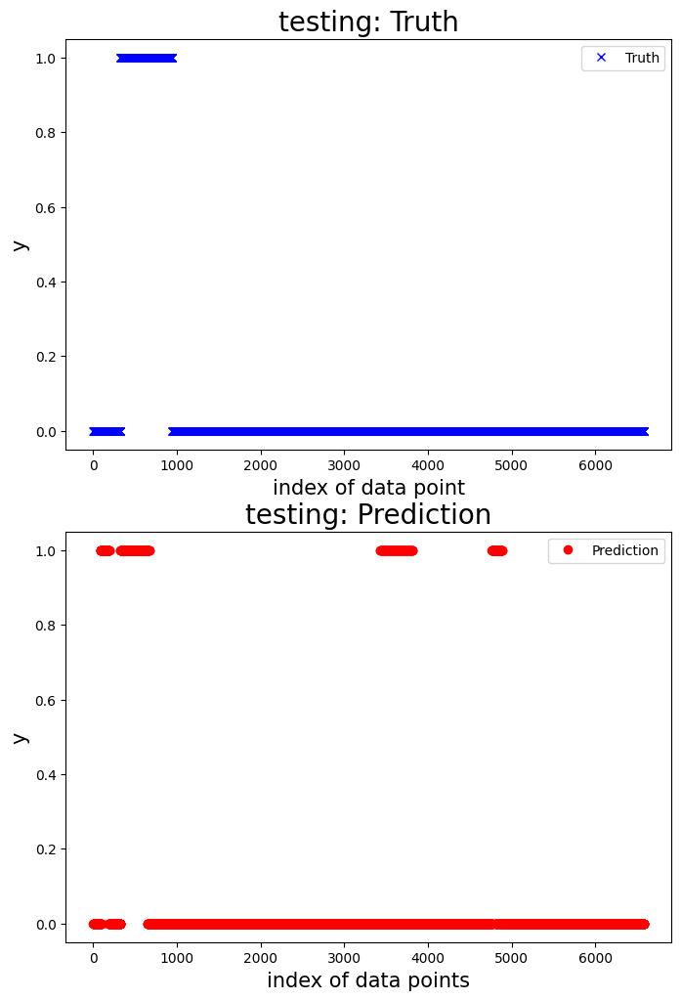

100%|██████████| 1/1 [00:00<00:00, 10.34it/s]



 New run:

testing performance, max error is: 5.0257919737278876
testing performance, mean root square error is: 2.1436859800862416
testing performance, residual error > 0.9173709042536894: 58.0246913580247%

 New run:

testing performance, accuracy is: 0.8333333333333334
testing performance, precision is: 0.7894736842105263
testing performance, recall: 0.9146341463414634
testing performance, F1: 0.847457627118644




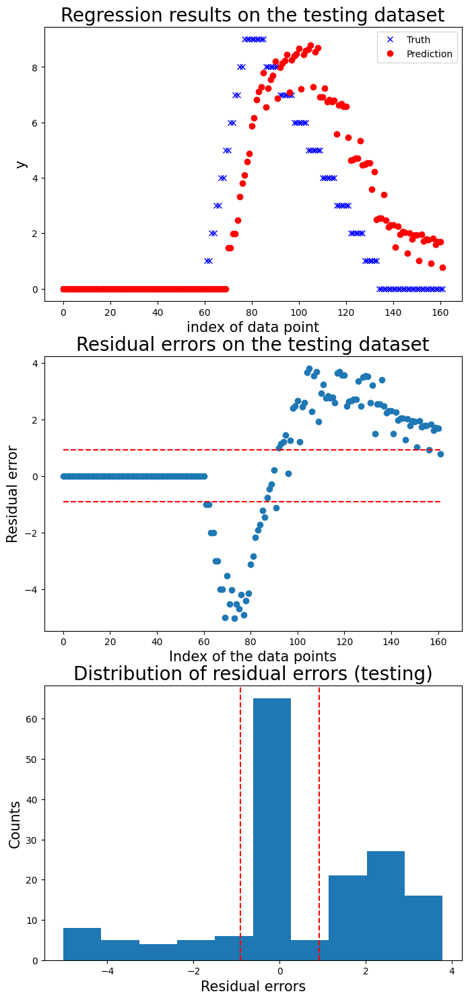

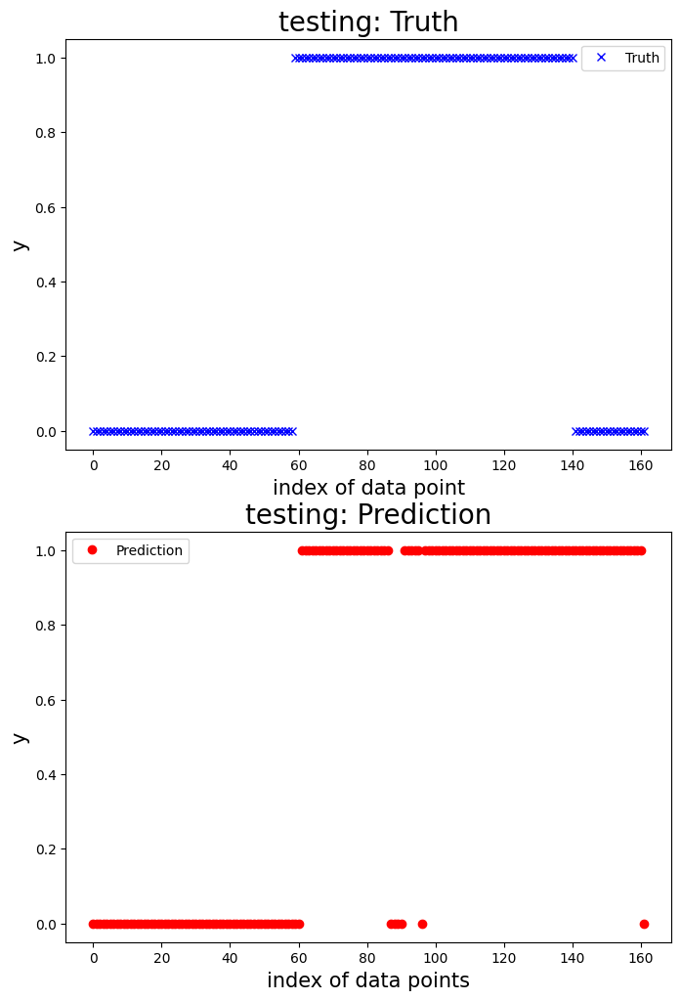

100%|██████████| 1/1 [00:00<00:00,  3.53it/s]



 New run:

testing performance, max error is: 3.0229223920389594
testing performance, mean root square error is: 1.1336968439363757
testing performance, residual error > 0.9: 44.806517311608964%

 New run:

testing performance, accuracy is: 0.659877800407332
testing performance, precision is: 0.41363636363636364
testing performance, recall: 0.7054263565891473
testing performance, F1: 0.5214899713467048




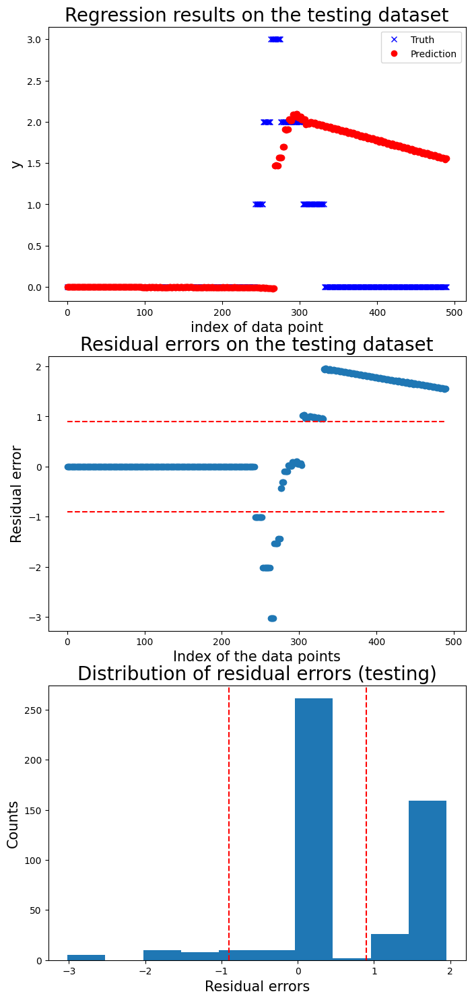

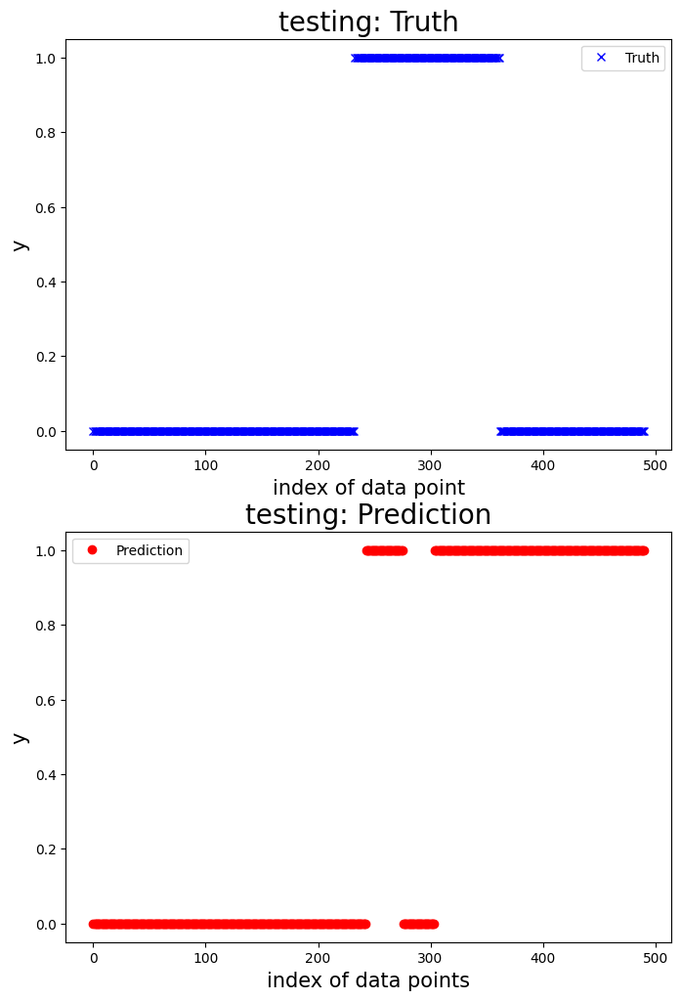

100%|██████████| 1/1 [00:00<00:00,  1.84it/s]



 New run:

testing performance, max error is: 2.0262507970859014
testing performance, mean root square error is: 0.24971854612467062
testing performance, residual error > 0.9: 3.5897435897435894%

 New run:

testing performance, accuracy is: 0.9712820512820513
testing performance, precision is: 1.0
testing performance, recall: 0.5555555555555556
testing performance, F1: 0.7142857142857143




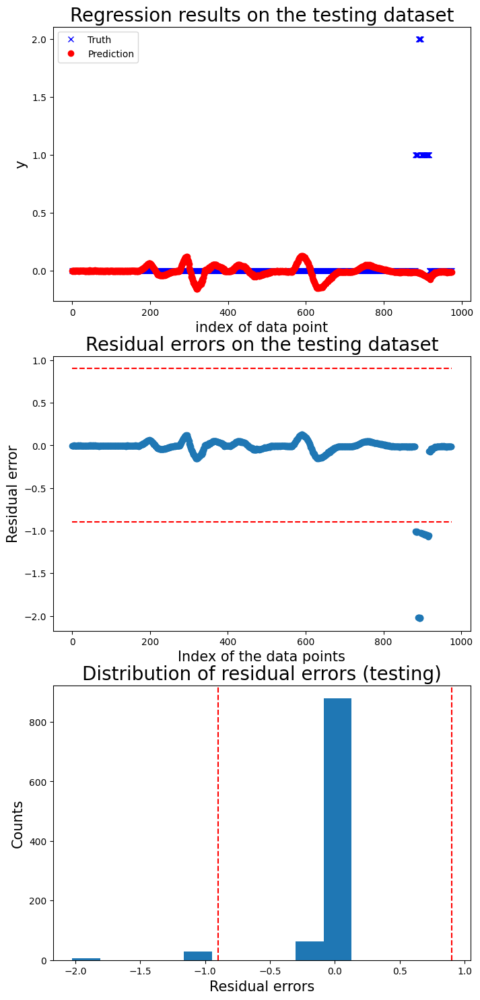

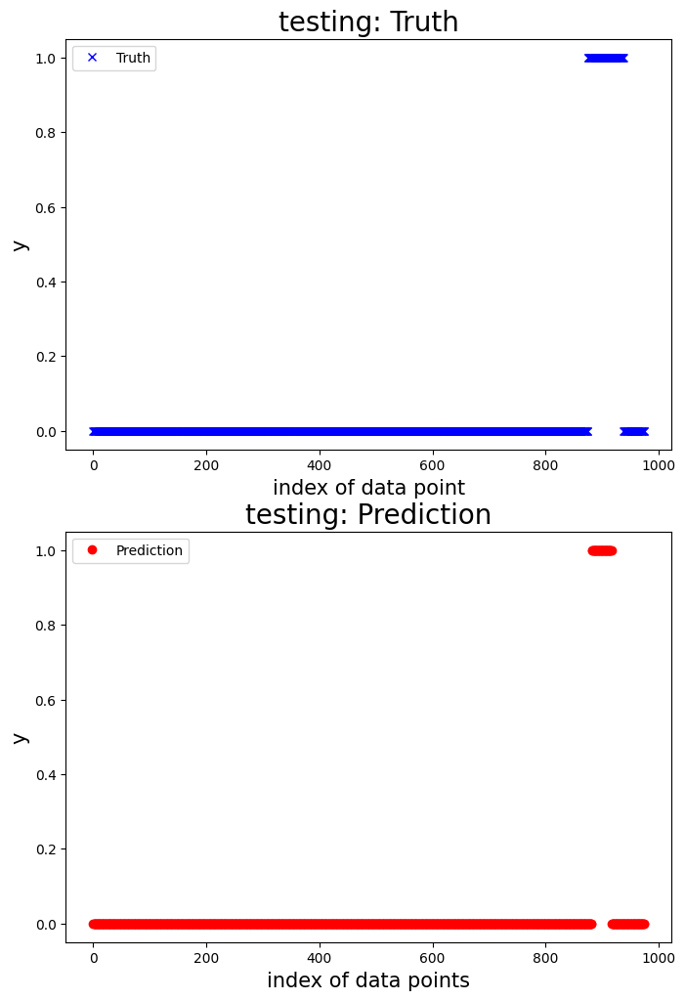

100%|██████████| 1/1 [00:00<00:00,  1.44it/s]



 New run:

testing performance, max error is: 1.4708536116108144
testing performance, mean root square error is: 0.4666223245914062
testing performance, residual error > 1.4997953607566066: 0.0%

 New run:

testing performance, accuracy is: 0.6222222222222222
testing performance, precision is: 0.0
testing performance, recall: 0.0
testing performance, F1: 0.0




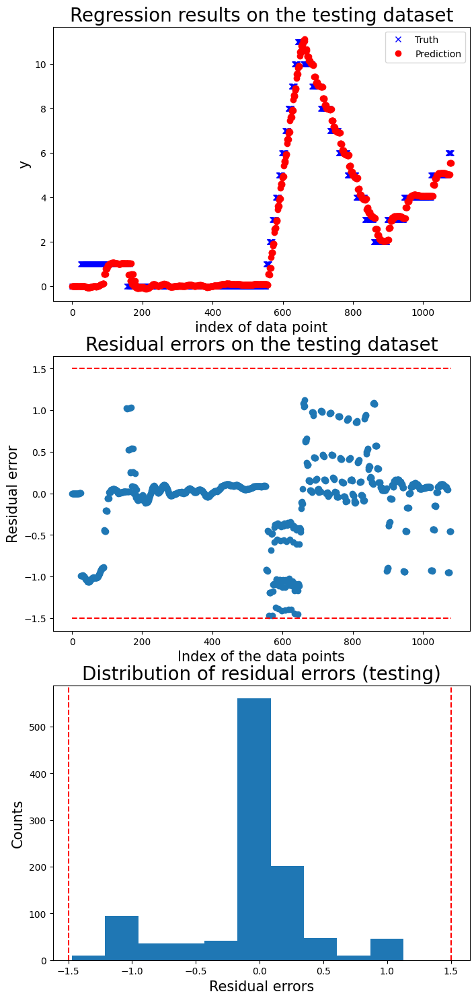

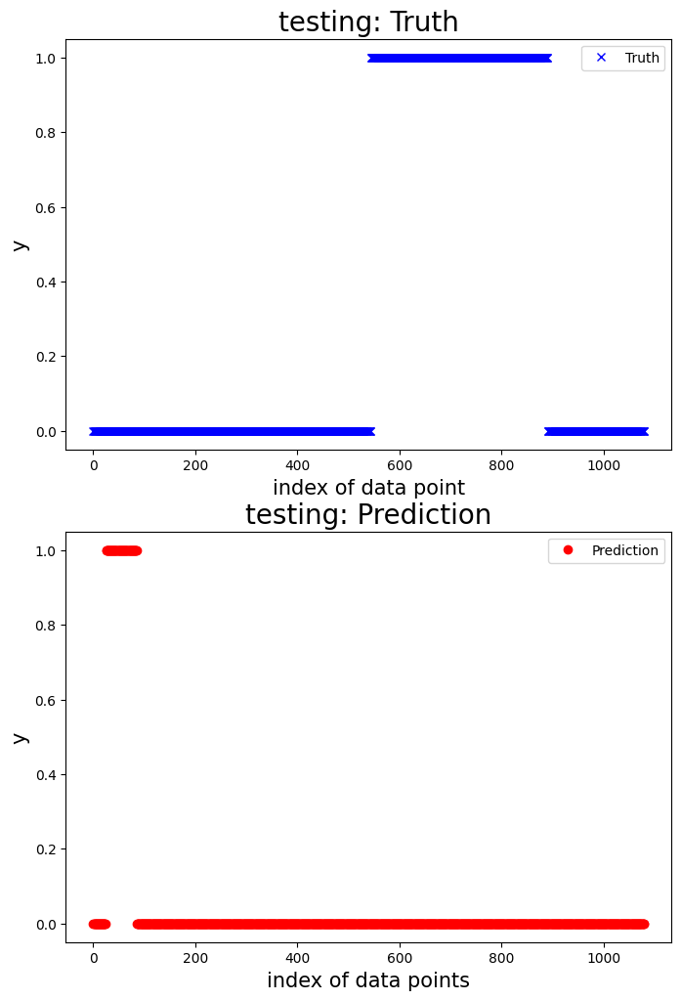

100%|██████████| 1/1 [00:00<00:00,  3.41it/s]



 New run:

testing performance, max error is: 3.8896479764798855
testing performance, mean root square error is: 1.400486279532667
testing performance, residual error > 1.4836297296116197: 29.245283018867923%

 New run:

testing performance, accuracy is: 0.4377358490566038
testing performance, precision is: 1.0
testing performance, recall: 0.37916666666666665
testing performance, F1: 0.5498489425981873




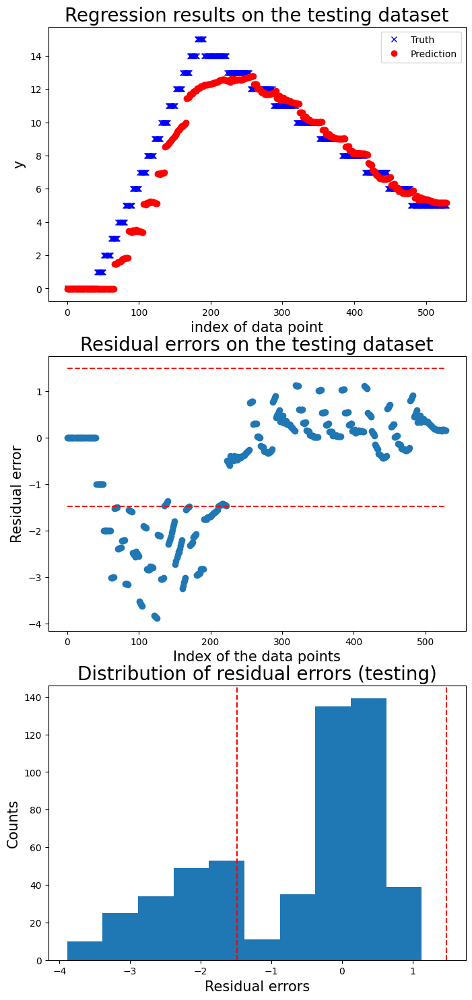

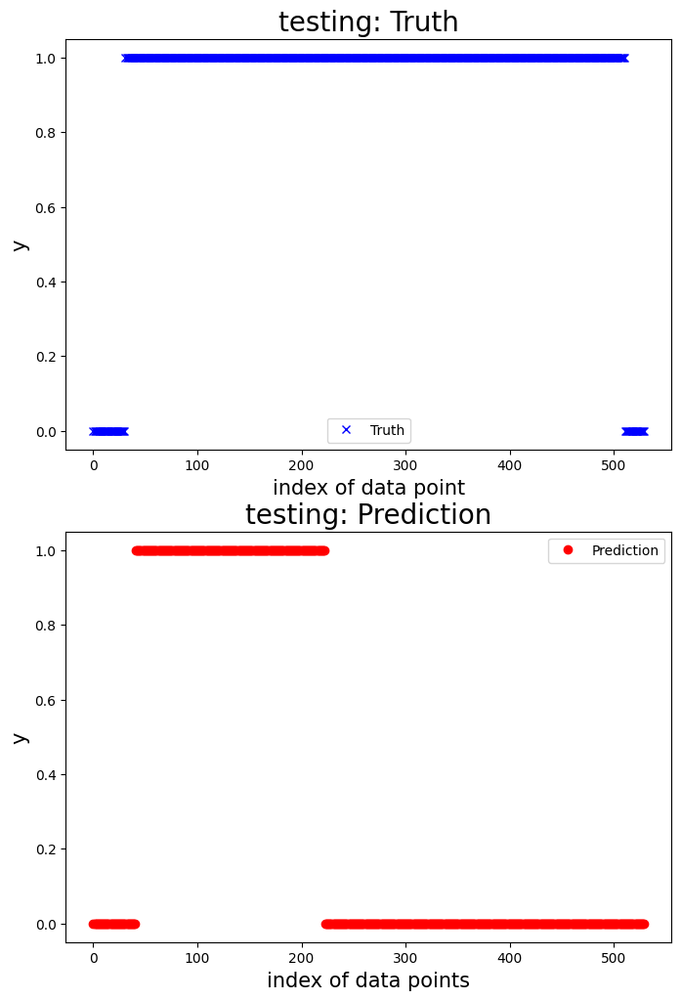

100%|██████████| 1/1 [00:00<00:00,  2.53it/s]



 New run:

testing performance, max error is: 2.1152821026409825
testing performance, mean root square error is: 0.85948787990679
testing performance, residual error > 1.466543025730391: 12.429378531073446%

 New run:

testing performance, accuracy is: 0.5409604519774012
testing performance, precision is: 0.13548387096774195
testing performance, recall: 0.09905660377358491
testing performance, F1: 0.11444141689373297




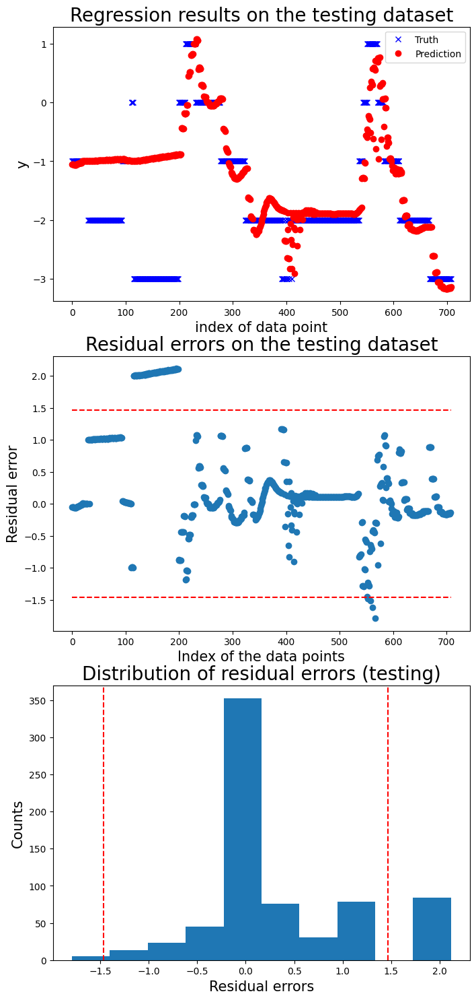

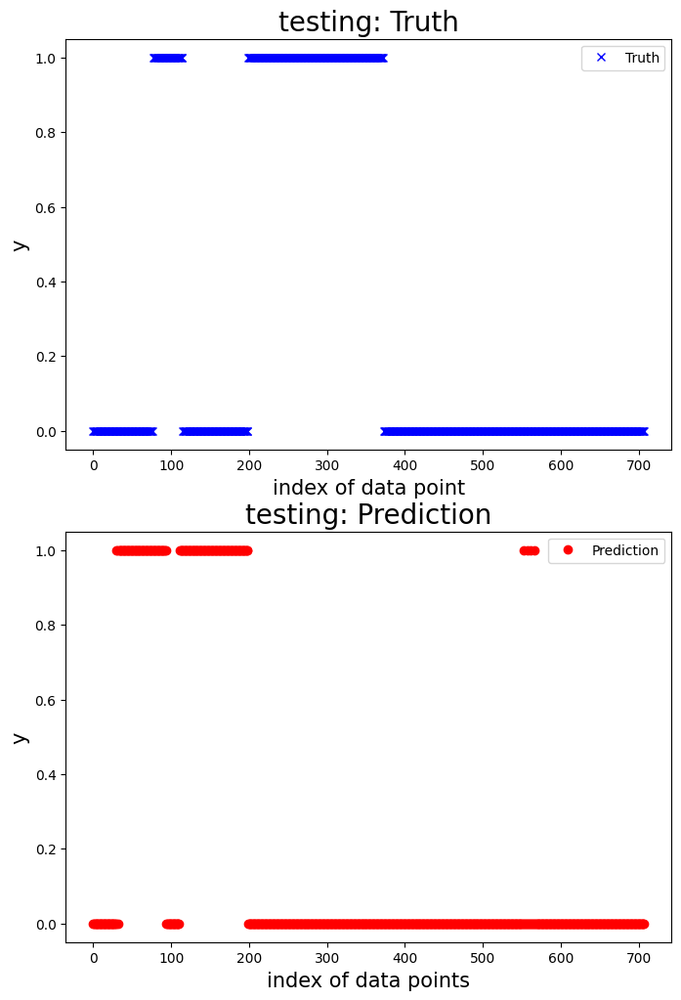

   Accuracy  Precision    Recall  F1 score
0  0.913869   0.542623  0.534733  0.538649
1  0.833333   0.789474  0.914634  0.847458
2  0.659878   0.413636  0.705426  0.521490
3  0.971282   1.000000  0.555556  0.714286
4  0.622222   0.000000  0.000000  0.000000
5  0.437736   1.000000  0.379167  0.549849
6  0.540960   0.135484  0.099057  0.114441


Mean performance metric and standard error:
Accuracy: 0.7113 +- 0.1991
Precision: 0.5545 +- 0.3990
Recall: 0.4555 +- 0.3240
F1 score: 0.4695 +- 0.3064




In [52]:
# Your code here:

from sklearn.linear_model import LinearRegression
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg
from sklearn.linear_model import SGDRegressor 

# Pre-train the model.
# Get all the normal data.
normal_test_id = ['20240105_164214', 
    '20240105_165300', 
    '20240105_165972', 
    '20240320_152031', 
    '20240320_153841', 
    '20240320_155664', 
    '20240321_122650', 
    '20240325_135213',
    '20240325_152902', 
    '20240426_141190', 
    '20240426_141532', 
    '20240426_141602', 
    '20240426_141726', 
    '20240426_141938', 
    '20240426_141980', 
    '20240503_164435']

df_data = read_all_test_data_from_path(base_dictionary, pre_processing, is_plot=False)

df_tr = df_data[df_data['test_condition'].isin(normal_test_id)]

feature_list_selected = ['time', 'data_motor_1_position', 'data_motor_1_temperature', 
                    'data_motor_2_position', 'data_motor_2_temperature', 
                    'data_motor_3_position', 'data_motor_3_temperature', 
                    'data_motor_4_position', 'data_motor_4_temperature', 
                    'data_motor_5_position', 'data_motor_5_temperature', 
                    'data_motor_6_position', 'data_motor_6_temperature']

# Prepare feature and response of the training dataset.
x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

# Enrich the features based on the sliding window.
window_size = 50
sample_step = 5
prediction_lead_time = 1 
threshold = .9
abnormal_limit = 3

x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=window_size, sample_step=sample_step, prediction_lead_time=prediction_lead_time, mdl_type='reg')

# Test data.
test_id = [
    '20240325_155003',
    '20240425_093699',
    '20240425_094425',
    '20240426_140055',
    '20240503_163963',
    '20240503_164675',
    '20240503_165189'
]
df_test = df_data[df_data['test_condition'].isin(test_id)]


# Define the steps of the pipeline
steps = [
    ('standardizer', StandardScaler()),  # Step 1: StandardScaler
    ('regressor', SGDRegressor(max_iter=1000, tol=1e-3, alpha=0.0001))    # Step 2: Linear Regression
]

# Create the pipeline
mdl_linear_regreession = Pipeline(steps)
# Fit the model
mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

# Define the fault detector.
detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=threshold, abnormal_limit=abnormal_limit, window_size=window_size, sample_step=sample_step, pred_lead_time=prediction_lead_time)

# # Run cross validation
n_fold = 7
_, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='clf')
x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=feature_list_selected, motor_idx=6, mdl_type='reg')

motor_idx = 6
print(f'Model for motor {motor_idx}:')
# Run cross validation.
df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, 
                                        n_fold=n_fold)
print(df_perf)
print('\n')
# Print the mean performance and standard error.
print('Mean performance metric and standard error:')
for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
    print(f'{name}: {metric:.4f} +- {error:.4f}') 
print('\n')


## Summary of the results

Please add a table in the end, summarying the results from all the models (including the unsupervised learning models). Please write a few texts to explain what is the best model you got (including key parameters like threshold, window_size, sample_step, prediction_lead_time, etc), its performance, and how could you further improve it.

| Model   | Accuracy | Precision | Recall | F1   |
|---------|----------|-----------|--------|------|
| Linear regression |   0.7327 +- 0.1804  |  0.5969 +- 0.3288   |  0.7567 +- 0.1550  |  0.6152 +- 0.2421  |
| Support vector machine regression |  0.6764 +- 0.1892  |  0.4424 +- 0.3420   |  0.7139 +- 0.2881 | 0.5042 +- 0.3259 |
| Stochastic gradient descent regression |  0.7113 +- 0.1991  |  0.5545 +- 0.3990  | 0.4555 +- 0.3240 | 0.4695 +- 0.3064 |
